# Demo 2: a demo based on Haxby fMRI data
Here is a demo based on the publicly available Haxby fMRI datasets. (Reference: Haxby, J. V. (2001). Distributed and Overlapping Representations of Faces and Objects in Ventral Temporal Cortex. Science, 293(5539), 2425–2430.) Nilearn has been used to load this dataset and plot some results in this demo.

In [1]:
# -*- coding: utf-8 -*-

' a demo based on Haxby fMRI data '
# Users can learn how to use Neurora to do research based on fMRI data.

__author__ = 'Zitong Lu'

from nilearn import datasets, plotting
from nilearn.image import index_img, mean_img
import numpy as np
import pandas as pd
import nibabel as nib
from neurora.stuff import get_affine, datamask
from neurora.nps_cal import nps_fmri, nps_fmri_roi
from neurora.rsa_plot import plot_rdm
from neurora.rdm_cal import fmriRDM_roi, fmriRDM
from neurora.corr_cal_by_rdm import fmrirdms_corr
from neurora.nii_save import corr_save_nii

## Section 1: Loading example data
Here, we use Nilearn toolbox for loading data and processing. You can learn this process from Nilearn (http://nilearn.github.io/index.html).

In [2]:
# load Haxby dataset (here, we only use subject2's data for this example)
haxby_dataset = datasets.fetch_haxby()

# load the fMRI data filename & mask data filename
func_filename = haxby_dataset.func[0]
mask_filename = haxby_dataset.mask

# read label information of the experiment
labelinfo = pd.read_csv(haxby_dataset.session_target[0], sep=' ')
labels = labelinfo['labels']

## Section 2: Preprocessing

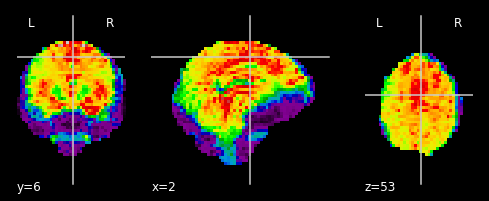

In [3]:
# get mask data NumPy array
maskdata = nib.load(mask_filename).get_fdata()

# get the size of the data
nx, ny, nz = maskdata.shape

# labels of seven ategories
categories = ["face", "cat", "house", "chair", "shoe", "bottle", "scissors"]
# numbe of conidtions: 7
ncon = len(categories)

# get fmri data under 7 conditions
# here we average the data under different conditions
fmri_data = np.full([ncon, nx, ny, nz], np.nan)

for i in range(ncon):
    img = mean_img(index_img(func_filename, labels.isin([categories[i]])))
    fmri_data[i] = datamask(img.get_fdata(), maskdata)

# get fmri data under 'face'-condition
face_img = nib.Nifti1Image(fmri_data[0], affine=img.affine)
# have a look
plotting.plot_epi(face_img)
plotting.show()

# reshaoe the data: [ncon, nx, ny, nz] -> [ncon, nsubs, nx, ny, nz]
# here just one subject's data
fmri_data = np.reshape(fmri_data, [ncon, 1, nx, ny, nz])

## Section 3: Calculating the neural pattern similarity (for ROI)

In [4]:
# get mask of 'mask_face' in the dataset
mask_face_filename = haxby_dataset.mask_face[0]
mask_face_data = nib.load(mask_face_filename).get_fdata()

# get input data under two condition
# here, "face"-condition vs. "scissors"-condition
nps_fmri_data = fmri_data[[0, 6]]

# calculate the neural pattern similarity (NPS) for ROI between two stimulus
nps_roi = nps_fmri_roi(nps_fmri_data, mask_face_data)

# print the NPS result
print(nps_roi)

[[9.99448468e-01 5.88083954e-43]]


## Section 4: Calculating the neural pattern similarity (Searchlight)

(40, 64, 64)
demo2_nps_img.nii
File(demo2_nps_img.nii) saves successfully!


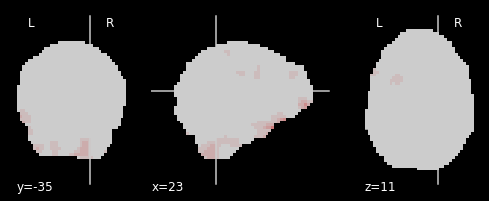

In [5]:
# calculate the neural pattern similarity (NPS) between two stimulus
nps = nps_fmri(nps_fmri_data)

# convert the NPS results into a .nii file
savefilename = "demo2_nps_img"
affine = get_affine(mask_filename)
corr_save_nii(nps[0], filename=savefilename, affine=affine, size=[nx, ny, nz], smooth=False, plotrlt=False)

# have a look
plotting.plot_epi(savefilename+".nii")
plotting.show()

## Section 5: Calculating the RDM for ROI and Plotting

1


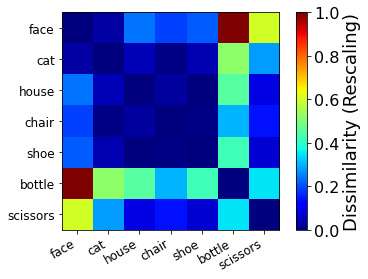

In [6]:
# get mask of "mask_vt" in the dataset
mask_vt_filename = haxby_dataset.mask_face[0]
mask_vt_data = nib.load(mask_vt_filename).get_fdata()

# calculate the RDM for ROI
rdm_roi = fmriRDM_roi(fmri_data, mask_vt_data, abs=False)

# plot the RDM
plot_rdm(rdm_roi, rescale=True, conditions=categories)

## Section 6: Calculating the RDM by Searchlight and Plotting

1


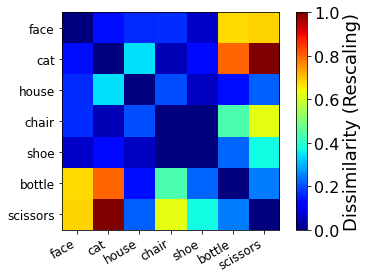

In [7]:
# calculate the RDMs by Searchlight
fmri_RDMs = fmriRDM(fmri_data, sub_opt=0)

# plot one of the RDMs
plot_rdm(fmri_RDMs[20, 30, 30], rescale=True, conditions=categories)

## Section 7: Calculating the representational similarities between a coding model and neural activities 

1


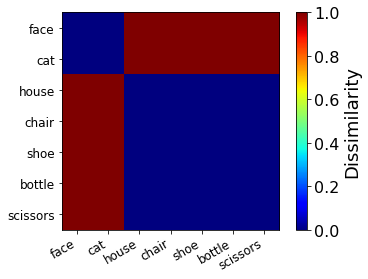

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00026095 0.00169137 0.00022487 0.00035231 0.00076047 0.0004591
 0.00265765 0.00046248 0.00054069 0.00087392 0.00089765 0.001025
 0.00108863 0.00125102 0.00075579 0.00018545 0.00039512 0.00023258
 0.00019761 0.00018663 0.00026389]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00025008 0.00139756 0.00023584 0.00027242 0.00067294 0.00034758
 0.00207636 0.00040726 0.00035432 0.00060913 0.00068273 0.00076437
 0.00084159 0.00116882 0.00055703 0.00011607 0.00044748 0.00022929
 0.00026481 0.00017769 0.00030254]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00056447 0.00056814 0.00024173 0.0001952  0.00120267 0.00046033
 0.00123202 0.00037049 0.00030174 0.00038331 0.00034248 0.00044589
 0.00047773 0.00130279 0.00051843 0.00017841 0.0006984  0.00025744
 0.0006094  0.0002507  0.00036091]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00058722 0.0003226  0.00218044 0.00029419 0.00101811 0.00066685
 0.00073562 0.00112339 0.00047231 0.00060945 0.00063619 0.00182819
 0.0002743  0.00062051 0.00053786 0.00153066 0.00077191 0.00152128
 0.00048977 0.0008038  0.00064946]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00066215 0.00066218 0.00133428 0.00029208 0.00071084 0.00041414
 0.00151372 0.0005339  0.00055177 0.00065659 0.00080076 0.00181655
 0.0004966  0.00055781 0.00037598 0.00095719 0.00091026 0.00125625
 0.00022685 0.00042635 0.00044636]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1.

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0003081  0.00063085 0.00157531 0.000505   0.00162589 0.0005916
 0.00026368 0.00079684 0.0002585  0.00110649 0.00031115 0.0009692
 0.00015091 0.00061182 0.00029098 0.00087555 0.00096289 0.00091641
 0.00048215 0.00024411 0.00053858]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00018216 0.0004352  0.0009606  0.00036896 0.00109235 0.00029329
 0.00019043 0.00048544 0.00019319 0.00072926 0.00018467 0.00059211
 0.00010511 0.00041189 0.00017112 0.00052281 0.00061826 0.00068074
 0.00029549 0.00010681 0.00035306]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.43854788e-05 2.40513239e-04 4.97222119e-04 2.23741037e-04
 5.47465619e-04 9.96026376e-05 1.24731294e-04 2.63614485e-04
 1.49752930e-04 5.00668536e-04 9.92451390e-05 2.59437875e-04
 6.41130427e-05 3.29050555e-04 1.23585989e-04 2.75677944e-04
 3.36754858e-04 2.85632796e-04 2.25491065e-04 8.30525403e-0

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00103379 0.00074841 0.00162432 0.00151074 0.00189178 0.00057832
 0.00108417 0.00073834 0.00092952 0.00187945 0.00047735 0.00218216
 0.00089148 0.00111437 0.00065502 0.00257145 0.00280466 0.00141264
 0.00107236 0.0007399  0.00115756]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0011501  0.00055374 0.00151228 0.0015897  0.00226226 0.00102174
 0.00128425 0.00056418 0.00128423 0.00240864 0.00069161 0.0021134
 0.00110768 0.00213667 0.00143996 0.00285987 0.00324789 0.00095571
 0.00168764 0.00158704 0.00122738]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00026998 0.00024635 0.00052    0.0004591  0.00098038 0.00034898
 0.00049744 0.00024086 0.0007224  0.00112357 0.0003923  0.00066984
 0.00014746 0.00048949 0.00026396 0.00097065 0.00118733 0.00071229
 0.00030114 0.00031605 0.00046563]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00024363 0.0003399  0.00091152 0.00057884 0.00128348 0.00048801
 0.00045553 0.00065698 0.00066579 0.00128146 0.00048898 0.0009861
 0.00020265 0.00072907 0.00047057 0.00135251 0.00128412 0.00089715
 0.00053903 0.00048717 0.00050882]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00012679 0.0002385  0.00206054 0.00056994 0.00115023 0.00032856
 0.00016699 0.00191466 0.00041534 0.00099228 0.000266   0.00193339
 0.00028529 0.00077722 0.00044029 0.00242933 0.00131219 0.00229711
 0.00061173 0.00064019 0.00088096]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.46336417e-05 4.35042600e-05 9.16155568e-05 3.50308822e-05
 2.22428694e-04 8.65165228e-05 2.39578839e-05 3.83786071e-05
 3.65397332e-05 1.68637663e-04 6.74781267e-05 5.10991157e-05
 1.93047929e-05 1.08930708e-04 3.56225272e-05 7.79571134e-05
 1.58734109e-04 1.14573837e-04 1.16672763e-04 5.12777343e-05
 7.41001035e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.45345672e-05 5.35009517e-05 6.15346158e-05 4.44491555e-05
 1.93746560e-04 6.62815265e-05 3.02233326e-05 3.59049661e-05
 3.49864712e-05 1.55055401e-04 4.93715933e-05 2.97539198e-05
 1.76995721e-05 8.37258081e-05 3.59178012e-05 5.28312817e-05
 1.11428453e-04 7.32869052e-05 9.73828864e-05 5.17999405e-05
 8.17492021e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 1.63145673e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.56908586e-05 7.30519532e-05 1.68929490e-04 7.44004490e-05
 2.77535096e-04 1.12894911e-04 5.44644351e-05 7.76512325e-05
 4.52637097e-05 1.63352235e-04 6.03947206e-05 2.12309911e-04
 8.13855882e-05 2.26507007e-04 1.81837734e-04 9.53531359e-05
 1.30076585e-04 8.78599650e-05 1.60989040e-04 1.02386695e-04
 1.61472685e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.04757650e-05 4.64808291e-05 1.09127289e-04 5.37663752e-05
 2.55001992e-04 7.53900928e-05 1.57419459e-05 4.70629602e-05
 3.37963197e-05 1.60155051e-04 4.63521983e-05 7.29013069e-05
 2.92376721e-05 1.63606912e-04 7.86961140e-05 7.32824799e-05
 9.70088073e-05 6.34577130e-05 1.30638315e-04 8.69993886e-05
 1.15111863e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.76040666e-05 3.53678990e-05 7.20001497e-05 3.02478072e-05
 1.20293096e-04 6.42201113e-05 1.45

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.11832331e-05 7.26309753e-05 1.27953141e-04 4.53191232e-05
 1.66768026e-04 7.75127183e-05 8.05989122e-05 7.18433060e-05
 5.28326207e-05 1.39795963e-04 8.03762267e-05 1.38390308e-04
 3.53571245e-05 1.07911769e-04 8.01483579e-05 1.11791797e-04
 1.59958118e-04 1.04077816e-04 9.08793961e-05 7.00092682e-05
 4.81644643e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[4.71683637e-05 6.25365211e-05 9.06787991e-05 5.71598656e-05
 1.48046417e-04 7.81676196e-05 7.26584021e-05 4.83715563e-05
 5.75036983e-05 1.69395674e-04 7.84589482e-05 9.85282720e-05
 2.03780108e-05 1.04414332e-04 6.31877790e-05 7.47855962e-05
 1.56516995e-04 7.26164852e-05 9.86658815e-05 4.33728258e-05
 5.67135616e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[5.52835438e-05 5.25122814e-05 7.90758201e-05 5.04603032e-05
 1.39822974e-04 8.42128724e-05 5.49871395e-05 4.4560

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[5.69838900e-05 2.77694169e-04 1.02908072e-03 1.59115439e-04
 5.54750250e-04 1.51454253e-04 2.02408602e-04 7.93447579e-04
 1.46452194e-04 4.27891912e-04 1.44556276e-04 5.55579453e-04
 4.54677660e-05 1.15558079e-04 3.65051109e-04 6.22138003e-04
 4.32825206e-04 1.38533796e-03 1.67035520e-04 2.91183653e-04
 6.08248516e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.08593889e-05 1.89793045e-04 8.43155928e-04 1.51233385e-04
 4.64090658e-04 1.54805552e-04 1.51683963e-04 7.33334826e-04
 1.39687582e-04 3.94798791e-04 1.47594802e-04 6.41993495e-04
 4.57462544e-05 1.39384700e-04 2.48573034e-04 5.79078331e-04
 4.94740094e-04 1.16639947e-03 1.44242952e-04 2.65452354e-04
 4.31153731e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.92292420e-05 1.30101639e-04 6.82955313e-04 8.98113447e-05
 3.26486058e-04 1.70683460e-04 1.19915012e-04 6.0479

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00085683 0.00063157 0.0006731  0.00121107 0.00242836 0.00226138
 0.00033385 0.0006334  0.00055082 0.00161995 0.0008302  0.00076518
 0.00035346 0.00118173 0.00127983 0.00106906 0.00193047 0.00147589
 0.00071715 0.00084315 0.00098162]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00062498 0.00090479 0.00114522 0.00108485 0.00168785 0.0016528
 0.0004622  0.0008116  0.00043049 0.00103043 0.00064802 0.00096321
 0.00045495 0.00120621 0.00140651 0.00151807 0.00210823 0.00175122
 0.00033725 0.00064268 0.00079168]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.32176528e-04 1.54731463e-04 2.95429632e-04 1.89728299e-04
 3.94437498e-04 3.20388255e-04 9.07474642e-05 1.99111805e-04
 9.78862990e-05 3.29005006e-04 1.23413137e-04 2.64963483e-04
 8.73008796e-05 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[6.33055919e-05 8.85390508e-05 9.58460205e-05 8.51457508e-05
 1.40286219e-04 7.50886374e-05 4.68950591e-05 5.33943319e-05
 8.93009317e-05 1.83841841e-04 7.78906297e-05 6.14072525e-05
 4.19563185e-05 1.38110905e-04 4.51875555e-05 7.84104236e-05
 1.20024695e-04 5.70495343e-05 7.72914524e-05 5.16270246e-05
 8.86151260e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[4.87998234e-05 8.74760513e-05 8.08081176e-05 9.05333730e-05
 1.08921558e-04 6.20319685e-05 5.29283754e-05 3.77793289e-05
 8.23283212e-05 1.36532799e-04 8.51049080e-05 4.45765889e-05
 3.12604719e-05 1.02378643e-04 8.43239997e-05 3.92263178e-05
 8.55061205e-05 8.67711303e-05 5.58943836e-05 6.83038933e-05
 6.82884000e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.69679007e-05 6.97804674e-05 7.11790572e-05 6.77760726e-05
 7.10378395e-05 5.12260298e-05 3.96610118e-05 1.8280

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[5.26061388e-05 4.64192343e-05 1.23696662e-04 4.26849824e-05
 2.22774620e-04 8.57220846e-05 4.20091480e-05 9.49708226e-05
 7.33233080e-05 2.16373956e-04 1.44822721e-04 1.35197575e-04
 4.05217551e-05 1.60628204e-04 9.91750812e-05 1.15492440e-04
 2.51961562e-04 2.51285807e-04 1.36029524e-04 7.50986912e-05
 1.52922246e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.54414818e-05 7.82125664e-05 8.40758897e-05 6.59777251e-05
 2.27093009e-04 7.59563729e-05 6.20270023e-05 3.87339552e-05
 5.46226615e-05 1.69417084e-04 7.28531763e-05 7.02321644e-05
 2.33118657e-05 1.06880407e-04 6.02630248e-05 5.64046307e-05
 1.39825757e-04 1.36901633e-04 8.64694021e-05 6.46905011e-05
 1.16946991e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.00956343e-05 5.78983040e-05 1.04767442e-04 6.15300129e-05
 1.85333572e-04 4.34139870e-05 5.22854378e-05 5.0284

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[8.76852790e-05 1.40786618e-04 1.50648197e-04 9.09250412e-05
 3.67118112e-04 8.76670808e-05 7.51514407e-05 7.03452107e-05
 5.83052869e-05 3.26038969e-04 6.85559207e-05 5.57953152e-05
 3.69988426e-05 1.85352177e-04 5.56257767e-05 7.11938904e-05
 2.00362415e-04 7.32643889e-05 1.88236829e-04 4.38033258e-05
 1.48381120e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.01438890e-04 2.20022526e-04 2.97070578e-04 1.40671986e-04
 5.69883510e-04 2.15860396e-04 9.72559149e-05 1.28385176e-04
 6.18118831e-05 3.89893665e-04 1.16055502e-04 6.81879811e-05
 4.56557959e-05 2.02842326e-04 7.15826110e-05 1.25733199e-04
 2.03081742e-04 1.15738608e-04 2.65143145e-04 8.40279307e-05
 1.73197006e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.28729022e-04 5.29535482e-04 6.67000117e-04 3.64407174e-04
 1.08348666e-03 4.53305777e-04 1.81126563e-04 2.38297932e-04


 1.21481861e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[5.74150931e-05 9.08244597e-05 1.44078297e-04 9.29537104e-05
 2.94874720e-04 1.09214180e-04 7.84424156e-05 7.17088579e-05
 9.82583996e-05 2.90818579e-04 1.25637530e-04 1.66176178e-04
 4.81463104e-05 2.47143000e-04 5.99940547e-05 1.72374514e-04
 2.41036308e-04 1.39649675e-04 1.25142951e-04 5.94522416e-05
 1.26037112e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[4.94112294e-05 5.96909809e-05 9.57413381e-05 8.21978038e-05
 3.18546413e-04 1.01987650e-04 3.33208994e-05 4.09949972e-05
 5.36961413e-05 2.38928568e-04 7.40593822e-05 7.44489953e-05
 2.44841950e-05 2.38594410e-04 4.51317252e-05 8.68691869e-05
 1.91838161e-04 8.33084159e-05 1.41754649e-04 3.26337941e-05
 1.17995896e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.99618163e-05 5.95868549e-05 5.72187577e-05 8.90994677e-05
 2.91865492e-04 9.45624500e-05 4.45

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00269773 0.0028746  0.00443326 0.00470758 0.00688443 0.00254842
 0.00434351 0.00218267 0.00981238 0.01184367 0.00240978 0.00895508
 0.00308743 0.00697717 0.00178891 0.01463089 0.01148776 0.00517145
 0.0050378  0.00547079 0.00761208]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00151856 0.00297453 0.00255391 0.00449348 0.00808595 0.00489841
 0.00400457 0.00091831 0.00708133

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.81607626e-05 2.94978953e-05 7.56040357e-05 3.84715936e-05
 7.09669744e-05 7.98476235e-05 3.73520462e-05 5.64804700e-05
 2.99220722e-05 7.48246937e-05 1.29785576e-04 1.01738039e-04
 2.48576952e-05 7.12808557e-05 1.05942234e-04 8.93875678e-05
 4.17820309e-05 1.03099773e-04 7.40806574e-05 1.38343266e-04
 4.42613079e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.39705187e-05 2.88948612e-05 6.80559200e-05 4.40470044e-05
 6.53200489e-05 8.14468678e-05 2.43243916e-05 4.50022495e-05
 3.32310804e-05 6.10319102e-05 1.22248427e-04 7.68285436e-05
 2.85355440e-05 6.14294736e-05 1.19068340e-04 8.87364358e-05
 3.07356654e-05 8.33257810e-05 7.60938367e-05 1.68597095e-04
 5.64286885e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.88696772e-05 1.62881861e-05 7.96853619e-05 3.55001624e-05
 6.85529743e-05 7.66569054e-05 2.27138398e-05 5.5047

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00330482 0.00708907 0.00241988 0.00070699 0.00370471 0.01603199
 0.00909657 0.0008863  0.00383531 0.00648379 0.01793928 0.00895757
 0.00787782 0.00378325 0.00383126 0.00271774 0.00532491 0.01786705
 0.00331592 0.01820579 0.01127308]
7
(7, 7)
(7, 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00062513 0.00120525 0.00192092 0.00157907 0.00277531 0.00128114
 0.00142138 0.00155162 0.00132612 0.0032617  0.00104945 0.00304005
 0.00121996 0.00179147 0.00211501 0.0024181  0.00306322 0.00126491
 0.00172702 0.00160197 0.00246928]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00041607 0.00055218 0.00110816 0.00087579 0.00186262 0.00078501
 0.00050196 0.00050665 0.00102961 0.00241342 0.00047665 0.00092382
 0.00039469 0.00102316 0.00041118 0.00191249 0.00274864 0.00056945
 0.00085564 0.00085303 0.00141585]
7
(7, 7)
(7, 7)


7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.51081512e-05 5.46477458e-05 1.09798873e-04 5.95605805e-05
 1.70281150e-04 1.76561041e-04 7.54732826e-05 7.74153642e-05
 7.68728266e-05 1.33689694e-04 1.69852646e-04 1.86598705e-04
 5.82858182e-05 1.25370600e-04 1.55978236e-04 2.19977186e-04
 2.05563441e-04 1.91239275e-04 1.34638008e-04 2.80346384e-04
 1.82002323e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.77534309e-05 3.63830173e-05 6.91742802e-05 5.56674228e-05
 1.13166207e-04 9.78415794e-05 4.92575412e-05 3.80641084e-05
 7.91618487e-05 8.82631644e-05 8.97688176e-05 1.00782311e-04
 3.33913590e-05 7.90041393e-05 8.61736606e-05 1.52840135e-04
 1.18810963e-04 9.53949645e-05 8.32264854e-05 1.25654370e-04
 9.27470225e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.65239628e-05 2.20823800e-05 5.83276375e-05 4.57706269e-05
 7.33394424e-05 6.36961982e-05 3.00556398e-05 4.4918

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0.00159206 0.00158276 0.00097088 0.00044211 0.00172719 0.00325359
 0.00345246 0.00060376 0.00271526 0.00390069 0.00491983 0.00231955
 0.00146181 0.00086903 0.0016193  0.00176024 0.00233645 0.00348419
 0.00136468 0.00390131 0.00256446]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00042044 0.00039964 0.00030075 0.00025408 0.00064599 0.00055587
 0.00116122 0.00023243 0.0009335  0.00154957 0.00140671 0.00079661
 0.00016144 0.00045092 0.00066219 0.00069637 0.00095889 0.00096354
 0.00053754 0.00074555 0.00042176]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.66638921e-05 1.06513991e-04 8.82787081e-05 1.05740665e-04
 2.76181850e-04 1.65975460e-04 2.52974887e-04 1.09771400e-04
 2.64229071e-04 5.45624832e-04 3.41535726e-04 1.57879355e-04
 6.31621767e-05 2.21754626e-04 2.32567606e-04 1.61588886e-04
 3.01311987e-04 2.34539901e-04 1.93350068e-04 2.22882501e-04
 1.39442770e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.51721899e-05 5.45298413e-05 8.74814842e-05 5.51792351e-05
 1.28889474e-04 8.10476822e-05 4.22142989e-05 2.79233827e-05
 5.32372301e-05 1.32746575e-04 6.06510278e-05 7.57064408e-05
 4.05622797e-05 1.11150085e-04 9.61666920e-05 8.13468343e-05
 1.24792948e-04 7.28366401e-05 6.37437998e-05 4.32319732e-05
 6.49313650e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.67815375e-04 1.11535133e-04 3.12698931e-04 1.03343751e-04
 3.27482160e-04 1.81932134e-04 1.03183346e-04 9.06563046e-05
 1.97991768e-04 4.97731458e-04 2.35342227e-04 1.85169722e-04
 1.24065961e-04 3.19535777e-04 1.78580934e-04 2.66426292e-04
 5.36533512e-04 3.29000917e-04 1.78059511e-04 8.48567346e-05
 1.80000359e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00012701 0.00015347 0.0003129  0.00016541 0.00043975 0.00029903
 0.00017449 0.00020875 0.00031101 0.00057026 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.01922000e-04 7.28635603e-05 2.08494147e-04 1.01315597e-04
 1.96153043e-04 1.71270581e-04 1.31775516e-04 1.53816984e-04
 1.50784644e-04 1.69381953e-04 1.67370482e-04 2.69579943e-04
 1.55709493e-04 1.54281600e-04 1.99291674e-04 1.96821180e-04
 1.56437265e-04 2.79646334e-04 2.15340365e-04 3.09873249e-04
 2.17194781e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00017542 0.00026129 0.00040209 0.00021962 0.00031404 0.00033911
 0.00038001 0.00024402 0.00023672 0.00029775 0.00034338 0.00057991
 0.00040946 0.00042639 0.00066619 0.00037582 0.00024552 0.0004226
 0.00034392 0.00044738 0.0003416 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00023574 0.00029381 0.00049197 0.00023755 0.00037327 0.00026527
 0.00036403 0.00023716 0.00020232 0.0002353  0.00029808 0.00054369
 0.00041845 0.00034877 0.00055567 0.00035996 0.00025561 0.00049395

[0.00063844 0.00133779 0.00132767 0.00058584 0.00055526 0.00102932
 0.00150479 0.00078521 0.00029396 0.00119947 0.0013664  0.00366727
 0.00158063 0.00127287 0.0024528  0.00070772 0.00197494 0.0015747
 0.00093907 0.00105103 0.00071518]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00067426 0.00143485 0.00158395 0.00065142 0.0006136  0.00088615
 0.00183619 0.00080679 0.00036855 0.00169273 0.00162335 0.0040132
 0.00191689 0.00135591 0.00295505 0.00076893 0.00254223 0.00168919
 0.0011613  0.00113354 0.00103911]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00021127 0.00136728 0.00049141 0.00050754 0.00060263 0.0004353
 0.00109803 0.00049058 0.00033734 0.00099916 0.00076556 0.00239612
 0.00141776 0.00154288 0.00228241 0.00065136 0.00120926 0.00074783
 0.00073212 0.00071283 0.00087425]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00028077 0.00044053 0.00033506 0.00058042 0.00055

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00023207 0.00039457 0.00036602 0.00061461 0.00138551 0.00038805
 0.00030816 0.00011524 0.00063597 0.00114727 0.00025929 0.00045909
 0.00021417 0.00040703 0.00019765 0.00092667 0.00125185 0.00026249
 0.00035533 0.0003879  0.00060996]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.66380273e-04 3.99581884e-04 2.84491719e-04 4.50305885e-04
 1.37954184e-03 3.90260823e-04 4.19620532e-04 1.64035107e-04
 4.51844486e-04 1.27580454e-03 3.69652794e-04 4.69182986e-04
 9.28936356e-05 4.03268341e-04 2.16901633e-04 6.44866654e-04
 1.11804867e-03 2.90447185e-04 4.91471170e-04 3.11029039e-04
 5.80377801e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[4.73080283e-05 1.20048554e-04 1.00701151e-04 1.30033720e-04
 3.50072502e-04 1.18714799e-04 9.57822830e-05 5.39413023e-05
 1.29871880e-04 3.02005109e-04 9.64452827e-05 1.96509771e-04
 2.72394061e-05 1.39423375e-04 6

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00180319 0.00138709 0.00083997 0.00167487 0.00184114 0.00102562
 0.00048884 0.0009919

 0.00047184 0.00100494 0.0009339 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00037875 0.00048956 0.00055743 0.00094475 0.00096091 0.00058655
 0.00033964 0.00036965 0.00085298 0.00124495 0.00052838 0.00068279
 0.0006618  0.0008206  0.00035848 0.00154116 0.00163377 0.00065414
 0.00028191 0.00061536 0.00048161]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00035065 0.0005036  0.00078433 0.00068665 0.00063768 0.00069938
 0.00021644 0.00043754 0.00041809 0.00062014 0.00027684 0.00051485
 0.00047963 0.00066122 0.00033814 0.001232   0.00156617 0.00052654
 0.00020824 0.00045577 0.00061892]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00033682 0.00034511 0.00129176 0.00028694 0.00093855 0.00064863
 0.00020956 0.00058456 0.00048219 0.00137564 0.00030293 0.00071669
 0.00046331 0.00126808 0.00037636 0.00167658 0.00324993 0.00078871
 0.00053436 0.00053052 0.00115287]
7
(7, 7)
(7, 7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[6.83999925e-05 1.30647312e-04 1.41769449e-04 1.88496828e-04
 3.49347635e-04 4.60894296e-04 7.66622237e-05 5.75177956e-05
 1.26164372e-04 3.07986228e-04 3.37477509e-04 1.81834638e-04
 9.79620399e-05 3.03840697e-04 3.85772368e-04 1.97857665e-04
 2.95122103e-04 2.72149483e-04 1.39656041e-04 1.60111327e-04
 1.19521897e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[8.00889406e-05 1.60146116e-04 1.63943864e-04 1.29979001e-04
 2.11294630e-04 3.29430086e-04 9.20426719e-05 3.97900693e-05
 9.39815574e-05 1.90319772e-04 1.80402623e-04 1.53614476e-04
 6.41142758e-05 1.75784131e-04 2.43753667e-04 1.55817251e-04
 2.04570347e-04 1.40525210e-04 1.02314892e-04 1.58807979e-04
 1.08293064e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.00137222e-05 1.71077583e-04 1.91541603e-04 1.24731693e-04
 1.65848073e-04 3.06237408e-04 7.93012519e-05 4.2181

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00016711 0.0002039  0.00034682 0.00019027 0.0004667  0.00055747
 0.00034241 0.00028041 0.00016333 0.00055743 0.00055642 0.00071827
 0.00022781 0.00059525 0.00090004 0.0004328  0.00066209 0.00046502
 0.00033424 0.0006388  0.00049934]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00021981 0.00031244 0.00056962 0.00029927 0.00077765 0.00067274
 0.00036988 0.00040088 0.00022482 0.0009003  0.00057355 0.00071459
 0.00032176 0.00084831 0.00079457 0.00060915 0.00094657 0.00040439
 0.00058265 0.00078539 0.00072446]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00023574 0.00026733 0.00060024 0.00028661 0.00060732 0.00039173
 0.00018626 0.00020418 0.00013344 0.00045167 0.00028581 0.00032745
 0.00019443 0.00039833 0.00036269 0.0002901  0.00049683 0.00049381
 0.00029501 0.00038428 0.00042296]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00058059 0.00062884 0.00149359 0.00098332 0.00275727 0.00280693
 0.00097175 0.00058853 0.00119605 0.00244696 0.00211173 0.00182255
 0.00044971 0.00119985 0.00149996 0.00224635 0.00284996 0.00224031
 0.00106423 0.00219913 0.00163718]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00028401 0.00049992 0.0007061  0.00065033 0.00185261 0.00085088
 0.00104178 0.00027337 0.00117667 0.00242111 0.00109754 0.00133611
 0.00021731 0.00089351 0.0006016  0.00153439 0.00232053 0.00127668
 0.00060645 0.00049001 0.00087088]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[6.89861500e-05 1.20283671e-04 1.86357337e-04 1.35472130e-04
 3.32486733e-04 1.41480565e-04 2.45788824e-04 6.88360674e-05
 2.85934166e-04 4.66494173e-04 2.33598500e-04 3.45369705e-04
 3.52007663e-05 1.65737669e-04 9.55824393e-05 4.18482058e-04
 5.02046626e-04 3.13172008e-04 1.19496569e-

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.21086584e-04 4.59375480e-04 2.29234716e-04 6.24287320e-04
 1.34859009e-03 1.33998189e-03 3.73301719e-04 9.96018228e-05
 4.60088843e-04 1.26107531e-03 1.20428884e-03 4.04239274e-04
 2.66134914e-04 7.19225173e-04 7.59891254e-04 6.43273259e-04
 1.39142134e-03 1.34488101e-03 4.23347932e-04 9.31138734e-04
 6.48784990e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00016813 0.00066113 0.00040181 0.00066886 0.00159041 0.00170836
 0.0005191  0.00019179 0.0005476  0.00121815 0.00135425 0.00040951
 0.00026023 0.00076217 0.00096744 0.00070418 0.00112726 0.00109783
 0.00066785 0.00127411 0.00048896]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.53134525e-05 2.52675736e-04 2.32827882e-04 1.86723657e-04
 6.43089750e-04 7.11433716e-04 2.20428474e-04 1.19171518e-04
 1.76449094e-04 4.49532256e-04 5.93063543e-04 2.54885692e-04
 7.96486714e-05 

[6.17737619e-05 8.41572722e-05 1.76359881e-04 8.53985041e-05
 1.81538035e-04 2.57193953e-04 1.14361045e-04 1.06783502e-04
 1.51043610e-04 2.12771088e-04 2.42491436e-04 2.33112844e-04
 7.13585346e-05 9.49535463e-05 1.45463061e-04 2.96714192e-04
 2.70117634e-04 3.89074708e-04 1.04647141e-04 2.96582589e-04
 2.30600524e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[6.55685713e-05 6.96892710e-05 1.71977826e-04 7.38345143e-05
 3.04937392e-04 2.72733314e-04 1.40260854e-04 1.17388599e-04
 2.14080902e-04 5.16814673e-04 3.90731147e-04 1.74679291e-04
 8.07170105e-05 2.00268433e-04 1.93949813e-04 2.91240137e-04
 4.32448771e-04 4.46582631e-04 1.77751131e-04 3.28579172e-04
 2.97102818e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.65002335e-05 6.52593940e-05 1.21301137e-04 3.19560599e-05
 2.34082321e-04 1.74106051e-04 1.03745375e-04 1.17406142e-04
 1.11961407e-04 3.23183306e-04 2.33729917e-04 1.25616442e-04
 5.31459203

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00113327 0.00413698 0.00233153 0.00651236 0.01491481 0.00447855
 0.00353213 0.0007382  0.00616372 0.0125672  0.00283819 0.00371028
 0.00107055 0.00475264 0.00129404 0.00724813 0.01263243 0.00305748
 0.00320238 0.00206968 0.00424408]
7
(7, 7)
(7, 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00036368 0.00054097 0.00063088 0.00077568 0.00081697 0.00070693
 0.00029278 0.00032916 0.00061379 0.00077373 0.00043909 0.00045286
 0.00029069 0.00056902 0.00037239 0.00059586 0.0007072  0.00038772
 0.0002903  0.00031109 0.00027645]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00022885 0.00027093 0.00052799 0.00036602 0.00062852 0.00054966
 0.00029798 0.00029006 0.00067582 0.00099375 0.00069314 0.00052166
 0.00045605 0.00084031 0.0007207  0.00082998 0.00107667 0.00068381
 0.00022046 0.00033724 0.00034702]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00018854 0.00025203 0.00050668 0.00021555 0.00029567 0.00032687
 0.00015479 0.0001992  0.00040149 0.00043216 0.00039886 0.00031975
 0.00040891 0.00050201 0.00052661 0.00071471 0.0006987  0.00058124
 0.00016426 0.00029041 0.0002962 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 7.75514289e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.09225116e-05 3.02616334e-05 5.02416067e-05 3.14335552e-05
 6.03544159e-05 4.77779283e-05 2.44811203e-05 2.30531098e-05
 3.34558892e-05 5.63330491e-05 2.46435950e-05 7.14481855e-05
 9.09921529e-06 5.70487452e-05 5.06285714e-05 7.92264203e-05
 7.86366197e-05 3.33973664e-05 5.17218553e-05 5.72676792e-05
 3.64643806e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.29617542e-05 2.82034199e-05 1.01291173e-04 2.76329932e-05
 9.67710859e-05 7.78148248e-05 3.09926024e-05 5.78760452e-05
 4.07811736e-05 7.77883936e-05 5.40560664e-05 1.20097449e-04
 2.10060118e-05 9.13302618e-05 7.83417556e-05 1.36012705e-04
 1.12353557e-04 4.79129934e-05 8.56322140e-05 9.10550916e-05
 4.47807008e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[6.40589134e-05 9.24142461e-05 2.46941576e-04 8.78094714e-05
 2.11360732e-04 2.43396715e-04 7.68

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0009478  0.00219418 0.00164273 0.00803874 0.01347679 0.00291405
 0.00336298 0.00095257 0.01021554 0.01638003 0.00367809 0.00466262
 0.00261806 0.00574539 0.00143708 0.01191647 0.01753925 0.005056
 0.00146654 0.00397888 0.00740156]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00438405 0.01050608 0.01133797 0.03544461 0.05612839 0.01383394
 0.01718642 0.00443615 0.04683261 0.06746641 0.01

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0.00082891 0.00088852 0.00159885 0.0007759  0.00116517 0.00117418
 0.00106011 0.0006864  0.00095048 0.00143188 0.00116838 0.00149522
 0.00087959 0.00092438 0.00119158 0.00146092 0.00144611 0.00101729
 0.00069369 0.00172112 0.00142164]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00108669 0.00096968 0.00230613 0.00096453 0.00121535 0.00117205
 0.00156661 0.00100941 0.00095143 0.00150296 0.00154301 0.00214521
 0.00122797 0.00112318 0.00106614 0.00148808 0.00130954 0.00173089
 0.00089429 0.00182949 0.00132506]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00091878 0.00057424 0.00137902 0.00081104 0.00142146 0.00188271
 0.0008852  0.00068649 0.00104703 0.00171755 0.00166042 0.0011492
 0.00085325 0.00152967 0.00172415 0.00139133 0.00191078 0.00225339
 0.00056885 0.00179283 0.00166469]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00035474 0.00031298 0.00068329 0.00050546 0.001

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[7.46492223e-05 8.49838939e-05 9.76249195e-05 1.05180845e-04
 1.77402448e-04 9.33415084e-05 3.92215004e-05 1.16288201e-05
 1.32610849e-04 3.04984533e-04 7.71710823e-05 6.62077104e-05
 8.24190917e-05 2.83621769e-04 4.25509083e-05 1.66221532e-04
 3.27117298e-04 1.05995032e-04 2.12017428e-04 4.63715889e-05
 1.97525433e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.06668367e-04 1.14297418e-04 1.36030193e-04 1.39612409e-04
 2.14784866e-04 1.41502527e-04 6.36396585e-05 2.27514827e-05
 1.83335854e-04 2.66346013e-04 9.37357524e-05 8.82193464e-05
 9.07773987e-05 2.22589175e-04 4.40247856e-05 2.03756089e-04
 2.36253555e-04 1.18959027e-04 1.61551642e-04 6.39278335e-05
 1.57111724e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.69455161e-05 9.28571468e-05 1.14973037e-04 9.49701635e-05
 2.37016053e-04 8.81596504e-05 6.82873319e-05 2.564498

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00046708 0.00071192 0.00055236 0.00068069 0.00061823 0.00082536
 0.00033735 0.00019108 0.00057157 0.00097799 0.0005966  0.0002837
 0.00047097 0.00095471 0.00061624 0.00056911 0.00096393 0.00048933
 0.0003936  0.0006087  0.0005367 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00034379 0.00068332 0.00038437 0.00050891 0.00061652 0.00079177
 0.00042662 0.00026523 0.0004764  0.00092843 0.00057428 0.00027066
 0.00047002 0.00084376 0.00064097 0.00046497 0.00074574 0.00050033
 0.00037738 0.00055249 0.0005789 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00029971 0.00055449 0.00034514 0.00061849 0.00130431 0.00046823
 0.00053421 0.00032838 0.00104834 0.00213102 0.0007467  0.0003215
 0.00087565 0.0018616  0.00068771 0.0005244  0.00133791 0.0004508
 0.0005827  0.00045793 0.00080403]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.42306195e-04 3.84300104e-04 2.78818816e-04 4.79334860e-04
 6.72761424e-04 7.67341124e-04 2.84808879e-04 9.92733438e-05
 4.01641409e-04 4.86112354e-04 5.85557793e-04 1.59109343e-04
 1.72209242e-04 2.01503861e-04 2.41509124e-04 2.67325337e-04
 2.99443324e-04 2.96267879e-04 1.19685508e-04 3.42623730e-04
 1.69558939e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.51558643e-04 1.97001740e-04 2.34174399e-04 2.83993627e-04
 3.65509568e-04 4.38911996e-04 7.20537169e-05 4.30929105e-05
 1.62138220e-04 2.11891544e-04 1.90844328e-04 7.62104587e-05
 9.84644885e-05 1.49287736e-04 1.45518972e-04 1.37743260e-04
 1.65937647e-04 1.08935879e-04 7.79495119e-05 1.47282466e-04
 9.43747053e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.43521173e-04 1.17090764e-04 2.41032529e-04 1.88233852e-04
 3.23009845e-04 4.14974954e-04 3.63709758e-05 4.4993

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00095458 0.00208356 0.00136172 0.00423381 0.00797741 0.00320298
 0.00198927 0.00040962 0.00420341 0.0068266  0.00218816 0.00194591
 0.00082118 0.00256552 0.00077289 0.00430165 0.00626051 0.0020798
 0.00153294 0.00124379 0.00161837]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00059812 0.00066567 0.00098981 0.00127811 0.00233132 0.00126411
 0.0004934  0.0002912  0.00097006 0.00167566 0.00074461 0.00052507
 0.00047305 0.00116298 0.0007623  0.00103599 0.00177247 0.00088296
 0.00050154 0.00071407 0.00076179]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00072435 0.00082987 0.00103692 0.00088264 0.00178679 0.00133499
 0.00072213 0.00037433 0.00124237 0.00207868 0.00121167 0.00098172
 0.00094398 0.0019357  0.00168741 0.00164775 0.00268085 0.00162698
 0.00051329 0.0010182  0.0008277 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00103209 0.0008697  0.00217502 0.00115684 0.00170497 0.00131492
 0.00061171 0.00057461 0.0011432  0.00167528 0.0006699  0.0012449
 0.00051749 0.0007665  0.00053434 0.0017529  0.00214155 0.00114272
 0.00050134 0.00049424 0.00054278]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00039427 0.00031928 0.00070984 0.00053561 0.00067774 0.00071482
 0.00020797 0.00012326 0.00047632 0.00072542 0.00033887 0.00049215
 0.00028968 0.00038439 0.00030352 0.00058153 0.00088962 0.0004457
 0.00018966 0.00023758 0.00025521]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00041664 0.00023708 0.00064935 0.00034557 0.00055257 0.00064136
 0.00016716 0.00012099 0.00037433 0.00053948 0.00027235 0.00040148
 0.0001924  0.00036577 0.00030215 0.00055409 0.00066631 0.00037223
 0.00024184 0.00028245 0.0001869 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00035513 0.00032727 0.0003813  0.00018644 0.00056554 0.00103339
 0.00072396 0.00044468 0.00030976 0.00082204 0.00170944 0.00044445
 0.00026576 0.00028197 0.00075118 0.00029319 0.00054918 0.00118177
 0.00030922 0.00097229 0.00061671]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[8.87129581e-05 2.51372559e-04 1.80986638e-04 1.05088614e-04
 3.51594338e-04 6.33723411e-04 2.53489655e-04 2.03054985e-04
 1.07419383e-04 3.72998215e-04 6.75032103e-04 2.01071677e-04
 1.65992381e-04 3.10735396e-04 6.63935354e-04 1.54990428e-04
 3.36477080e-04 7.49882305e-04 2.50255432e-04 6.66581704e-04
 3.46257607e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00011705 0.00021166 0.00018586 0.0001517  0.00031059 0.00038036
 0.00016055 0.00019003 0.00019228 0.00036527 0.00028699 0.00022112
 0.00014937 0.00027785 0.00032752 0.00026301 0.00029256 0.0002318

 0.00036354 0.00040477 0.00046509]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00023377 0.00041849 0.00039538 0.00024122 0.00065014 0.00064303
 0.00024458 0.0002038  0.0001903  0.00066924 0.00051502 0.00044933
 0.00019956 0.0004818  0.00049571 0.00032824 0.00057655 0.00037418
 0.00042587 0.00050543 0.00035772]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00022726 0.00032341 0.00050351 0.00029971 0.00068391 0.00070162
 0.00015871 0.00020912 0.00021729 0.0006317  0.00055728 0.00034659
 0.00020789 0.00044038 0.00044943 0.00038771 0.00044643 0.00037844
 0.0005914  0.00055481 0.00039254]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[4.55124420e-05 3.15704754e-05 8.56565764e-05 1.52255579e-04
 4.42625951e-04 1.53931023e-04 3.43833146e-05 4.11510999e-05
 1.87961122e-04 4.74262261e-04 1.45058431e-04 4.92857468e-05
 1.17581050e-04 3.66346777e-04 1.06421989e-04 1.58085289e-04
 3.520

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00040577 0.00099302 0.00075965 0.00068701 0.00214275 0.00140152
 0.00173273 0.0003022  0.00124683 0.00278047 0.00220521 0.00220656
 0.00046831 0.00079731 0.00112243 0.00141851 0.00325399 0.0027323
 0.00095307 0.00172088 0.00168349]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[7.06177905e-05 1.00288892e-04 1.98543255e-04 7.68517693e-05
 3.07455090e-04 2.06632413e-04 1.66702785e-04 6.99328781e-05
 1.27890214e-04 2.98017019e-04 2.82482436e-04 3.06630299e-04
 4.27851864e-05 1.34149297e-04 1.15836428e-04 2.43191902e-04
 3.35780250e-04 4.63421626e-04 1.44830835e-04 2.05534977e-04
 2.14337103e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00015955 0.00028167 0.00028438 0.00019164 0.00071859 0.00047253
 0.00017591 0.00023963 0.00017709 0.00065388 0.00044327 0.00029093
 0.00013003 0.00047118 0.00037011 0.00024195 0.00064354 0.00044003
 0.0003542  0.00046389 0.00051902]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00014863 0.00035026 0.00053263 0.00031638 0.00125766 0.00084872
 0.00029569 0.00044433 0.00035204 0.00128644 0.00085214 0.0004779
 0.00020611 0.00073248 0.00053248 0.0003093  0.00093796 0.00100912
 0.00053473 0.00091075 0.00112612]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00018543 0.00030125 0.00050851 0.00039441 0.0013431  0.00114918
 0.0003103  0.00029686 0.00049441 0.00124129 0.0010516  0.00048598
 0.00027183 0.00056832 0.00065569 0.00060215 0.00108951 0.00109091
 0.00066761 0.00152016 0.00145276]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[6.45614532e-05 8.96022290e-05 1.68527688e-04 8.68510947e-05
 1.60689317e-04 1.83741556e-04 6.16138265e-05 5.14069255e-05
 6.90034161e-05 1.25033788e-04 7.82990787e-05 1.02497781e-04
 5.22941868e-05 7.24912686e-05 7.71596538e-05 1.72260237e-04
 1.57964284e-04 1.04193334e-04 9.97822928e-05 9.12697582e-05
 7.85000459e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[4.79827660e-05 6.86215433e-05 9.50078034e-05 6.92964096e-05
 1.33108682e-04 1.41997669e-04 7.29808476e-05 2.78933024e-05
 8.40679840e-05 1.53920930e-04 8.47992297e-05 9.15675094e-05
 3.75915032e-05 6.12565626e-05 8.47829596e-05 1.16477232e-04
 1.61174168e-04 8.69225040e-05 5.77669255e-05 6.12890130e-05
 7.71682549e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[5.85742757e-05 5.69373276e-05 1.02985282e-04 7.31636131e-05
 1.65574361e-04 1.54279628e-04 8.81006485e-05 3.3871

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0010489  0.00055923 0.00176114 0.00053079 0.00145901 0.0012127
 0.00227088 0.00061205 0.00135166 0.0034199  0.00369522 0.00322928
 0.00080962 0.000825   0.00056398 0.00209913 0.00369434 0.00462795
 0.00112436 0.00121404 0.00083742]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0014209  0.00101277 0.00295094 0.00139557 0.0027708  0.00138313
 0.00278755 0.0012392  0.00186222 0.00442921 0.00366812 0.00493928
 0.00161484 0.00164215 0.00111575 0.00368852 0.00561304 0.00576806
 0.00158481 0.00157324 0.00143422]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00172548 0.00134344 0.00338751 0.00263714 0.00396869 0.00243761
 0.00231802 0.00152254 0.00194008 0.00326527 0.00274257 0.0052085
 0.00143615 0.00171556 0.00153647 0.00470635 0.00615195 0.00637775
 0.00091405 0.00162188 0.00179067]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

 0.00358625 0.00282396 0.00306083]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00305528 0.00237324 0.00291663 0.00492    0.00333982 0.00363575
 0.00127595 0.00118399 0.00225902 0.00443339 0.0040825  0.00166471
 0.00107606 0.00183158 0.00212116 0.0036126  0.00437393 0.00415032
 0.00259386 0.00452335 0.00231967]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00034495 0.00022971 0.00030374 0.00054335 0.00063613 0.0008982
 0.00024041 0.00010052 0.00040895 0.00085512 0.00108235 0.00019222
 0.00023155 0.00034031 0.0006106  0.00050403 0.00077222 0.00088324
 0.0004324  0.00126708 0.00071468]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[8.53037674e-05 7.23648526e-05 5.76986098e-05 1.50028094e-04
 2.71424105e-04 4.74140096e-04 6.62826060e-05 4.31150620e-05
 8.14097396e-05 2.22435762e-04 5.18115349e-04 5.01687689e-05
 7.45916999e-05 1.11250778e-04 3.42213818e-04 1.27845725e-04
 1.8954

 5.72977216e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.34885307e-04 1.16679384e-04 1.20331097e-04 1.74005849e-04
 5.64796058e-04 5.47049229e-04 2.04753255e-04 6.92817731e-05
 3.16533657e-04 8.54194724e-04 5.85329355e-04 2.91892946e-04
 4.51664665e-05 2.70631367e-04 2.37067033e-04 4.30460936e-04
 9.54067648e-04 7.52859462e-04 2.06384423e-04 3.21502300e-04
 3.92678631e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.05830780e-04 1.30960823e-04 1.27151356e-04 1.85088887e-04
 5.98781769e-04 7.02892335e-04 1.51496594e-04 1.03097080e-04
 2.57874451e-04 7.35682094e-04 7.04815512e-04 2.56644223e-04
 3.96438170e-05 2.66410454e-04 2.92931971e-04 3.75924287e-04
 7.96591907e-04 8.49287902e-04 2.03412722e-04 2.88720164e-04
 1.57445565e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.90755304e-05 1.54092450e-04 1.30644235e-04 2.17847913e-04
 7.66664257e-04 7.12940063e-04 1.75

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00023831 0.00026288 0.0003405  0.00040653 0.00075089 0.00089843
 0.00021751 0.00016547 0.00042101 0.00128307 0.00084993 0.00030237
 0.0001799  0.00077003 0.00052077 0.00067485 0.00129606 0.00084087
 0.00057478 0.00091431 0.00106659]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.47467683e-04 1.52643972e-04 1.60775756e-04 1.50906901e-04
 6.84375240e-04 5.76710458e-04 2.30079942e-04 7.00563842e-05
 2.89459866e-04 1.01891237e-03 6.22488597e-04 2.62503322e-04
 4.43150761e-05 3.26749567e-04 2.28599384e-04 3.43800174e-04
 1.04404669e-03 7.32069716e-04 2.87769446e-04 3.24677550e-04
 3.36285143e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.10049650e-04 1.59425506e-04 1.15765884e-04 1.46798120e-04
 7.94332597e-04 6.49436480e-04 1.91438094e-04 9.43678162e-05
 2.19175171e-04 1.03200916e-03 6.43349159e-04 1.57853852e-04
 2.98909838e-05 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00052211 0.00058921 0.00067894 0.0012557  0.00277164 0.00191142
 0.00041098 0.00060237 0.00138757 0.00391572 0.00172221 0.00099024
 0.00052821 0.00246682 0.00095408 0.00244153 0.00380982 0.0018324
 0.0014846  0.00127948 0.0019657 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00054316 0.00051705 0.00065065 0.00079184 0.00144374 0.00133863
 0.00043328 0.00035064 0.00101619 0.00259113 0.00091406 0.00094168
 0.00027418 0.00133396 0.00058716 0.00183816 0.00291107 0.00138689
 0.00083041 0.00102731 0.00214843]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00069782 0.00058007 0.00111514 0.00068111 0.0035044  0.00163408
 0.00104237 0.00034682 0.00159889 0.00544844 0.0019891  0.00166466
 0.00019079 0.00195553 0.00067745 0.00239391 0.00648814 0.0028978
 0.0015508  0.00111853 0.00189808]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00042028 0.00026044 0.000994   0.00021442 0.00061313 0.00048386
 0.00048296 0.00041051 0.00071654 0.001016   0.00055232 0.00076776
 0.00014343 0.00032726 0.00054767 0.00124339 0.00104993 0.00125632
 0.00035583 0.00058688 0.0008213 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00030531 0.00015592 0.0009145  0.00025288 0.00060028 0.00030263
 0.00032014 0.00030382 0.00065374 0.00100384 0.00050882 0.00081038
 0.00014872 0.00034532 0.00017736 0.00145806 0.0017914  0.00126924
 0.00017138 0.00025407 0.0003907 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[8.73030847e-05 1.61198520e-04 1.11912216e-04 1.55101709e-04
 5.22430084e-04 2.32684306e-04 2.54939591e-04 8.90285030e-05
 2.77392140e-04 6.75521556e-04 2.39263209e-04 2.50659039e-04
 6.41231823e-05 3.04393288e-04 1.76295058e-04 2.50630301e-04
 5.60571739e-04 2.60927389e-04 1.56540479e-04 2.90275960e-04
 6.21954946e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.78723685e-05 1.47120374e-04 1.05333497e-04 1.33938398e-04
 4.52871731e-04 1.77360899e-04 2.30892898e-04 9.43269037e-05
 2.93731147e-04 6.82092702e-04 2.30615012e-04 1.86323539e-04
 8.91375713e-05 3.10532221e-04 9.80420431e-05 1.89683794e-04
 4.53446052e-04 2.33481250e-04 1.37853379e-04 2.01857119e-04
 5.03411907e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.31422265e-04 1.04844854e-04 3.55118448e-04 2.22066702e-04
 7.28975758e-04 2.12380412e-04 2.16072074e-04 9.4946

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[4.01284685e-05 4.48738289e-05 5.76106513e-05 6.03090587e-05
 1.29483834e-04 6.50037705e-05 8.79066547e-05 2.85685336e-05
 1.38908084e-04 2.12741846e-04 9.81380960e-05 1.02326750e-04
 5.42325195e-05 1.20896468e-04 6.18827470e-05 1.82369563e-04
 2.37364369e-04 1.41311927e-04 6.07295254e-05 3.90652061e-05
 6.52984210e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.98483018e-05 4.60432670e-05 5.01783918e-05 5.63446172e-05
 1.50170609e-04 7.92837874e-05 9.97073793e-05 3.08347404e-05
 1.44877423e-04 2.46158290e-04 1.07650823e-04 8.65791104e-05
 7.86604831e-05 1.90919969e-04 9.22417031e-05 1.78407669e-04
 2.63547397e-04 1.59016329e-04 8.13336478e-05 5.15555077e-05
 8.73747790e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[4.25133024e-05 6.88256748e-05 3.87810230e-05 6.71657766e-05
 2.00291465e-04 1.09627335e-04 9.48644481e-05 4.98049100e-05
 1.3934

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00062961 0.00055895 0.00032434 0.00047124 0.00163219 0.00053352
 0.00043052 0.00023308 0.00062102 0.00118991 0.00064612 0.00035095
 0.00042497 0.00133656 0.00041251 0.00042357 0.00087275 0.00037938
 0.0009661  0.00031245 0.00076109]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00050922 0.00053964 0.0003481  0.00032793 0.00136431 0.00054255
 0.00023778 0.00020939 0.00043466 0.00095831 0.00061516 0.00023282
 0.00037375 0.00079345 0.00035419 0.00029665 0.00069929 0.00040721
 0.00069492 0.00025853 0.0005702 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00038033 0.00045141 0.00033636 0.00027836 0.0010445  0.0004526
 0.00026852 0.00020819 0.00040563 0.0008095  0.00052081 0.00031547
 0.0002427  0.0004307  0.00018701 0.00030326 0.00057939 0.00045967
 0.00045392 0.00018283 0.00037593]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

 0.00053722 0.00096941 0.00085448]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00038682 0.00049833 0.00038712 0.00054938 0.00083188 0.0010824
 0.00020395 0.0002133  0.00048825 0.00079723 0.00065891 0.00033793
 0.00053063 0.00097517 0.0006776  0.00066724 0.0007026  0.0006813
 0.00037094 0.00054888 0.0005521 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00028597 0.00029425 0.00024779 0.00062755 0.00129621 0.000533
 0.00021583 0.00025492 0.00086678 0.00163266 0.00059727 0.00027717
 0.00069811 0.00134876 0.00040796 0.0005558  0.00099228 0.00034645
 0.00046218 0.00042835 0.00070054]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00022358 0.00026845 0.00024313 0.00033057 0.00086902 0.00052545
 0.00029794 0.00026468 0.00038175 0.00099042 0.00062577 0.00022478
 0.00021284 0.00066917 0.00038454 0.00023826 0.00050367 0.00032128
 0.00039228 0.00020592 0.00041677]
7
(7, 7)
(7, 7)
[0

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00015806 0.00027397 0.00031821 0.00018167 0.00061724 0.00030713
 0.00021681 0.00023116 0.00030766 0.00072218 0.00032279 0.00023017
 0.00017122 0.00053714 0.00025644 0.00037402 0.00049802 0.00033659
 0.00051959 0.00022732 0.00029841]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00030525 0.00022567 0.00044119 0.00017005 0.00084653 0.00034464
 0.00044417 0.00045812 0.00056283 0.00125147 0.00063011 0.00045531
 0.00023402 0.0007128  0.00031669 0.00056664 0.00078511 0.00057805
 0.00070948 0.00031842 0.0004136 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00042177 0.00022678 0.00053025 0.00019522 0.00070243 0.00031779
 0.00038679 0.00035811 0.00047374 0.00126705 0.00060663 0.00056207
 0.00025822 0.00068833 0.00021503 0.00064577 0.00108224 0.00080243
 0.00059692 0.0002346  0.00056279]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.88330731e-04 3.52472689e-04 3.12352933e-04 8.94475361e-05
 5.64911730e-04 3.55190906e-04 3.58311016e-04 2.18006818e-04
 1.90953282e-04 8.33509266e-04 4.70328859e-04 2.25046073e-04
 1.67832681e-04 6.42785716e-04 5.00481274e-04 2.35806756e-04
 4.87068057e-04 4.22216637e-04 4.95288520e-04 3.42929172e-04
 4.25580381e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.15539380e-04 1.73349236e-04 1.94312653e-04 9.60192212e-05
 4.19673419e-04 3.70902551e-04 9.97297972e-05 1.36028883e-04
 1.30808215e-04 5.92329839e-04 3.78519003e-04 1.62745912e-04
 1.64115325e-04 6.24285708e-04 3.43105174e-04 2.33977220e-04
 5.41967401e-04 4.87788084e-04 4.15540424e-04 3.74845690e-04
 5.18730654e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.31420682e-04 2.23787656e-04 4.20159665e-04 1.91171593e-04
 8.20354579e-04 5.47068396e-04 7.76219089e-05 2.8128

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00034952 0.00036477 0.00060245 0.00015689 0.00037078 0.00049094
 0.00060172 0.00030017 0.00033049 0.00054142 0.00081347 0.00086062
 0.00019826 0.00025107 0.00048243 0.00047457 0.0005247  0.00058502
 0.00019336 0.00042331 0.00031561]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00015164 0.00029088 0.00036309 0.00013016 0.00021949 0.00027023
 0.0001655  0.00019015 0.00014256 0.00021784 0.0002411  0.00025758
 0.00018612 0.0002098  0.00022716 0.00022143 0.00023589 0.00029903
 0.00012689 0.00025762 0.00016359]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.28885419e-04 2.32846673e-04 2.47955413e-04 1.51599148e-04
 1.91015358e-04 3.41905224e-04 1.39505202e-04 1.25544074e-04
 2.10695925e-04 2.55711111e-04 2.20040400e-04 2.23991185e-04
 1.86459025e-04 2.40080731e-04 2.69836420e-04 2.01389155e-04
 2.10165054e-04 3.25851220e-04 7.96210191

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00110499 0.00133941 0.00211083 0.00095348 0.00645313 0.00513563
 0.00095356 0.00078319 0.0007225  0.00491446 0.0045492  0.0015504
 0.00043197 0.00269285 0.00234806 0.00078986 0.0042004  0.00492323
 0.00314597 0.00330605 0.00155825]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00109134 0.00112735 0.00203395 0.0008369  0.00452754 0.00412626
 0.00107214 0.00065058 0.0011181  0.00349874 0.00391276 0.00186198
 0.00037322 0.00214935 0.00169182 0.00152302 0.00329594 0.00444364
 0.0024766  0.00259547 0.00128943]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.07527454e-04 1.89093373e-04 3.17309159e-04 1.63786081e-04
 4.82913056e-04 4.66147778e-04 2.69757992e-04 1.57571921e-04
 2.81092364e-04 4.80121314e-04 5.35422808e-04 4.28041197e-04
 6.59043166e-05 2.78841799e-04 2.45123722e-04 3.75932677e-04
 4.68901989e-04 7.53525193e-04 2.09492535e

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00024251 0.00044341 0.00047543 0.00025624 0.00072678 0.00044032
 0.00041365 0.00021258 0.00014656 0.00044192 0.00045928 0.00077871
 0.00025155 0.0006275  0.00033849 0.00044118 0.00047016 0.00069784
 0.00046738 0.00033699 0.00037165]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00019189 0.00036822 0.00039769 0.00023353 0.00074323 0.00043526
 0.00043612 0.00017274 0.00027893 0.00092342 0.00053654 0.00072209
 0.00019523 0.00062622 0.00029835 0.00047317 0.0008588  0.00077954
 0.00052351 0.00038918 0.00056322]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00034491 0.00055142 0.00064865 0.00042772 0.00119455 0.00086141
 0.00080034 0.00022023 0.00061332 0.00166306 0.0010358  0.00122557
 0.00029698 0.00099834 0.00051259 0.00082785 0.00170517 0.00158678
 0.00060507 0.00064139 0.00100386]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00020972 0.00016808 0.00043784 0.00018541 0.00056503 0.00038475
 0.00029246 0.00017262 0.00037633 0.00056332 0.00051413 0.00040662
 0.00014663 0.00039696 0.0001556  0.00050412 0.00055057 0.0006628
 0.0002688  0.0003595  0.000443  ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.64881535e-05 2.75149166e-05 6.45778050e-05 5.32582743e-05
 1.29405199e-04 6.69081053e-05 5.48001966e-05 3.01839774e-05
 8.59483944e-05 1.50157284e-04 1.02774299e-04 5.87179960e-05
 3.42621173e-05 8.98163883e-05 2.88130005e-05 7.96688251e-05
 1.21343445e-04 9.82903396e-05 7.32914397e-05 6.85831002e-05
 6.63106508e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00012017 0.00014735 0.00023705 0.0002529  0.0008956  0.00101759
 0.00012263 0.00014416 0.00019162 0.00064209 0.00075922 0.00022003
 0.00011356 0.00038115 0.00054055 0.00030651 0.00074553 0.00093389
 0.0003064  0.00056681 0.00027037]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.20115531e-04 1.93765173e-04 3.74034296e-04 3.52793858e-04
 1.00486472e-03 7.22896940e-04 2.01383358e-04 1.38597445e-04
 2.00625791e-04 5.78421299e-04 4.22312531e-04 3.67983021e-04
 9.63253061e-05 4.12623825e-04 3.65026919e-04 3.76961279e-04
 6.73827420e-04 5.49613521e-04 2.32226933e-04 2.97358830e-04
 2.70040595e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00042004 0.00050526 0.0007212  0.00080297 0.0018779  0.00157854
 0.00046213 0.00038483 0.00048342 0.00113605 0.00117358 0.00097948
 0.00026021 0.0006592  0.0005804  0.00106868 0.00172046 0.0015479

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00048838 0.00062426 0.00049995 0.00165234 0.00355799 0.002134
 0.00065965 0.00

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.41636120e-04 1.41539742e-04 1.36099549e-04 1.37309445e-04
 1.09559852e-04 1.85250505e-04 4.34845296e-05 2.38425623e-05
 1.96131881e-04 2.17520888e-04 1.16026972e-04 6.68264016e-05
 1.20708662e-04 1.68643602e-04 8.66056988e-05 1.85163312e-04
 2.38146716e-04 1.00709963e-04 1.20163641e-04 5.82393742e-05
 1.58017645e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.03966762e-04 1.53647835e-04 3.34350504e-04 1.85941030e-04
 5.00020080e-04 3.31561918e-04 1.92616134e-04 5.46656343e-05
 2.61808735e-04 4.11525055e-04 1.99758923e-04 3.00302375e-04
 1.26693991e-04 4.71053585e-04 1.69618327e-04 3.64001814e-04
 3.59574484e-04 2.16520142e-04 2.71778070e-04 9.30363103e-05
 2.19758282e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.86371890e-04 1.49247627e-04 4.48650864e-04 3.14321246e-04
 8.60163391e-04 4.48909333e-04 2.37462947e-04 7.7797

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00034502 0.00035236 0.00026982 0.00035077 0.00069794 0.00056912
 0.00024202 0.00029285 0.00045626 0.00085823 0.00055044 0.00030022
 0.00034911 0.00068315 0.00030851 0.00021902 0.00034121 0.00031302
 0.00031432 0.00019298 0.00033391]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00037576 0.00037756 0.0003202  0.0004333  0.00077197 0.00053811
 0.00032777 0.00032115 0.00060525 0.00082421 0.00065171 0.00053941
 0.00046472 0.00072102 0.00033029 0.00058262 0.0007528  0.0007447
 0.00020174 0.00022631 0.00029426]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00050687 0.00053515 0.00049947 0.00066769 0.00176888 0.00091278
 0.00073107 0.00050468 0.00083658 0.00169588 0.00113712 0.00114642
 0.00073621 0.00153536 0.00065608 0.00115775 0.00179553 0.00168676
 0.00085925 0.00045002 0.00081377]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00075009 0.00088703 0.00142064 0.00083136 0.00244132 0.00166763
 0.0015169  0.00088511 0.00098703 0.00267923 0.00204364 0.0010677
 0.00053295 0.00136904 0.00098135 0.00086415 0.0014161  0.00147368
 0.00103663 0.00068584 0.00082092]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00050103 0.00038297 0.00103807 0.00047072 0.00136868 0.0008728
 0.00077839 0.00060685 0.00046909 0.00126073 0.00093258 0.00080917
 0.00036783 0.00094148 0.00067534 0.00059042 0.00075592 0.00108497
 0.00062449 0.00048693 0.00072644]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00040107 0.00038085 0.00121816 0.00032017 0.00087253 0.00059727
 0.00043772 0.00061754 0.0002223  0.00080178 0.00071436 0.00100244
 0.00036238 0.00087354 0.00069623 0.00066862 0.00084182 0.00155611
 0.00054476 0.00059912 0.00068843]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00037381 0.00053504 0.00065658 0.00035577 0.00137543 0.0012202
 0.00041658 0.00031547 0.00036602 0.00116633 0.00095393 0.00082779
 0.00025554 0.00082339 0.00066611 0.00065807 0.00110546 0.00136631
 0.00076892 0.00054021 0.00042977]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00047455 0.00047248 0.00057028 0.00036353 0.00095416 0.0010342
 0.00036565 0.00028944 0.0003566  0.00088669 0.00082774 0.00068544
 0.00021094 0.00069213 0.00070453 0.00063067 0.00122406 0.00151421
 0.00056666 0.00052175 0.00038345]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00036305 0.00044617 0.00091361 0.00046862 0.0016891  0.00133458
 0.00019099 0.00049307 0.00024875 0.00120181 0.00083836 0.00045341
 0.00018329 0.00099671 0.00069777 0.00050125 0.00089494 0.00101664
 0.00068783 0.00047674 0.00029238]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0.

 0.00114596 0.00117481 0.00141332]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00034892 0.0004868  0.00095627 0.00027773 0.00107344 0.00079586
 0.00049758 0.00026519 0.00030827 0.00081157 0.00077187 0.00093393
 0.00018855 0.00054399 0.00031281 0.00076374 0.00112853 0.00138069
 0.00039265 0.00033255 0.00036745]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan na

 0.00097708 0.00221242 0.002675  ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00123888 0.00245969 0.00147822 0.00290203 0.00493659 0.00209741
 0.00192628 0.00088449 0.00311052 0.00581947 0.0017671  0.00316436
 0.00118486 0.00413923 0.00194056 0.0043056  0.00803104 0.00256989
 0.0021238  0.00194648 0.00283254]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00117495 0.00317992 0.00284822 0.00522764 0.01249339 0.00413572
 0.00375546 0.00093523 0.00707154 0.01555886 0.00398124 0.0057532
 0.00172734 0.00825173 0.00276739 0.00975884 0.01812353 0.00507329
 0.0048098  0.00373186 0.00666152]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00078966 0.00194144 0.00159976 0.00265383 0.00839832 0.00260272
 0.00231588 0.00065222 0.00428286 0.01042357 0.00270173 0.00316326
 0.00105343 0.00510061 0.00123329 0.00551859 0.01127807 0.00287855
 0.00324698 0.00192215 0.00404447]
7
(7, 7)
(7, 7)

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00078695 0.00165958 0.00187427 0.00249037 0.00902627 0.00410831
 0.00332681 0.00180438 0.00427539 0.01132024 0.00620653 0.00405381
 0.0007732  0.00360967 0.00075297 0.00468115 0.01173419 0.00635699
 0.00450032 0.00130899 0.00207901]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00128198 0.00110595 0.00298119 0.00180033 0.00725695 0.00311051
 0.00325611 0.00564685 0.00405559 0.00855764 0.00666432 0.00399093
 0.00104724 0.00454134 0.00154278 0.0038469  0.01283672 0.00417039
 0.00519378 0.00177873 0.00561078]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00150976 0.00069672 0.0035082  0.00134471 0.00526328 0.00233171
 0.00235872 0.00667085 0.00307518 0.00420378 0.00457539 0.00359737
 0.00089766 0.00490668 0.0020454  0.00346953 0.01304558 0.003156
 0.00493693 0.00149827 0.00627382]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0004874  0.00054812 0.00077185 0.00045024 0.00223264 0.00164668
 0.00043852 0.00026633 0.00049366 0.00154449 0.00078605 0.00043433
 0.00026083 0.00132631 0.00103961 0.00041314 0.00126596 0.00098276
 0.00124395 0.00126333 0.00084575]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.65279110e-04 1.92457995e-04 3.01555569e-04 2.16774588e-04
 1.03582251e-03 7.81206980e-04 1.86219469e-04 7.05372952e-05
 2.11458215e-04 6.15186274e-04 3.18120390e-04 2.00631141e-04
 6.24538351e-05 5.91205169e-04 5.34568851e-04 1.89233697e-04
 5.39234413e-04 3.84212306e-04 5.45170009e-04 5.47263121e-04
 3.92022814e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00023473 0.00038007 0.00041136 0.00031035 0.00093967 0.00099463
 0.00027921 0.00016141 0.00026478 0.00052736 0.00053936 0.00024237
 0.00014278 0.0003505  0.00059843 0.00022958 0.00031857 0.0004088

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00098254 0.00059298 0.0010353  0.00070311 0.00197798 0.0022627
 0.00125155 0.00061553 0.00101356 0.00168711 0.00231003 0.00152005
 0.00049799 0.00105476 0.00143177 0.00109121 0.00152401 0.00184706
 0.00134741 0.00164941 0.00085972]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00091615 0.00076819 0.00068961 0.00070429 0.00121122 0.00171051
 0.00112794 0.00052442 0.0008443  0.00114893 0.00199741 0.00126503
 0.00048321 0.00046633 0.00107279 0.00080733 0.00104486 0.0015315
 0.00105384 0.00152739 0.00069526]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0006366  0.00053159 0.00063157 0.0005167  0.00087263 0.00118574
 0.00054796 0.00045352 0.00040699 0.00063356 0.00126609 0.00090736
 0.00034848 0.00028669 0.00075835 0.0006147  0.00074839 0.00100686
 0.000752   0.0011387  0.00042396]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00049009 0.00053135 0.00124201 0.00080661 0.00119742 0.00166711
 0.00057876 0.00079948 0.00084566 0.00136704 0.00157193 0.00184148
 0.00026753 0.00062507 0.00063579 0.00195817 0.00187104 0.00333305
 0.00052656 0.00087577 0.0008992 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.13831088e-04 8.92292927e-05 4.41109757e-04 1.15559651e-04
 2.30029722e-04 3.43515261e-04 1.38110556e-04 2.35863795e-04
 2.39024626e-04 2.56538353e-04 3.38558953e-04 5.70594052e-04
 9.56071773e-05 1.63959091e-04 1.33615797e-04 6.50879484e-04
 4.10878059e-04 8.56235539e-04 1.92055075e-04 3.51933851e-04
 3.16300556e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00042206 0.0003814  0.00090962 0.00058209 0.00197348 0.00190202
 0.0005439  0.00041079 0.00069801 0.0019436  0.00129466 0.00129695
 0.00036257 0.00146211 0.00157887 0.00111801 0.00231446 0.00187732
 0.00069458 0.0017307  0.00237884]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00060717 0.00044506 0.00154494 0.00079924 0.00294619 0.00306476
 0.00063054 0.00051655 0.00076887 0.00228131 0.00169474 0.00153178
 0.00041011 0.00191034 0.00218056 0.00122227 0.00259231 0.00203157
 0.00102513 0.00185768 0.00179213]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00074149 0.00051871 0.00152214 0.00100937 0.00341682 0.00276318
 0.00058693 0.00046882 0.00091236 0.00268438 0.00181073 0.00103439
 0.00050482 0.00214182 0.00186635 0.00111297 0.00232709 0.00185515
 0.00111312 0.00186171 0.00195586]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00016439 0.00013871 0.00040204 0.00024837 0.00050251 0.00045014
 0.00014728 0.00024002 0.00025908 0.00038485 0.00031777 0.00039698
 0.00010965 0.00022703 0.00023864 0.00059217 0.00060341 0.00076091
 0.0001093  0.00022212 0.00031151]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.31704333e-04 3.17792052e-04 5.56362868e-04 5.22519494e-04
 7.61661297e-04 7.27659370e-04 2.84623409e-04 4.61143460e-04
 5.19473238e-04 6.99685319e-04 6.27833383e-04 7.80252263e-04
 2.81716121e-04 4.32042903e-04 3.70749217e-04 1.09648191e-03
 1.21177004e-03 1.48504359e-03 9.89459982e-05 3.95623928e-04
 5.95984361e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00041044 0.000307   0.00044463 0.00048963 0.00081963 0.00084098
 0.0004437  0.00031056 0.00061324 0.00086225 0.00046889 0.00071735
 0.00024931 0.00048306 0.00046412 0.00090485 0.00117658 0.00087496
 0.00013348 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00202485 0.00061359 0.00418964 0.00088081 0.00164819 0.00215268
 0.00145856 0.0007453  0.00350363 0.00505036 0.00220036 0.00275512
 0.00057871 0.00129545 0.00100515 0.00556416 0.00678068 0.00298611
 0.00045725 0.00191509 0.00221849]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.81831383e-04 1.43928240e-04 5.07940632e-04 1.35453327e-04
 2.87884357e-04 5.78225798e-04 1.45331762e-04 6.01942838e-05
 2.74968048e-04 5.94144787e-04 7.33277795e-04 3.30632972e-04
 5.98182993e-05 1.75346815e-04 3.62437591e-04 5.14276185e-04
 9.10591109e-04 1.01259181e-03 1.56638195e-04 5.10668000e-04
 3.14947715e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan na

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.43688195e-04 1.72201117e-04 6.45640758e-04 1.90596510e-04
 4.10361507e-04 7.20119298e-04 2.59514473e-04 2.06836107e-04
 4.76241533e-04 6.30609167e-04 9.25385756e-04 6.65103335e-04
 9.67333187e-05 1.42566711e-04 3.62202203e-04 9.91072608e-04
 1.03043896e-03 1.52136035e-03 1.50945430e-04 4.87803432e-04
 3.59821085e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00067777 0.00140787 0.00156848 0.00041096 0.00152684 0.00185013
 0.00122552 0.00058031 0.00075836 0.00214081 0.00185171 0.00242415
 0.00079151 0.00270082 0.00121279 0.00165565 0.00344252 0.00350075
 0.00163018 0.00117005 0.00166224]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00015258 0.00038429 0.00045575 0.00012961 0.00035372 0.00056025
 0.00035293 0.00018318 0.00014631 0.00057066 0.00061739 0.0007538
 0.00018249 0.00068814 0.00022839 0.00046933 0.00101432 0.001227
 0.00043244 0.00030467 0.000575  ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00045601 0.00116059 0.00145642 0.00076821 0.00308432 0.00152681
 0.00092226 0.00069337 0.00050874 0.00202051 0.00092456 0.00120801
 0.00044844 0.00211404 0.00048976 0.00087432 0.00146337 0.00085359
 0.00118366 0.00031949 0.00088809]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00069386 0.00086973 0.00196085 0.00113677 0.00445851 0.00196938
 0.00079274 0.00128288 0.00081037 0.00330986 0.00133155 0.0014056
 0.0002888  0.00260901 0.00084738 0.00092431 0.00175792 0.00117777
 0.001804   0.00043359 0.00130319]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00083047 0.00066787 0.00215746 0.00075905 0.00480336 0.00211067
 0.00090902 0.00156111 0.00090091 0.00475536 0.00236593 0.00108287
 0.00046369 0.00352753 0.00152479 0.0009551  0.00220615 0.0012153
 0.00276917 0.00099241 0.00136458]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00039299 0.00036052 0.0002549  0.00020771 0.00079388 0.0006022
 0.00034619 0.00029702 0.00030223 0.00057265 0.00035308 0.00035961
 0.00026067 0.00063353 0.00032779 0.00031376 0.00054538 0.00033759
 0.00041743 0.00033581 0.0003455 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00030382 0.00037442 0.00022882 0.00029462 0.00085139 0.00050467
 0.00025737 0.0004181  0.00028039 0.00067493 0.00035865 0.0004446
 0.00031739 0.00068884 0.00022803 0.00060228 0.0007959  0.00060663
 0.00042712 0.00032767 0.00047865]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00053503 0.00050518 0.00041173 0.00051867 0.00138544 0.00065839
 0.00036443 0.00046213 0.00040904 0.0009801  0.00048074 0.00044316
 0.00036703 0.00085491 0.00022405 0.00076194 0.00119532 0.00070562
 0.00059439 0.00044105 0.00064724]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00024277 0.00033458 0.00037161 0.00028361 0.00072186 0.00031498
 0.00030256 0.00014461 0.00040861 0.00116418 0.00041838 0.00022185
 0.00019459 0.00063617 0.00022829 0.00043459 0.00114067 0.00040978
 0.00035665 0.00013984 0.00041002]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00041232 0.00093508 0.0008021  0.00051843 0.00124573 0.00061305
 0.00033925 0.00021351 0.00030728 0.00114506 0.00037867 0.0002777
 0.00030126 0.00091478 0.00042334 0.00043695 0.00097317 0.00034147
 0.00043743 0.00014623 0.00035742]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00065261 0.00204318 0.00185572 0.00103658 0.00107244 0.0009073
 0.00072931 0.00071008 0.00037536 0.00075207 0.0003483  0.00037688
 0.00049833 0.00155253 0.00100295 0.00045399 0.00126602 0.00073242
 0.00055271 0.00038101 0.00042695]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00338045 0.00327339 0.00311277 0.00373162 0.01169726 0.00287237
 0.0047     0.00339945 0.008853   0.01748046 0.00555881 0.00592697
 0.00253705 0.00659209 0.00104078 0.00721199 0.01857732 0.00509698
 0.00358583 0.0014884  0.00600209]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00377731 0.00268268 0.00315772 0.00403561 0.01429967 0.0031986
 0.00564399 0.00364016 0.01097383 0.02227268 0.00761896 0.00805145
 0.00252591 0.0071863  0.00111861 0.009627   0.0236784  0.00768781
 0.00432635 0.00138897 0.00590578]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0011176  0.00220974 0.00212857 0.00278308 0.00918064 0.00323079
 0.00287652 0.00131693 0.00503759 0.01201761 0.0041711  0.00489106
 0.00145112 0.00383064 0.00101894 0.00642781 0.01394925 0.00536499
 0.00278811 0.00118858 0.00287678]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00210505 0.00203834 0.00149366 0.00148569 0.00339799 0.00130755
 0.00137787 0.00185465 0.00326218 0.00525704 0.00253147 0.00236662
 0.00146405 0.00251499 0.00100626 0.00229173 0.00434547 0.00154491
 0.00069147 0.00045801 0.00143852]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00231858 0.00171262 0.00105316 0.00131925 0.00298435 0.00145709
 0.00149883 0.00203503 0.00330674 0.00443567 0.00263444 0.00172797
 0.00138351 0.00306772 0.00162692 0.00136518 0.00323341 0.00148985
 0.00116515 0.00068205 0.00111325]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00183943 0.0012378  0.0012259  0.00116869 0.00287334 0.00196159
 0.00153978 0.00191478 0.00300467 0.00454357 0.0031529  0.00206032
 0.00105667 0.00277425 0.00175206 0.00187561 0.00380814 0.00208485
 0.00119917 0.00097408 0.00117687]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0004409  0.00092679 0.0010608  0.00062564 0.00173457 0.00107096
 0.00095894 0.00046151 0.00073919 0.00169182 0.00091562 0.0020243
 0.00027439 0.00062771 0.00070568 0.00146406 0.00253342 0.0016454
 0.00075037 0.00056462 0.00095709]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.000863   0.00146618 0.00125765 0.00073763 0.00259675 0.00132411
 0.00076028 0.00100691 0.00061626 0.00140871 0.00056502 0.00276677
 0.00049447 0.00068745 0.00044709 0.00164936 0.00359083 0.00202418
 0.00085743 0.00039905 0.00085038]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00044721 0.00085898 0.00099526 0.00058927 0.00238182 0.0015041
 0.00045422 0.00067957 0.00035852 0.00152687 0.00092362 0.00156046
 0.00025087 0.00082804 0.00056561 0.00120136 0.00279505 0.00168491
 0.00081595 0.00048555 0.00072951]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00089485 0.00095526 0.00106952 0.00059826 0.00222121 0.00307826
 0.000703   0.00039897 0.0005113  0.00113331 0.00143431 0.00113771
 0.00061187 0.00092746 0.00133552 0.00107466 0.00171491 0.00228768
 0.00109696 0.00166864 0.00057169]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00072395 0.00076793 0.00130098 0.00089162 0.00284189 0.00310084
 0.00056875 0.00082887 0.00054894 0.00159059 0.00151405 0.00139558
 0.00056178 0.00141513 0.00143659 0.00143434 0.00249813 0.00296206
 0.00104308 0.00159267 0.00078083]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00056238 0.00066099 0.00094517 0.00063994 0.00241812 0.00290555
 0.00049759 0.00063618 0.00041759 0.0017145  0.00158221 0.001154
 0.00030393 0.00110397 0.00148876 0.00116438 0.00258831 0.00301132
 0.00091069 0.00157416 0.00110188]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00037041 0.00026335 0.00030188 0.00028091 0.00058775 0.00109545
 0.00020475 0.00042165 0.00038449 0.00042601 0.00105689 0.00043444
 0.00020547 0.00027415 0.00076447 0.00047735 0.00045902 0.0007745
 0.00061444 0.00123526 0.00031382]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00016103 0.00019602 0.00021635 0.0001548  0.00042298 0.00035864
 0.0001129  0.00018126 0.00021539 0.00032583 0.00037245 0.00023647
 0.00013841 0.0001776  0.00022981 0.0003506  0.00025042 0.00022592
 0.00038447 0.00040724 0.00014527]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0002312  0.00026749 0.00024155 0.00019355 0.00051475 0.00050515
 0.00012383 0.00022685 0.00023824 0.00039353 0.00046391 0.00028788
 0.00015775 0.0002035  0.00027818 0.00040954 0.00030931 0.00032811
 0.00035858 0.00036661 0.00017968]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00013666 0.0003413  0.00028951 0.00048287 0.00135871 0.00105006
 0.00057961 0.00010867 0.00083234 0.00187573 0.00130475 0.00081445
 0.00011075 0.00050177 0.00040049 0.00115188 0.002188   0.00154583
 0.00032546 0.00040789 0.00036109]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00039064 0.00072831 0.00066218 0.00125365 0.0038459  0.00313853
 0.00142039 0.00047929 0.00219946 0.00530915 0.0039415  0.00211764
 0.00040801 0.00166121 0.00162185 0.00295881 0.0056106  0.00384957
 0.00135375 0.00154281 0.00087695]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00055283 0.00057732 0.00116183 0.00105898 0.00231321 0.00283017
 0.00120137 0.00100376 0.00193983 0.00362236 0.00335077 0.00194678
 0.00067311 0.00129767 0.00206633 0.00242128 0.00344901 0.00242651
 0.00117251 0.00191661 0.00150445]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.18966478e-04 1.12758622e-04 1.46262360e-04 1.01974211e-04
 4.20119576e-04 2.60893768e-04 2.69882351e-04 1.00528256e-04
 3.02719051e-04 6.75549974e-04 3.89054442e-04 3.13601868e-04
 6.43718853e-05 2.03426077e-04 1.25130414e-04 3.29093756e-04
 6.01629165e-04 4.89286714e-04 2.24378517e-04 1.63549222e-04
 1.92179217e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.12299500e-04 1.62796860e-04 1.75359778e-04 1.75242032e-04
 6.67195576e-04 5.03704309e-04 3.36715297e-04 1.90003282e-04
 4.29060034e-04 9.60636179e-04 7.21089975e-04 3.83643371e-04
 9.74344828e-05 2.91143812e-04 2.86611530e-04 3.51503278e-04
 7.90294189e-04 6.54668837e-04 2.95062262e-04 3.00471458e-04
 2.31576991e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00054194 0.00035208 0.00094535 0.00044476 0.0010766  0.00130837
 0.00107567 0.00052049 0.00127429 0.00213122 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.30942565e-04 2.84353019e-04 3.12883937e-04 2.23511784e-04
 1.06986210e-03 1.04050487e-03 1.42359166e-04 1.13604380e-04
 1.85766794e-04 7.69058739e-04 8.28622917e-04 1.31503689e-04
 7.06846697e-05 3.51677776e-04 5.83886408e-04 2.83338904e-04
 5.55832681e-04 8.02859320e-04 4.60730812e-04 6.89022221e-04
 3.95833335e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.38326638e-04 1.21753333e-04 2.77742735e-04 1.54315872e-04
 3.99337773e-04 4.65045141e-04 1.74598592e-04 1.29606393e-04
 3.31698516e-04 5.68801974e-04 6.06957155e-04 2.15443956e-04
 9.54247264e-05 2.06065171e-04 4.76288654e-04 4.55295246e-04
 4.00674074e-04 6.47722110e-04 2.66401151e-04 7.00629750e-04
 5.45204798e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00027226 0.00011082 0.00044033 0.00013168 0.0003681  0.00032121
 0.00022951 0.00015235 0.00048898 0.00062292 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00041889 0.00050687 0.00067901 0.0006961  0.00122476 0.00085413
 0.0007372  0.00024204 0.0011324  0.00158139 0.00062353 0.001295
 0.00040026 0.00064891 0.00043756 0.00174906 0.00220816 0.00104157
 0.00025323 0.00082782 0.00096062]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00058278 0.00055299 0.00110871 0.00084781 0.00183568 0.00126898
 0.0009505  0.00057398 0.00165219 0.00238091 0.00090736 0.00210066
 0.00054311 0.00142351 0.00073617 0.00281983 0.00327076 0.00184484
 0.00059382 0.001457   0.00209935]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00062228 0.0004893  0.00106908 0.00109756 0.00146325 0.00127377
 0.00068455 0.00069913 0.00130999 0.00137272 0.00080032 0.00176276
 0.00075211 0.00111973 0.00057587 0.0027345  0.00263895 0.00182471
 0.00050817 0.00120239 0.00133486]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0009718  0.00155763 0.0011482  0.00071519 0.0051998  0.00272715
 0.0010321  0.00048429 0.0011695  0.00440783 0.00204838 0.00089574
 0.00132218 0.00247712 0.00088108 0.00118613 0.00354736 0.00227623
 0.00368459 0.00205768 0.00315108]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00136036 0.00079537 0.00196749 0.00151853 0.00653694 0.00259824
 0.00107732 0.00085193 0.00197236 0.00488979 0.00326928 0.00195741
 0.00150931 0.00347525 0.0017208  0.00309681 0.00625494 0.0051871
 0.00446622 0.00185449 0.00311811]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00110135 0.0009773  0.00274846 0.00129062 0.00526549 0.00499731
 0.00057187 0.00129305 0.00115875 0.00440053 0.00388505 0.00159971
 0.00124012 0.00370984 0.00259185 0.0035208  0.00644276 0.00645993
 0.00212682 0.00351156 0.0035089 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00619829 0.00386192 0.00691366 0.00744011 0.0180086  0.00965463
 0.0055109  0.00412314 0.00972257 0.01864174 0.01350201 0.00700316
 0.00542098 0.00933799 0.00455981 0.01259691 0.02162095 0.01466661
 0.00815751 0.00888069 0.00896933]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00497946 0.00609798 0.00467002 0.00789033 0.01504159 0.00966791
 0.00427497 0.0038129  0.00584502 0.01069842 0.00749985 0.00513461
 0.00511823 0.00631175 0.00529746 0.0056792  0.01147499 0.00940184
 0.0066222  0.00838996 0.00772715]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00349752 0.00322736 0.00468857 0.00670824 0.0145561  0.00729639
 0.00236867 0.00247892 0.00572399 0.01163262 0.00601089 0.00525804
 0.00299619 0.00748373 0.00341522 0.0099162  0.01756077 0.0104571
 0.00394091 0.00278466 0.00382824]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.03235555e-04 2.34362219e-04 2.87501533e-04 1.64817618e-04
 2.24993965e-04 2.47066394e-04 4.06163335e-05 3.86739745e-05
 9.91640335e-05 3.69769887e-04 5.80771828e-05 6.20593790e-05
 1.27656647e-04 4.20106707e-04 5.28049875e-05 1.20689725e-04
 3.92436770e-04 5.36081538e-05 2.00083854e-04 7.85402217e-05
 3.08756089e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.20850399e-04 3.08797659e-04 4.16780258e-04 1.54278168e-04
 2.46228102e-04 3.63222632e-04 4.01593387e-05 4.50700352e-05
 1.58856954e-04 2.81016827e-04 5.84121201e-05 4.41199063e-05
 1.44112892e-04 2.21135086e-04 4.23741239e-05 1.90145686e-04
 2.78761370e-04 4.74429029e-05 2.10002301e-04 1.37607917e-04
 2.14614197e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[4.14677879e-04 4.72540096e-04 4.61933907e-04 2.88285836e-04
 3.39568058e-04 5.41224048e-04 9.90276570e-05 5.5455

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00114227 0.00221534 0.0019941  0.0021494  0.00728316 0.00406319
 0.00246755 0.00142328 0.00277806 0.00898762 0.00518567 0.00118004
 0.00097961 0.0035059  0.00181588 0.00167693 0.00542247 0.00323679
 0.00246069 0.00083979 0.00093147]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00087795 0.00126277 0.00116264 0.00148762 0.00437061 0.0024431
 0.00141342 0.00104212 0.00186989 0.0055951  0.0029771  0.00065447
 0.00054598 0.00220655 0.00089847 0.00130952 0.0035155  0.00188109
 0.00149698 0.00044089 0.0007009 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.04987411e-04 8.19751901e-05 1.12614867e-04 8.91879758e-05
 1.81193557e-04 8.67377278e-05 5.72517411e-05 6.00655472e-05
 1.18739735e-04 3.47285269e-04 1.06135330e-04 8.95911850e-05
 6.41053541e-05 2.69126330e-04 6.33744511e-05 9.68246958e-05
 2.80895094e-04 9.50669623e-05 1.17030752e-04 2.88244222e-05
 1.19788031e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.92831052e-05 1.20775477e-04 1.61256430e-04 8.35626423e-05
 1.41795572e-04 9.84615217e-05 1.07709123e-04 7.74338229e-05
 7.82860566e-05 2.29399873e-04 9.68304916e-05 1.48760318e-04
 7.47981679e-05 2.40213004e-04 7.49672064e-05 1.10685454e-04
 2.01290061e-04 9.08086491e-05 9.59109898e-05 2.94171700e-05
 6.48190969e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.66466635e-04 2.22146453e-04 4.25031298e-04 1.22762890e-04
 3.20754222e-04 1.63967278e-04 1.86220207e-04 1.5993

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00062372 0.00031689 0.00056056 0.00082714 0.00296997 0.00096534
 0.00073314 0.00015666 0.00170456 0.00474236 0.00123698 0.00064631
 0.00029272 0.00196924 0.00030714 0.00158575 0.00434852 0.00117569
 0.00090236 0.00025149 0.00135614]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[4.16112341e-04 2.42699573e-04 5.19269377e-04 4.23761194e-04
 1.20746884e-03 7.09955352e-04 1.82414732e-04 8.03887232e-05
 5.70488023e-04 1.89941313e-03 5.68326756e-04 2.62593113e-04
 2.23756309e-04 1.13634937e-03 2.73639665e-04 6.83462190e-04
 1.96304223e-03 6.21389998e-04 4.62816853e-04 1.41448010e-04
 6.20866565e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00080781 0.0005058  0.00107821 0.00060969 0.00103111 0.00105842
 0.00022369 0.00026115 0.00050036 0.00152208 0.00038642 0.00042969
 0.000181   0.00089446 0.00021124 0.00077463 0.00170358 0.0004766

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00068647 0.00054296 0.00165183 0.00044344 0.00128739 0.00083865
 0.00022217 0.00061496 0.00071073 0.00093524 0.00052362 0.00091337
 0.0004839  0.00084232 0.0003936  0.00127175 0.00105677 0.00099138
 0.00059686 0.00071735 0.0007254 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00066357 0.00061405 0.00197052 0.00046625 0.00128055 0.00137682
 0.00019823 0.00078135 0.00065937 0.00084098 0.00061572 0.00108612
 0.00041951 0.00067397 0.00045359 0.00189353 0.00167941 0.00147156
 0.00056189 0.00076234 0.0007162 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0005286  0.00084049 0.00170672 0.00069635 0.00156652 0.00168636
 0.00063021 0.00085734 0.00081885 0.00156038 0.00134946 0.00129577
 0.00061895 0.00111526 0.0010302  0.00169988 0.00187388 0.00187323
 0.00071842 0.00091551 0.00063149]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00069234 0.0037397  0.00158875 0.00133282 0.00292808 0.00112407
 0.00321133 0.00156207 0.00163421 0.00330826 0.00227877 0.0019206
 0.00284969 0.00380815 0.00515679 0.00225777 0.00409515 0.00292118
 0.00082151 0.00160269 0.00240398]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00017128 0.00034632 0.00034654 0.00022265 0.00093486 0.00070016
 0.00033254 0.00035452 0.00029482 0.00077973 0.00062207 0.00055225
 0.00031226 0.0010053  0.00077837 0.00051733 0.00057227 0.00055673
 0.00057973 0.00052578 0.00082637]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00010931 0.00019408 0.00018444 0.00012022 0.00049871 0.00048306
 0.00020633 0.00013589 0.00014666 0.00034726 0.0004159  0.00031275
 0.00015234 0.00051565 0.00031958 0.0002046  0.00027816 0.00037104
 0.00032824 0.00025829 0.00028971]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00031833 0.00017735 0.0004104  0.00014335 0.00049363 0.00036099
 0.00030263 0.00019951 0.00034001 0.00073421 0.00054604 0.00036492
 0.00017662 0.0002647  0.00018935 0.00033336 0.00074561 0.00042499
 0.00034018 0.00029296 0.00019982]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.00138955e-05 1.00740067e-04 1.36434099e-04 1.04011120e-04
 2.07759257e-04 1.72093745e-04 1.25406676e-04 6.53616171e-05
 1.36972988e-04 3.26769357e-04 2.37737978e-04 1.73105868e-04
 3.40498582e-05 2.05347212e-04 1.17229363e-04 1.85118411e-04
 2.96568090e-04 1.82666298e-04 2.09571815e-04 1.31503809e-04
 7.76922805e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[6.14375771e-05 7.78386626e-05 1.07342911e-04 9.51793489e-05
 2.11754706e-04 1.64484384e-04 7.08349869e-05 6.91744762e-05
 7.31698599e-05 2.60000423e-04 1.98137948e-04 1.29139033e-04
 2.30280039e-05 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00048685 0.00129314 0.00122875 0.00095369 0.00359604 0.00192626
 0.00057536 0.00087376 0.00040555 0.00207756 0.00108965 0.00209547
 0.00031079 0.00098847 0.00077854 0.00149299 0.00377671 0.00225258
 0.00107187 0.00047624 0.0010212 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00094625 0.00239137 0.001506   0.00170509 0.00604146 0.00323003
 0.00087844 0.00082101 0.0005511  0.00330155 0.00154169 0.00218408
 0.00033982 0.00125828 0.00077578 0.00172516 0.00513434 0.00251555
 0.00170728 0.00071363 0.00137717]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.000677   0.00202052 0.00191123 0.00186469 0.00574961 0.00347382
 0.00079697 0.00094296 0.0007666  0.00353332 0.00171747 0.00156094
 0.00029026 0.00139317 0.00054818 0.00152611 0.00372744 0.00237796
 0.00136366 0.00086856 0.00095863]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00077446 0.00075365 0.00127963 0.0008501  0.0031803  0.00366564
 0.00084465 0.00079791 0.00061054 0.00259758 0.00255431 0.0015869
 0.00050417 0.00162054 0.00205624 0.00180613 0.00343553 0.00387526
 0.00162535 0.00206068 0.00074365]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00032358 0.00044189 0.00095806 0.00034532 0.00160677 0.00124524
 0.00064983 0.00051993 0.00055422 0.00164416 0.00120335 0.00127711
 0.00029701 0.00074986 0.00067474 0.00142111 0.00219588 0.00195929
 0.00091229 0.00082972 0.00042421]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00026974 0.00040281 0.00054147 0.00030694 0.00113328 0.0008909
 0.0004404  0.00029991 0.00026128 0.00075898 0.00049695 0.00103242
 0.00030281 0.00075781 0.00041872 0.00058891 0.00090035 0.00096708
 0.00049875 0.00049154 0.00049977]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0007578  0.00114318 0.00109767 0.0013501  0.00346127 0.00265973
 0.00111675 0.00073327 0.00192206 0.00320525 0.00171219 0.00105984
 0.00058897 0.00151218 0.00123691 0.00155621 0.00216368 0.00149841
 0.00139856 0.00159377 0.00127854]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00099274 0.00190639 0.00169213 0.00277836 0.00572409 0.00397562
 0.00136019 0.00109489 0.00238008 0.00404478 0.00226267 0.00207272
 0.00093132 0.0023096  0.00134381 0.00233461 0.00349234 0.0022934
 0.00165287 0.00167176 0.0012667 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00146382 0.00210243 0.00160139 0.00241227 0.0053772  0.00416317
 0.00127927 0.00097109 0.00184489 0.00359697 0.00223731 0.00198283
 0.00078925 0.00191177 0.00113911 0.00179859 0.00377409 0.00270184
 0.00148141 0.00155694 0.00099139]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00127197 0.00114441 0.00160473 0.00149821 0.00321287 0.0044448
 0.00121996 0.0007696  0.00179297 0.00315636 0.00458351 0.00261246
 0.0003232  0.00115341 0.00202384 0.00314998 0.00467369 0.00660641
 0.00085144 0.00200365 0.00134305]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00096684 0.00099395 0.00146546 0.00131358 0.00179294 0.00334806
 0.00095956 0.00102685 0.00138773 0.00176464 0.00318125 0.00254662
 0.0002996  0.00053327 0.00157643 0.00314181 0.00355959 0.00540299
 0.00055503 0.00191335 0.00103722]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00063035 0.00060765 0.0009714  0.00084597 0.00143098 0.00198565
 0.00059874 0.00060425 0.00099766 0.00129502 0.00162259 0.00164387
 0.00021811 0.00058076 0.00090017 0.00228233 0.00291243 0.00337363
 0.00046676 0.0010504  0.0006268 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00032986 0.00073835 0.00033938 0.00071298 0.00108545 0.00160771
 0.00083333 0.0002125  0.00091627 0.00124331 0.00148813 0.00103661
 0.00014285 0.00027024 0.00065964 0.00103085 0.00142595 0.00206395
 0.00017336 0.00064132 0.00044702]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00029892 0.00037001 0.00024045 0.00041407 0.00048347 0.00096066
 0.00045717 0.00021128 0.00066989 0.0006926  0.00090675 0.00053175
 0.00015112 0.00018802 0.00054268 0.00075889 0.00067981 0.00128759
 0.00018313 0.00043789 0.00046712]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00060323 0.0006037  0.00101344 0.00082258 0.00113735 0.00142348
 0.00075939 0.00043933 0.00114622 0.00129948 0.0013295  0.00123389
 0.00022415 0.00035073 0.0008188  0.00160123 0.00159533 0.00197683
 0.00022665 0.00073036 0.00076721]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00115709 0.00080101 0.00334047 0.0021006  0.0017285  0.00176083
 0.00105234 0.00144111 0.00285213 0.00217291 0.00131769 0.00359899
 0.00089307 0.00076776 0.00084381 0.00711472 0.00441113 0.002886
 0.00114332 0.0023959  0.00096904]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00058004 0.00049432 0.00125912 0.00081721 0.00063558 0.00095883
 0.00043236 0.00055016 0.00104773 0.00071736 0.00053387 0.00119625
 0.00040648 0.0002319  0.00045347 0.00229626 0.00124396 0.0010698
 0.00039066 0.00115814 0.00059571]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00065392 0.00066489 0.00128153 0.00089966 0.00102869 0.00169889
 0.00072043 0.00052792 0.00174086 0.0016913  0.00187325 0.00152092
 0.00047933 0.000343   0.00081771 0.00292499 0.00245946 0.00258408
 0.00034497 0.00126211 0.00064414]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00026212 0.00028818 0.00043657 0.00029633 0.00155586 0.00070813
 0.00051295 0.00029118 0.00072022 0.00201022 0.00100387 0.00044273
 0.00021584 0.00098266 0.00040989 0.00084442 0.00167017 0.00097854
 0.00097586 0.00052782 0.00064351]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00089342 0.00049146 0.00096054 0.00067148 0.0025365  0.00188375
 0.00154657 0.00056592 0.0021315  0.00487793 0.00271978 0.001502
 0.00026378 0.00156189 0.00117719 0.00232516 0.00439492 0.00347817
 0.00117149 0.00130891 0.00260435]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00058698 0.0004205  0.00075591 0.00078315 0.00223084 0.00216426
 0.0010119  0.00046954 0.001505   0.00326385 0.00244231 0.00134657
 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00086607 0.00111349 0.00177969 0.00112353 0.00660563 0.00193823
 0.00153243 0.00075063 0.0021138  0.00732041 0.00262101 0.00190027
 0.00050481 0.00332925 0.00074349 0.00306195 0.00702395 0.00240438
 0.00298548 0.00148769 0.00357919]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00045402 0.00122665 0.00122989 0.00085712 0.00553982 0.00173456
 0.00119325 0.000

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.65652485e-04 2.20912969e-04 3.27298492e-04 1.68995867e-04
 5.98383693e-04 3.85473920e-04 7.02620368e-05 7.61883461e-05
 1.44053900e-04 4.11249974e-04 2.34305737e-04 1.22241263e-04
 9.10021232e-05 2.66898146e-04 1.11044898e-04 1.96314148e-04
 3.38129515e-04 2.72528003e-04 1.91666617e-04 1.91417784e-04
 2.35082716e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.66314279e-04 2.86800281e-04 3.40490103e-04 2.59536197e-04
 2.38036471e-04 2.26993313e-04 1.17014885e-04 5.15742099e-05
 2.29140209e-04 3.84986035e-04 8.84191514e-05 2.19259191e-04
 2.13909814e-04 3.39711124e-04 1.27604673e-04 2.45289307e-04
 3.55713069e-04 1.16753387e-04 1.54186721e-04 8.38741595e-05
 1.68603497e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00045064 0.00069447 0.00047305 0.00051869 0.00096105 0.00071021
 0.00051138 0.00023575 0.00049072 0.00095836 0.00041615 0.00054942
 0.00048365 0.00091184 0.00035707 0.00030534 0.00051138 0.00031342
 0.00046204 0.00016978 0.0003649 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00119432 0.00237775 0.00117023 0.00113108 0.00205754 0.0017822
 0.00157588 0.00069334 0.00110396 0.00218473 0.00085549 0.00151763
 0.00112591 0.00152345 0.00071003 0.0011069  0.00134191 0.00087131

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.81520019e-04 4.31643789e-04 5.08057456e-04 1.97845254e-04
 3.65042299e-04 2.60152292e-04 1.63375816e-04 1.29759417e-04
 1.38834136e-04 5.30881158e-04 6.63778877e-05 3.97519605e-04
 3.52282603e-04 9.99237480e-04 2.26067530e-04 3.01507531e-04
 4.79968752e-04 1.33304565e-04 3.30788826e-04 1.21082653e-04
 3.46306247e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.84491778e-04 4.87761861e-04 4.24883467e-04 2.14490196e-04
 3.40508499e-04 2.43549207e-04 8.03756339e-05 1.34311412e-04
 2.41375293e-04 8.54596180e-04 1.11971550e-04 2.22869639e-04
 4.05283330e-04 1.16309896e-03 2.16824270e-04 2.80060262e-04
 6.98272431e-04 1.46983764e-04 3.31701540e-04 9.66133244e-05
 4.50378922e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.91376616e-04 1.84780094e-04 1.36157539e-04 1.25600958e-04
 1.99551460e-04 1.47605640e-04 5.72552485e-05 1.1845

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00027888 0.00043499 0.00093131 0.00020926 0.00115902 0.00036092
 0.00027406 0.00041869 0.00040537 0.00157707 0.00034389 0.00043867
 0.00054675 0.00205886 0.00041868 0.00096895 0.0023257  0.00053848
 0.0007522  0.00018126 0.00083747]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.45678201e-04 1.90365488e-04 1.87181402e-04 1.47939470e-04
 2.47720281e-04 1.53289820e-04 6.53618295e-05 7.18691272e-05
 5.17196435e-05 3.94429339e-04 4.88117707e-05 1.42067357e-04
 1.31782013e-04 6.01229743e-04 1.29929985e-04 1.22457683e-04
 3.94511200e-04 7.08532940e-05 2.61085369e-04 3.77860391e-05
 2.53370455e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.08822310e-04 3.34704747e-04 2.46985296e-04 1.75866133e-04
 2.70839194e-04 1.82807555e-04 6.52904968e-05 7.76991149e-05
 1.94882330e-04 7.06624605e-04 9.45349456e-05 1.44013214e-04
 2.36621834e-04 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00044816 0.00064679 0.00033349 0.00108823 0.00349568 0.00140595
 0.00088299 0.00052479 0.0016004  0.00505413 0.00234706 0.00077809
 0.00032922 0.00220974 0.00058843 0.0015045  0.00390001 0.00172713
 0.00140263 0.00036079 0.00069576]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00037054 0.0004549  0.00028803 0.00034718 0.00152609 0.00078667
 0.00042394 0.0004371  0.00065025 0.00239179 0.00112826 0.00037967
 0.00023853 0.00118825 0.00038556 0.0004987  0.00149913 0.00067858
 0.0009203  0.0003869  0.00057453]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00027676 0.00025987 0.0003239  0.00027313 0.00053323 0.00034684
 0.00018965 0.00025921 0.00049934 0.00086873 0.00038632 0.00035772
 0.00024181 0.00042666 0.00019573 0.00057069 0.00078881 0.00036763
 0.00018717 0.0001528  0.0002573 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.79354998e-05 2.96251857e-04 2.67231850e-04 3.48253378e-04
 8.60653933e-04 6.96331311e-04 1.88688739e-04 1.06905753e-04
 2.92658155e-04 8.05313095e-04 5.58225398e-04 1.82004785e-04
 1.47739665e-04 3.19044113e-04 1.85892269e-04 2.95739093e-04
 6.14679874e-04 3.76000939e-04 2.86266003e-04 2.20874249e-04
 1.29183938e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.44269838e-04 2.97654536e-04 3.23161405e-04 3.32335948e-04
 6.45307722e-04 7.46056586e-04 1.74440657e-04 1.06277485e-04
 2.38592402e-04 5.98017666e-04 5.98504870e-04 1.43070750e-04
 1.86187005e-04 2.52732800e-04 2.45713386e-04 1.64687944e-04
 3.89758025e-04 3.87123837e-04 2.14539553e-04 2.93016128e-04
 9.04753945e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00042472 0.00076948 0.00064918 0.00072523 0.00196493 0.00169001
 0.00052821 0.00025524 0.0006111  0.00205066 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.56385548e-04 3.48322834e-04 3.34852793e-04 2.63904930e-04
 4.97125313e-04 5.26936439e-04 1.35214718e-04 8.90399513e-05
 1.10310750e-04 3.50852517e-04 3.71943494e-04 1.20082829e-04
 8.19363296e-05 1.36149538e-04 1.11570671e-04 1.00866190e-04
 2.86872033e-04 3.22169796e-04 1.66913695e-04 1.73232000e-04
 8.80748702e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.68567993e-04 3.75143164e-04 3.59665486e-04 2.64376217e-04
 5.45279028e-04 5.33075148e-04 1.23094352e-04 1.06700437e-04
 1.28113721e-04 3.74474896e-04 3.16043623e-04 1.12050878e-04
 9.99589861e-05 1.56798400e-04 1.05417550e-04 1.29658908e-04
 2.98061295e-04 2.71725164e-04 1.58893252e-04 1.62218079e-04
 9.97132385e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00026035 0.00034117 0.00035337 0.00035246 0.00070496 0.00060298
 0.0002108  0.00034268 0.00033737 0.00102553 0

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00743577 0.00544915 0.00395144 0.0089515  0.01183849 0.00617909
 0.00545951 0.01182507 0.01390649 0.01826856 0.00837811 0.01148404
 0.00429632 0.00615074 0.00441233 0.01418759 0.01435416 0.00612426
 0.0032086  0.00457026 0.00477011]
7
(7, 7)
(7, 7)
[0. 1. 1. 1

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00355268 0.00649027 0.00493615 0.00435796 0.01084029 0.00502868
 0.00365156 0.0080123  0.00789095 0.01554616 0.00719872 0.01535051
 0.00367078 0.00777229 0.00329189 0.01326314 0.02030126 0.01202856
 0.00273812 0.00133758 0.00321867]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00224169 0.0029874  0.00283917 0.00225316 0.00536982 0.00322349
 0.00223728 0.00296807 0.00557333 0.0102785  0.00530898 0.006184
 0.0026404  0.00537374 0.00254085 0.00655128 0.01031316 0.00597821
 0.00144117 0.00169477 0.00247969]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00302684 0.00551958 0.00376443 0.00128189 0.00297466 0.00377383
 0.00199106 0.00576115 0.00383695 0.00

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00159578 0.00047132 0.00079772 0.00065107 0.00167099 0.00117112
 0.00155382 0.00108686 0.00237508 0.00447517 0.00258153 0.00140965
 0.00063307 0.00104086 0.00094676 0.00123353 0.00299686 0.00127707
 0.00114786 0.00104417 0.00100791]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00416645 0.00127958 0.00278023 0.00107876 0.00277617 0.00265241
 0.00331968 0.00411507 0.00599812 0.00849408 0.00631283 0.00440911
 0.00164943 0.0024473  0.00260659 0.00295051 0.00435651 0.00274716
 0.00095482 0.00192862 0.00139664]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00060107 0.00089195 0.00146248 0.00088494 0.0025295  0.00187251
 0.00133211 0.00047937 0.00169875 0.0029346  0.00193864 0.00257159
 0.00027295 0.00094618 0.00114421 0.00293745 0.00372396 0.00245375
 0.00101717 0.00124787 0.0006899 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0014712  0.00537157 0.00206011 0.01315177 0.01688125 0.00639173
 0.00675387 0.00320871 0.01323735 0.01997369 0.00651996 0.01178995
 0.00235414 0.00553581 0.00356459 0.02160898 0.02569347 0.01200086
 0.00396177 0.00589475 0.00716911]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00574819 0.00794683 0.00564138 0.02051243 0.02264278 0.0155234
 0.00986204 0.01108532 0.01836155 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00087287 0.00081138 0.00244062 0.00138876 0.00265405 0.0021244
 0.00132227 0.00074193 0.00279807 0.00361825 0.00186486 0.0026511
 0.00070957 0.0013795  0.00126722 0.00523586 0.00613957 0.00360902
 0.00070991 0.00212288 0.00176248]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00106172 0.00056641 0.00228736 0.00126546 0.00182985 0.00144098
 0.00122528 0.00061192 0.00286617 0.003113   0.00160072 0.00230512
 0.00076588 0.00095083 0.0010817  0.00500194 0.00497601 0.00249691
 0.00056154 0.00224298 0.00182567]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00145642 0.00059085 0.00423387 0.00084263 0.00149325 0.00132842
 0.0011315  0.00105598 0.00282694 0.00334425 0.00227442 0.00311375
 0.00074324 0.00105556 0.00112628 0.00625354 0.00647202 0.00462251
 0.00045464 0.00173264 0.00143899]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00226894 0.00214071 0.00144908 0.00215014 0.00496165 0.00667167
 0.00094272 0.00088945 0.00100134 0.0023713  0.0038277  0.00181162
 0.00048186 0.00140025 0.00260475 0.0023729  0.00449583 0.00665038
 0.00096589 0.00289837 0.00201885]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00300827 0.00470111 0.00201972 0.00351657 0.00981345 0.01661399
 0.00155861 0.00113453 0.00131108 0.00454219 0.00977928 0.00257951
 0.00085725 0.00190525 0.00504445 0.00302286 0.00689318 0.01216793
 0.00240167 0.00739957 0.00404641]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00248723 0.00347743 0.00178239 0.00234265 0.0056374  0.01298952
 0.00079973 0.00122152 0.00143888 0.00289566 0.00661175 0.00242877
 0.00093951 0.00130144 0.00373472 0.00312347 0.00546087 0.01037137
 0.00117272 0.00662451 0.00431352]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00043115 0.00075089 0.00090246 0.00056325 0.0015104  0.00115166
 0.00055862 0.00041144 0.0008073  0.00186444 0.00111413 0.0007327
 0.00082847 0.00182951 0.00072863 0.00097081 0.00149722 0.0009559
 0.00094106 0.0006257  0.00083016]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00049153 0.00058464 0.00063972 0.00043825 0.00061354 0.00070781
 0.00041706 0.00030059 0.0007538  0.00117027 0.00063626 0.00066965
 0.00056533 0.00110389 0.00039044 0.00082934 0.00137337 0.00093875
 0.00050235 0.00042532 0.00089967]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00061525 0.00072316 0.00060566 0.00045908 0.00109002 0.00089601
 0.00044174 0.00032192 0.00067807 0.00172087 0.00056758 0.00070924
 0.00050823 0.00128368 0.00032117 0.00073662 0.00144355 0.00077359
 0.00079929 0.00058511 0.0012465 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 0.00044174 0.00026073 0.00054463]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.65973039e-05 1.14301612e-04 8.89080420e-05 2.48963747e-04
 2.47924128e-04 3.68138062e-04 7.57783720e-05 3.72567877e-05
 1.33804114e-04 2.18590638e-04 1.83741188e-04 6.58402417e-05
 9.71659793e-05 1.50931596e-04 1.50323429e-04 1.42424111e-04
 1.64522187e-04 1.84248891e-04 1.21903402e-04 6.36582706e-05
 1.40952942e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.17915605e-04 1.25318425e-04 1.48811034e-04 2.23448489e-04
 2.53809238e-04 3.65330316e-04 7.51003635e-05 4.62519569e-05
 1.41866304e-04 3.02417458e-04 1.93404232e-04 6.36641219e-05
 1.10403079e-04 1.74339364e-04 1.35508914e-04 1.54879422e-04
 2.65479571e-04 1.76002338e-04 1.54086112e-04 6.79881850e-05
 1.96665739e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.42257976e-04 1.51458555e-04 1.60309061e-04 2.49533091e-04
 4.50071606e-04 3

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.54569328e-04 1.45950409e-04 2.01705246e-04 2.35831142e-04
 2.39945265e-04 1.53414286e-04 6.35336154e-05 1.08318496e-04
 1.69398425e-04 3.33248548e-04 1.16753644e-04 1.56477354e-04
 1.34801925e-04 2.63990862e-04 1.23326345e-04 2.31668461e-04
 2.63434324e-04 1.10117502e-04 1.41323613e-04 1.01350006e-04
 1.32427357e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00041588 0.00045289 0.00064448 0.00073439 0.00128095 0.00054473
 0.00019155 0.00040227 0.00052919 0.00146754 0.00055099 0.00032272
 0.00043609 0.00100808 0.0003395  0.00061424 0.00088273 0.00029845
 0.00069945 0.00039118 0.00048704]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00022493 0.00032282 0.00063216 0.00040871 0.0012878  0.00056209
 0.00020336 0.0005236  0.00044795 0.00135255 0.00059653 0.00023998
 0.00033218 0.00083077 0.00029618 0.00056242 0.00071861 0.0004856

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0002545  0.00028219 0.00045095 0.00076771 0.001382   0.00064636
 0.00021357 0.00040485 0.00077017 0.00141787 0.00068634 0.00040269
 0.00032477 0.00088073 0.00029279 0.00091795 0.00078523 0.00039568
 0.00068097 0.00034143 0.00033386]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00028718 0.00062211 0.00114266 0.00108953 0.00240939 0.00088858
 0.00041658 0.00077646 0.0011311  0.00217759 0.00079758 0.00083993
 0.00040822 0.00137145 0.00036642 0.00127578 0.00118958 0.0008489
 0.00097972 0.00044057 0.00080692]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00088217 0.00131759 0.00167839 0.00149571 0.00335089 0.00121944
 0.00096861 0.00139924 0.00211859 0.00393776 0.001938   0.00159189
 0.000786   0.00264564 0.00111685 0.00180459 0.00232394 0.00126435
 0.0016436  0.00059431 0.00095544]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00081245 0.00051158 0.0018963  0.00057335 0.00163189 0.00151562
 0.00066219 0.00084972 0.00082366 0.0011787  0.00084681 0.00155639
 0.00062661 0.00116347 0.00132802 0.00168014 0.00088956 0.00074938
 0.00096307 0.00116288 0.00067676]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00214741 0.0016082  0.00337135 0.00118127 0.00330699 0.00465105
 0.00125871 0.00208437 0.00136505 0.00256967 0.00312408 0.00206605
 0.0009182  0.00113399 0.00209112 0.00272596 0.00188369 0.00297734
 0.00156287 0.00275364 0.00149644]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00132414 0.00095634 0.00199071 0.00071664 0.00219647 0.00246441
 0.00099903 0.00113206 0.00121098 0.00212546 0.00197718 0.0014361
 0.0004919  0.00092836 0.00100301 0.00201091 0.0014487  0.00211864
 0.00108401 0.0013321  0.00089891]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00031316 0.00013652 0.00019915 0.00021344 0.00037321 0.00050112
 0.00027241 0.0001654  0.00024596 0.00018925 0.00020677 0.0002668
 0.00022615 0.00037318 0.00042389 0.00012387 0.00015244 0.00023952
 0.00014779 0.0003162  0.0001327 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00054071 0.000141   0.00047445 0.00038193 0.00079982 0.0010975
 0.00057953 0.00026228 0.00039024 0.00030048 0.00043071 0.00051835
 0.00042687 0.00069769 0.0008764  0.00024133 0.00038438 0.00056591
 0.00034421 0.00086273 0.00039011]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00094573 0.00050675 0.00110288 0.0008997  0.00161255 0.00155805
 0.0013785  0.00069132 0.00110952 0.00110325 0.00102738 0.00140296
 0.0011682  0.00153567 0.00162666 0.00078192 0.00100118 0.0013761
 0.00066082 0.0018629  0.00107753]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00038173 0.00033189 0.0004746  0.00035549 0.0009432  0.00090469
 0.00016682 0.00026166 0.00035509 0.00042284 0.00042306 0.00028005
 0.00026348 0.00033713 0.00036761 0.00024425 0.00033458 0.0006331
 0.00038504 0.00083185 0.00046045]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00068495 0.00060273 0.00099183 0.00049782 0.00164201 0.00192003
 0.00019992 0.00025531 0.00034199 0.00055127 0.00056976 0.00061088
 0.00031708 0.00059806 0.00069315 0.00046976 0.00060214 0.00085455
 0.00052369 0.00096652 0.00060217]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00126995 0.00115748 0.00189515 0.00104445 0.00310041 0.00350839
 0.0002967  0.00084547 0.00058143 0.00100061 0.00140138 0.00118321
 0.00041318 0.00109855 0.00143192 0.00086843 0.00100287 0.00132644
 0.000917   0.00162453 0.0011443 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00048455 0.00013641 0.00062266 0.0003027  0.00061993 0.00061463
 0.00043239 0.00065975 0.00074326 0.00078485 0.00080446 0.00073544
 0.00038851 0.00045049 0.00054995 0.00043976 0.00035608 0.0003216
 0.00037797 0.00043561 0.00011211]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00039366 0.00023064 0.00082781 0.00022329 0.00095296 0.00119642
 0.00025521 0.00055992 0.00023894 0.00058803 0.00087634 0.0006303
 0.00021489 0.00049839 0.00078849 0.00048393 0.0003278  0.00035039
 0.00046442 0.00072735 0.00018124]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00046336 0.00035142 0.00104009 0.00029185 0.00137235 0.0015181
 0.0002405  0.00036485 0.0003076  0.00062155 0.00068324 0.00052976
 0.00018697 0.00051126 0.00075799 0.00056661 0.0004649  0.00033027
 0.00057787 0.00068026 0.00024938]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00120634 0.00214501 0.00141182 0.00159685 0.00366952 0.00400066
 0.00122332 0.00069284 0.00121515 0.0026386  0.00215536 0.00178292
 0.00026901 0.00064337 0.00063509 0.00153865 0.00288981 0.00251022
 0.00070429 0.00101807 0.0007593 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00141049 0.0029628  0.00161953 0.0021986  0.00434309 0.00511354
 0.00177228 0.00077626 0.00149823 0.00321279 0.0029944  0.00237182
 0.0003956  0.00071867 0.00095707 0.00180209 0.00331925 0.00319762
 0.0008184  0.00126672 0.00109328]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00037358 0.00083828 0.00063157 0.00057636 0.00135896 0.00120013
 0.00048236 0.00036251 0.00038949 0.00090529 0.00083946 0.00096585
 0.00022367 0.00040749 0.00031488 0.00085566 0.00135906 0.00123111
 0.00031463 0.00031184 0.00023734]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00030358 0.00082759 0.0011921  0.00099763 0.00218498 0.00109688
 0.00100839 0.00072472 0.00156883 0.00261664 0.00129362 0.00231711
 0.00065295 0.00085437 0.00021856 0.00311804 0.00355073 0.00251694
 0.00081193 0.00070586 0.00079007]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00036307 0.0003871  0.00115662 0.0009127  0.00127221 0.00046259
 0.00077186 0.00056169 0.00174551 0.0020968  0.00087382 0.00163363
 0.00039759 0.00066885 0.00031199 0.0029827  0.00258036 0.0017742
 0.0005782  0.00042837 0.00064867]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00064187 0.00098036 0.00107898 0.00148615 0.0020074  0.00139316
 0.00095404 0.00043971 0.00213244 0.00233299 0.00155876 0.00177005
 0.00047909 0.00065318 0.00075167 0.00323702 0.00331136 0.00252172
 0.00043317 0.00068173 0.00043993]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00029989 0.00023007 0.00051345 0.00014316 0.00112445 0.00068737
 0.00044864 0.00018051 0.00044199 0.00138979 0.00075371 0.0005549
 0.00013693 0.0007134  0.00039616 0.00053872 0.00129352 0.0009123
 0.00068937 0.00050749 0.00049039]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00055151 0.00036792 0.00070632 0.00037337 0.00176329 0.00116117
 0.00045154 0.00023958 0.00060418 0.00181832 0.00097547 0.00066165
 0.00014223 0.00093453 0.00043301 0.00084582 0.00195741 0.00130476
 0.00084608 0.00063527 0.00063525]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00074591 0.00037183 0.00080635 0.00038342 0.00207806 0.00111524
 0.00070297 0.00042778 0.00078408 0.00308964 0.00162304 0.00087369
 0.00023072 0.00141733 0.00043811 0.00088556 0.00254067 0.00171773
 0.00127131 0.00079628 0.00127705]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00365743 0.0030374  0.00853076 0.00265673 0.00851006 0.00836541
 0.00213622 0.00167574 0.00477458 0.00808542 0.00658779 0.00499196
 0.00208389 0.00333773 0.00317684 0.00959089 0.01031004 0.00808378
 0.00404981 0.00586887 0.00142107]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00108841 0.00090634 0.00189887 0.00061549 0.00278912 0.00311766
 0.00069282 0.0002616  0.001220

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0004659  0.00199176 0.00132281 0.00101004 0.00142187 0.0009637
 0.00127291 0.00100987 0.00073329 0.00093754 0.00062415 0.00261032
 0.0008575  0.00205033 0.00108728 0.00142888 0.00112046 0.00097944
 0.00093177 0.00047239 0.00045905]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00030723 0.00128062 0.00117057 0.00089236 0.00121194 0.00062565
 0.00074062 0.00099154 0.00060953 0.0011014  0.0004646  0.00210139
 0.00083152 0.00171035 0.00106318 0.0009381  0.00098522 0.00059514
 0.00052611 0.00039915 0.00041299]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00030109 0.00093305 0.00118881 0.00127008 0.00191497 0.00104365
 0.00063957 0.00090696 0.0008794  0.00154561 0.00057904 0.00161235
 0.00075566 0.00131232 0.00077673 0.00075605 0.00148978 0.00081033
 0.00056637 0.00048722 0.00064113]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00064883 0.00039039 0.00093962 0.00063591 0.00138667 0.00045241
 0.00034306 0.00110817 0.00147458 0.00206526 0.00076054 0.00099282
 0.00106769 0.00160617 0.00044702 0.00213603 0.00246135 0.00067043
 0.00058621 0.00068694 0.00098239]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00040192 0.00044501 0.00110054 0.00046626 0.00142557 0.00040558
 0.00038689 0.0015723  0.00101724 0.00174854 0.00066476 0.00233978
 0.00089444 0.00123163 0.00097186 0.00195616 0.00348954 0.00075881
 0.00074711 0.00052217 0.00141772]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00025633 0.00029656 0.00051357 0.00035424 0.00088327 0.00022236
 0.00021038 0.00069123 0.00083104 0.00119785 0.00040952 0.00119571
 0.00073917 0.00093413 0.00063785 0.00100312 0.00193763 0.00044102
 0.000432   0.00030964 0.00081703]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00028381 0.00019935 0.00029719 0.00027119 0.00080165 0.0003875
 0.00017763 0.00028943 0.00027587 0.00097565 0.00036155 0.00027796
 0.00018976 0.00088398 0.00032038 0.00023297 0.00061742 0.00020375
 0.00062536 0.00021253 0.00034489]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00030491 0.00030417 0.00036777 0.0002781  0.00066858 0.00042016
 0.00029748 0.00045627 0.0003109  0.00090097 0.0004028  0.00053954
 0.00030333 0.00085853 0.00049592 0.00042836 0.00075654 0.00031814
 0.00042808 0.00022597 0.00040267]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00052641 0.00041079 0.0005041  0.00037328 0.00096419 0.00063955
 0.00034989 0.00075856 0.00060524 0.00124751 0.00062248 0.00079235
 0.0004119  0.00079227 0.00053525 0.00068651 0.00102345 0.00045095
 0.00050558 0.00036406 0.00060617]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00126912 0.00092681 0.0019067  0.00186406 0.00478531 0.00217377
 0.00159106 0.00032545 0.00422511 0.00718138 0.00189722 0.00193801
 0.0011862  0.00260147 0.00086031 0.0044287  0.00749494 0.0022725
 0.0013512  0.0023936  0.00277773]
7
(7, 7)
(7, 7)
[0. 1. 1. 1.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00031511 0.0010251  0.00062607 0.00129738 0.00139995 0.00086779
 0.00055907 0.00040537 0.00091556 0.00114518 0.00072721 0.00134983
 0.00087409 0.00089487 0.00118988 0.00104827 0.00122954 0.00073467
 0.00054221 0.0008542  0.00071262]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00025134 0.00048025 0.00024767 0.00053129 0.00108522 0.00067016
 0.00023477 0.00032255 0.00057621 0.00083423 0.00072829 0.00066711
 0.00035012 0.00052656 0.00067476 0.00067176 0.00098301 0.00054514
 0.00048766 0.00055213 0.00068596]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00016069 0.00031679 0.00030669 0.00030954 0.00074331 0.00047944
 0.00019061 0.00023935 0.00028418 0.000544   0.00046635 0.00047662
 0.00031322 0.00036027 0.00035393 0.00032466 0.00066161 0.00032053
 0.00034517 0.00023702 0.00038831]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00033823 0.00038854 0.00059294 0.00030162 0.0002729  0.00048277
 0.00017391 0.00044668 0.00017924 0.00025224 0.00029652 0.00079858
 0.00019379 0.00022466 0.00036129 0.0003775  0.00052084 0.00026748
 0.00010751 0.00014656 0.00025569]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.98556084e-04 2.03564576e-04 1.60441556e-04 1.47956032e-04
 1.56113371e-04 2.99566458e-04 9.58462029e-05 2.20984348e-04
 1.28913250e-04 1.87298520e-04 3.16368912e-04 2.70138521e-04
 1.17334085e-04 1.51986193e-04 2.54114137e-04 7.81673298e-05
 1.48701067e-04 1.53268104e-04 6.58862492e-05 1.06014610e-04
 1.07533040e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.67728157e-04 1.42660024e-04 1.60463985e-04 1.03547926e-04
 1.81984871e-04 2.97552041e-04 1.29158404e-04 2.39426795e-04
 1.53164925e-04 2.88690061e-04 3.45957353e-04 3.06091679e-04
 1.83303707e-04 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0003278  0.00069937 0.00086076 0.00050079 0.00104237 0.00089149
 0.00060103 0.00046103 0.00059988 0.00093687 0.00054805 0.00139801
 0.00048031 0.00053967 0.00059798 0.0010989  0.00129685 0.000731
 0.00031584 0.00038897 0.00055802]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00017402 0.00030111 0.00022625 0.0002023  0.00045395 0.00051815
 0.00024221 0.0002692  0.00019597 0.00041588 0.00040936 0.00047136
 0.00021349 0.00033717 0.00036789 0.00023478 0.00034485 0.00029945
 0.00013284 0.0002113  0.00017595]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00023439 0.00018209 0.0001657  0.00013675 0.00044575 0.00029404
 0.00030881 0.00019668 0.0002354  0.0004576  0.00043501 0.0003296
 0.00011838 0.00024565 0.00021748 0.00014964 0.00037253 0.00021456
 0.0001596  0.00012155 0.0002292 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00016954 0.00026522 0.00012088 0.00019782 0.00063378 0.00034595
 0.00031213 0.00020716 0.00027935 0.00063156 0.00050828 0.00041908
 0.00016413 0.00024859 0.0002573  0.00019555 0.00058508 0.00033691
 0.00023699 0.00020971 0.00017096]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00079732 0.00085088 0.00054366 0.00052716 0.00154142 0.00139676
 0.00137548 0.00089666 0.00123779 0.00235904 0.00241505 0.00162183
 0.00061993 0.00057162 0.00111339 0.00062836 0.00166708 0.00126524
 0.0005268  0.00070256 0.0005085 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00100154 0.00082471 0.00048337 0.00049342 0.00149836 0.00145468
 0.00130288 0.00085872 0.00132393 0.00224389 0.00256299 0.00117111
 0.00029042 0.00038617 0.00098686 0.00071134 0.00146081 0.00118296
 0.00047567 0.00065931 0.00052544]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00054996 0.0010537  0.00106632 0.00072109 0.00142112 0.00130552
 0.00071297 0.00056075 0.00106759 0.00110512 0.0010611  0.00138217
 0.00052817 0.00037642 0.00069486 0.00207659 0.00169524 0.00147753
 0.00059986 0.00114621 0.00069089]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00047896 0.00084444 0.00090002 0.00074565 0.00134661 0.00122459
 0.00067646 0.00055624 0.00080987 0.00101893 0.00090503 0.00115738
 0.00040339 0.0003264  0.00059653 0.00173246 0.00140846 0.00127306
 0.0006069  0.00088044 0.00048169]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00082039 0.00120835 0.00113193 0.00112492 0.0017949  0.00183794
 0.0009639  0.00081748 0.00096026 0.00120202 0.00114075 0.00182703
 0.00042972 0.00053955 0.00081156 0.00206218 0.00148517 0.00224005
 0.00084016 0.00088727 0.00079004]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00019701 0.00019376 0.00030021 0.00020671 0.0007558  0.00051268
 0.0001787  0.00033211 0.00024869 0.00087938 0.00043005 0.00035734
 0.00010248 0.00057342 0.00028999 0.00046263 0.0005913  0.00056554
 0.00049784 0.00030723 0.00042258]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00029714 0.00049225 0.00042138 0.00059031 0.00253949 0.00099213
 0.00048512 0.00030189 0.00075402 0.00285563 0.00090192 0.00078209
 0.00015942 0.0012999  0.00028627 0.0010698  0.00271085 0.00093112
 0.00108161 0.00041527 0.00086014]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00024989 0.00035907 0.00035579 0.00047477 0.00228211 0.00073887
 0.00050255 0.00018597 0.0006837  0.00272344 0.00078399 0.00066367
 0.00012023 0.00117559 0.0002241  0.00078725 0.00244236 0.00078731
 0.00098108 0.00032306 0.00090557]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00033035 0.00061128 0.0011913  0.00113223 0.00165365 0.0007349
 0.00037918 0.00082551 0.00085241 0.00134188 0.00033337 0.00128377
 0.00080294 0.00131177 0.00045034 0.00102204 0.00119309 0.00069929
 0.00038856 0.00049049 0.00070129]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00025795 0.00060294 0.00076492 0.000914   0.00111895 0.00070153
 0.00045901 0.00038601 0.00075917 0.0009214  0.00030122 0.00082445
 0.00063473 0.00095839 0.00030955 0.00115451 0.00132267 0.00045858
 0.00030958 0.000531   0.00069253]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00018818 0.00043753 0.00051908 0.00076163 0.00112446 0.00068137
 0.00043491 0.00032073 0.00093524 0.00132422 0.00066568 0.00051129
 0.00060589 0.0008695  0.00026523 0.00124984 0.00154311 0.00068759
 0.00036197 0.00052646 0.0005584 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

[0.00039744 0.00036784 0.0007378  0.00082658 0.00122111 0.00096129
 0.00015802 0.00025644 0.00055832 0.00073508 0.00048481 0.00033748
 0.00046383 0.00086884 0.00047419 0.00054736 0.0007382  0.00045058
 0.00035246 0.00026579 0.00032831]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00047637 0.00034056 0.0010026  0.00069271 0.00117767 0.00073686
 0.0002501  0.00072874 0.00049797 0.00095145 0.0004555  0.00073357
 0.00064247 0.00109444 0.00051961 0.0008641  0.00070893 0.00049476
 0.00052802 0.00036816 0.00043749]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00047124 0.00023837 0.00124768 0.00088435 0.0008954  0.00061167
 0.00028812 0.0010619  0.0009042  0.00094952 0.00040234 0.00111262
 0.0008015  0.00077782 0.00049239 0.00189323 0.00112664 0.00064758
 0.00038137 0.00068219 0.0004838 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00056876 0.00037547 0.00177678 0.00138919 0.00

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00151632 0.00164635 0.00252748 0.00206875 0.0032697  0.00254374
 0.00082225 0.00085357 0.00212693 0.00292695 0.00128378 0.00152436
 0.0013018  0.0016147  0.00124567 0.00333392 0.0031372  0.00132819
 0.00110426 0.00151069 0.00105199]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00160164 0.00170716 0.00308601 0.00202496 0.00408693 0.00271403
 0.00084894 0.00092066 0.00249243 0.00495447 0.00142842 0.00157815
 0.00145587 0.00325074 0.00093287 0.00410779 0.00636003 0.00186309
 0.00203001 0.00149322 0.00225592]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00048589 0.00060151 0.00087404 0.00097309 0.00083897 0.00117004
 0.00038994 0.00026699 0.00083673 0.00098498 0.00056263 0.00041572
 0.00044586 0.00046784 0.00029314 0.00095025 0.00112415 0.00055791
 0.00024402 0.0004271  0.00052645]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[4.46558003e-05 7.84335644e-05 4.24966926e-05 1.10178548e-04
 1.81989410e-04 9.16269935e-05 5.72959303e-05 5.21301840e-05
 1.00820396e-04 1.96926589e-04 9.73522220e-05 7.27410657e-05
 7.16130937e-05 1.15180389e-04 5.42392573e-05 1.27556211e-04
 1.54491450e-04 8.38046148e-05 1.17340600e-04 4.40688143e-05
 4.49175610e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.27158616e-05 7.89023663e-05 7.24092033e-05 1.75172248e-04
 2.25955470e-04 1.30432566e-04 3.85766786e-05 3.92403101e-05
 1.30138447e-04 1.79738354e-04 1.02069586e-04 5.38419253e-05
 1.06969967e-04 1.16845278e-04 5.98115952e-05 1.34473226e-04
 1.45002635e-04 7.83735950e-05 9.84181241e-05 4.96526859e-05
 3.71417862e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.42580653e-04 2.43323176e-04 3.29521817e-04 4.22723742e-04
 7.47336414e-04 3.42735525e-04 7.38859297e-05 2.43145168e-04
 2.7867

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0012416  0.00127464 0.00180277 0.00090759 0.00332425 0.0028583
 0.0004832  0.00046538 0.00043753 0.00202441 0.00138419 0.00116935
 0.00044995 0.00148091 0.00104622 0.00102332 0.0025276  0.0023761
 0.00114538 0.0013206  0.00185833]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0014711  0.00258057 0.0024963  0.00339601 0.00759283 0.00230138
 0.00322983 0.00051767 0.0055304  0.00978531 0.00241885 0.00500418
 0.00129411 0.00234011 0.00077007 0.00725909 0.01213269 0.00407794
 0.00162167 0.00240118 0.00374047]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00164001 0.00400586 0.00499462 0.0060011  0.01398154 0.00403833
 0.00516731 0.00208345 0.00997637 0.0193

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00061873 0.00180781 0.00097594 0.00056227 0.00073922 0.00130292
 0.00140102 0.00178155 0.00074508 0.00067535 0.00187405 0.00425805
 0.00112096 0.00119744 0.00126506 0.00145812 0.001819   0.00220548
 0.00033876 0.00046712 0.00089714]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00036182 0.00054339 0.00102636 0.00036655 0.00060493 0.00053203
 0.00046499 0.00128983 0.00069698 0.00091011 0.00122503 0.00251563
 0.00094572 0.00089321 0.00141944 0.0009678  0.00155316 0.00112375
 0.00028292 0.00024953 0.00049832]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00100524 0.00065379 0.00199576 0.0006362  0.00158732 0.00094095
 0.0012427  0.00134629 0.00162862 0.0024969  0.00248319 0.00308376
 0.00117655 0.00177322 0.00185921 0.00201451 0.00287272 0.00277187
 0.0005671  0.00058967 0.00101627]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00099238 0.00095575 0.00172667 0.00066877 0.00171367 0.00194428
 0.00098623 0.00071353 0.00128561 0.00224536 0.00311821 0.00229368
 0.00107584 0.00150832 0.00196721 0.00195316 0.00287638 0.00318477
 0.00075202 0.00098865 0.00121485]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00066504 0.00112607 0.0008372  0.00106896 0.00211766 0.00191601
 0.00086014 0.00051987 0.00170042 0.00241672 0.00248004 0.00126009
 0.0009461  0.00102626 0.0013037  0.00166558 0.00240389 0.0019592
 0.00073345 0.00063875 0.00056507]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00087762 0.00128543 0.00112235 0.00165211 0.00287758 0.00299147
 0.00119861 0.00114729 0.00241258 0.00354995 0.003565   0.00163891
 0.0011139  0.00127739 0.00185636 0.00134211 0.00285515 0.00192648
 0.00131653 0.00078307 0.00173757]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00024212 0.00047571 0.00063603 0.00057515 0.00207447 0.00125481
 0.00033171 0.00023768 0.00032957 0.00140361 0.00079096 0.0005998
 0.00030792 0.001045   0.00059876 0.00032035 0.00099612 0.00065006
 0.00058607 0.00042539 0.00040877]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00021608 0.00038859 0.00037279 0.00031018 0.00119358 0.00082651
 0.00020254 0.00012304 0.0001027  0.00060795 0.00040534 0.000364
 0.00011968 0.00037418 0.00031244 0.00017448 0.00058715 0.00037809
 0.00037345 0.00038492 0.00032452]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.64476649e-04 2.96474151e-04 2.42593855e-04 1.87183755e-04
 7.48898485e-04 7.38849728e-04 1.88927677e-04 9.48118874e-05
 7.70328624e-05 3.94998007e-04 3.60529391e-04 3.28945892e-04
 1.27547131e-04 2.26413158e-04 3.27900643e-04 1.71825112e-04
 5.02372492e-04 3.74540233e-04 2.67516419e-0

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00453287 0.00480798 0.007909   0.0062902  0.01379227 0.00449727
 0.00564025 0.00401387 0.01030235 0.01843351 0.00668621 0.01242906
 0.00231157 0.00764931 0.00504615 0.01886888 0.02593927 0.01166403
 0.00377692 0.00420172 0.00751054]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00107451 0.00071408 0.00169505 0.00088922 0.00286057 0.00069305
 0.00095077 0.00054527 0.00212728 0.00493813 0.00171566 0.00189622
 0.00044217 0.00221166 0.00086067 0.00331615 0.00619819 0.00250731
 0.00097317 0.00064839 0.00153105]
7
(7, 7)
(7, 7)


 0.00589962 0.00832127 0.0053388 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00024389 0.0010118  0.00136378 0.00075931 0.0009592  0.00096168
 0.00095128 0.00129304 0.00064774 0.00085843 0.0011693  0.00334479
 0.00176867 0.00089288 0.00195051 0.00056416 0.00152142 0.00094148
 0.00068631 0.00066548 0.00065585]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00018508 0.00055596 0.00069197 0.00034707 0.00045974 0.0005065
 0.0006747  0.00065157 0.0004503  0.00058747 0.000657   0.001926
 0.00113119 0.00044486 0.0012621  0.00023803 0.00097156 0.00036588
 0.00049413 0.00031324 0.00050344]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0003479  0.00102929 0.00214687 0.00083749 0.00075066 0.00109988
 0.00167498 0.00183229 0.00101734 0.00132992 0.00133888 0.00538747
 0.00296329 0.0013689  0.00339986 0.0006685  0.0021726  0.00052692
 0.00090373 0.00031758 0.00106415]
7
(7, 7)
(7, 7)
[

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00264611 0.00254099 0.00620652 0.00334754 0.00185309 0.00287316
 0.00393572 0.00477896 0.001502   0.00316604 0.00348896 0.01231015
 0.00584699 0.00417947 0.00667785 0.0025655  0.00391821 0.00212009
 0.0021099  0.00156736 0.0010632 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00037541 0.00044561 0.00046626 0.00022557 0.00042522 0.00056909
 0.00030389 0.00068585 0.00027657 0.00064813 0.00056374 0.00127195
 0.00041829 0.00052442 0.00094405 0.00054669 0.00083905 0.00072077
 0.00030413 0.00027725 0.0004932 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00024864 0.00026142 0.00015056 0.00011765 0.00021822 0.0003842
 0.00022799 0.00027173 0.00022971 0.00032645 0.00038586 0.00051329
 0.0001337  0.00013139 0.00038457 0.00030412 0.00037376 0.00036977
 0.00010267 0.00029144 0.00021772]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00027398 0.00034534 0.00056824 0.0003434  0.00121213 0.00071549
 0.00027508 0.00031267 0.00034704 0.00098928 0.00055618 0.00055236
 0.00017775 0.00052983 0.00027733 0.00082513 0.00111423 0.00107503
 0.00053217 0.00018882 0.00033479]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00083279 0.00057207 0.00183548 0.00057363 0.00165601 0.00124616
 0.00067054 0.00059617 0.0006275  0.00141176 0.00095976 0.00156343
 0.00029419 0.00062272 0.00046143 0.00170067 0.00189465 0.00199583
 0.0007485  0.0004059  0.00056853]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00070531 0.00050325 0.00145992 0.00046366 0.00110941 0.00105255
 0.00062215 0.00047469 0.00052607 0.00097939 0.00082973 0.00147507
 0.00029517 0.00059667 0.00061002 0.00143095 0.00153449 0.00151035
 0.00048777 0.00056207 0.00078068]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00025478 0.0002124  0.00024141 0.00031038 0.00144888 0.00051035
 0.00022656 0.00032466 0.00051316 0.00184759 0.00041258 0.00028824
 0.0001557  0.00101157 0.00022455 0.00046663 0.00117826 0.00061371
 0.00068775 0.00037003 0.00102916]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00048842 0.00071078 0.00053821 0.00053266 0.00192257 0.00146502
 0.00053296 0.00079756 0.00054271 0.00209224 0.00102906 0.001556
 0.00041848 0.00163653 0.00109745 0.00111322 0.00202602 0.0016673
 0.00083201 0.00074951 0.00115581]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00043181 0.00054793 0.00076127 0.00045725 0.00103761 0.00107967
 0.00052234 0.00057499 0.00023714 0.00081275 0.00064479 0.0013481
 0.00031096 0.00060955 0.00079176 0.00075064 0.00094592 0.00103119
 0.00037959 0.00059251 0.00066272]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00098136 0.00063951 0.00115482 0.00027541 0.00082092 0.00258485
 0.00086048 0.00084155 0.00143057 0.00212189 0.00135071 0.00129833
 0.00067978 0.00087298 0.00172593 0.00186548 0.00196544 0.00280897
 0.00042032 0.00276296 0.00320835]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00127581 0.00071593 0.00164156 0.00027771 0.00077769 0.00309827
 0.00067565 0.00073594 0.00103144 0.00117956 0.00093385 0.00117617
 0.00045988 0.00064823 0.00170726 0.00152683 0.00138307 0.00244841
 0.0004188  0.00265062 0.0028837 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00110861 0.00076842 0.00231802 0.0005292  0.00122346 0.00260555
 0.00044108 0.00057484 0.0011988  0.00132007 0.00095273 0.00163699
 0.00046698 0.00069594 0.00076639 0.0027513  0.00263832 0.00211574
 0.00039135 0.00178984 0.00152867]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.02019846 0.01406144 0.02171061 0.01310937 0.04095706 0.02155846
 0.01752036 0.01227177 0.02594621 0.06191601 0.02313959 0.01553811
 0.00958409 0.02306426 0.0144952  0.0282998  0.056798   0.02564789
 0.01537387 0.01335635 0.02884404]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00902009 0.00701712 0.00877358 0.00771521 0.01328051 0.00847809
 0.00673853 0.00446017 0.01106577 0.02288591 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.000283   0.0003359  0.00052737 0.00041598 0.00101216 0.00067093
 0.00012983 0.00013316 0.00037514 0.00085774 0.00058058 0.00034624
 0.00015704 0.00047075 0.00027956 0.00081914 0.00117666 0.00084148
 0.00041846 0.00034655 0.00025118]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[8.53488526e-05 1.03858001e-04 2.39588727e-04 1.50907649e-04
 7.89921134e-04 2.49835797e-04 9.44520323e-05 7.32934216e-05
 2.23163158e-04 8.48543453e-04 2.48126229e-04 1.81586383e-04
 7.08576230e-05 4.52433778e-04 9.95289783e-05 3.65122907e-04
 8.97285015e-04 3.57914613e-04 3.23928790e-04 1.54991149e-04
 3.93007294e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[8.90151104e-05 1.75415632e-04 2.71500181e-04 1.91833583e-04
 1.30531452e-03 2.80832348e-04 9.50419695e-05 1.32530942e-04
 1.76384776e-04 1.23766506e-03 2.43664393e-04 2.04851017e-04
 6.37025534e-05 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00035739 0.00018556 0.00037741 0.00044074 0.00097974 0.00040628
 0.00026135 0.00016813 0.0007515  0.00161154 0.00034776 0.00047482
 0.00018348 0.00072161 0.00025049 0.00107417 0.00177529 0.00052329
 0.0002958  0.00042912 0.00083192]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0004393  0.00032313 0.00085854 0.00071543 0.00354255 0.00086644
 0.0006102  0.00043339 0.00139705 0.00475645 0.00113527 0.00063346
 0.00023571 0.00215154 0.00034395 0.00139318 0.00367384 0.00099572
 0.00127838 0.0004994  0.00192174]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00067732 0.00088564 0.00227071 0.00192392 0.00841403 0.00187306
 0.00118648 0.00091911 0.00317048 0.00987305 0.00251211 0.00162088
 0.0006499  0.00458518 0.00050112 0.00377835 0.00837936 0.0031085
 0.00274919 0.00079432 0.00353358]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00037366 0.00071386 0.00053062 0.00045688 0.00076557 0.00055114
 0.00045423 0.00045495 0.00060482 0.00105769 0.00027613 0.0012302
 0.00057076 0.00151338 0.00067922 0.00102685 0.0008226  0.00042113
 0.00073987 0.00042236 0.00072016]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00100296 0.00118163 0.00094493 0.00099994 0.0009624  0.00085039
 0.00056008 0.00137243 0.00088603 0.00210661 0.0005034  0.00196159
 0.00070399 0.0018125  0.00073875 0.0023913  0.00160798 0.00082886
 0.0013805  0.0009016  0.0011577 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00135344 0.00120147 0.00217665 0.00117805 0.00113009 0.00104516
 0.00099788 0.00225741 0.00121896 0.00214108 0.00059187 0.00300453
 0.00102116 0.00210601 0.0010882  0.00422724 0.0031745  0.00154557
 0.00136715 0.00127025 0.00140559]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00051044 0.00122058 0.00213057 0.00078836 0.00185294 0.00071174
 0.00073613 0.00253002 0.00152609 0.00311802 0.00089205 0.00477842
 0.0023056  0.00291945 0.0020649  0.00250255 0.00430677 0.00137757
 0.00124007 0.00080353 0.0023739 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00039014 0.00108869 0.00148917 0.00052868 0.00150091 0.0005449
 0.00051576 0.00166074 0.00097711 0.00254944 0.00073269 0.00315022
 0.00166699 0.0028469  0.00167511 0.00171345 0.00318783 0.00092778
 0.00093631 0.00045037 0.00172411]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00032158 0.00022054 0.00113983 0.00031539 0.00065041 0.00035088
 0.00025582 0.00072933 0.0008175  0.00150739 0.00033357 0.00126098
 0.00061951 0.00104783 0.00044552 0.00191627 0.00225938 0.00076532
 0.00035738 0.0006737  0.00093697]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00036125 0.0004435  0.00082385 0.00023802 0.00060261 0.00058215
 0.00031226 0.00033634 0.00017906 0.00038246 0.00029817 0.00092727
 0.00026407 0.00037611 0.00047547 0.00067979 0.00095587 0.00083716
 0.00028081 0.00034455 0.00018876]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00042333 0.00042071 0.00103811 0.00041065 0.00084079 0.00062019
 0.00032452 0.00057305 0.00017756 0.00038817 0.00023104 0.00086666
 0.00032865 0.00031454 0.00038907 0.00074913 0.0009355  0.00108142
 0.00035066 0.0002953  0.00025925]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00036955 0.0005326  0.00128414 0.00040057 0.00096213 0.00045399
 0.00033082 0.00112084 0.00017047 0.0005884  0.00032711 0.00153872
 0.00033891 0.00060814 0.00033403 0.0010648  0.00114433 0.00131165
 0.00046803 0.0002896  0.00033494]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00020922 0.00022641 0.00047737 0.00018848 0.00041536 0.00023298
 0.00025478 0.00060793 0.00028115 0.00060484 0.00047332 0.00096731
 0.00028858 0.00056241 0.0004954  0.00040478 0.00081317 0.00032682
 0.00056993 0.00024894 0.00027853]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00018721 0.00037422 0.00040337 0.00019893 0.00086266 0.00073263
 0.00036889 0.0006708  0.00036375 0.00110855 0.00106209 0.00066847
 0.00032841 0.00086252 0.00071444 0.00025997 0.00079364 0.00029133
 0.00070317 0.00043957 0.00042265]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00026742 0.00036291 0.00083169 0.00033283 0.00098386 0.00087265
 0.00028815 0.00067082 0.0002856  0.00108417 0.00087957 0.0008429
 0.0003662  0.00097716 0.00072703 0.00035007 0.0010006  0.00033492
 0.00068537 0.00039252 0.00047506]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.51209931e-04 1.86653192e-04 3.84791124e-04 1.83233626e-04
 4.30069064e-04 4.67861680e-04 7.04536037e-05 2.69595781e-04
 1.52770077e-04 2.92445965e-04 3.56447751e-04 2.49371598e-04
 1.95406662e-04 3.64969380e-04 3.51862811e-04 1.81895556e-04
 2.74038507e-04 1.17281173e-04 1.38871958e-04 1.51389614e-04
 1.60185469e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.66776108e-04 1.44348725e-04 2.98310752e-04 1.22433106e-04
 3.68449442e-04 3.39080396e-04 2.81532060e-05 2.45752099e-04
 1.51088340e-04 5.10633097e-04 3.40792564e-04 2.21006106e-04
 1.49473102e-04 5.34589749e-04 3.52005306e-04 1.77934849e-04
 2.74967117e-04 1.79781754e-04 1.70879385e-04 1.26560201e-04
 1.27602956e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.92138105e-04 1.63909627e-04 1.94403202e-04 8.62187427e-05
 3.45069128e-04 2.65174438e-04 3.73718614e-05 2.7230

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00061072 0.00058178 0.00108147 0.00052903 0.00132017 0.00080059
 0.00097447 0.00155077 0.00070803 0.00218895 0.001185   0.00097631
 0.00051382 0.00053585 0.00066011 0.00072252 0.0009173  0.00078403
 0.0008336  0.00042946 0.00056524]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0003766  0.00040874 0.00043936 0.00028751 0.00076372 0.00067683
 0.00075314 0.00070389 0.00031669 0.00125208 0.00072934 0.00028373
 0.00032937 0.0002925  0.00037179 0.0003089  0.00039424 0.00026357
 0.00047281 0.00031479 0.00029271]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00039808 0.00043774 0.00059594 0.00034568 0.00073552 0.00058779
 0.00053429 0.00037144 0.00033978 0.00088223 0.00055508 0.00035878
 0.00034784 0.00034243 0.00039101 0.00034696 0.0005553  0.00020035
 0.00037644 0.00031931 0.00035815]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.06433416e-04 9.43326700e-05 2.69351307e-04 1.25439619e-04
 3.78350153e-04 4.43438392e-04 8.14226077e-05 1.16634772e-04
 5.59223076e-05 2.09440411e-04 2.57712202e-04 2.64070485e-04
 8.04505923e-05 2.03891497e-04 2.95456319e-04 1.33082877e-04
 1.61020995e-04 1.96007020e-04 1.33418778e-04 2.27160609e-04
 1.12527090e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.80516025e-05 1.39512624e-04 2.52850863e-04 9.86729268e-05
 3.28593570e-04 5.58636778e-04 7.67799534e-05 1.28560762e-04
 4.22083161e-05 1.55748718e-04 3.50142195e-04 2.43339590e-04
 5.83655343e-05 1.55039136e-04 3.81167010e-04 1.90287463e-04
 1.56464738e-04 2.74754642e-04 1.68048882e-04 4.14906925e-04
 1.57886455e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[6.97738815e-05 1.60499759e-04 2.99686940e-04 9.80459442e-05
 4.00575580e-04 6.35605593e-04 8.46490109e-05 1.7785

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00075623 0.0017534  0.00187246 0.00055231 0.00205939 0.00145872
 0.00273529 0.00172826 0.00089546 0.00344634 0.00283921 0.00614942
 0.00200503 0.00121637 0.00251002 0.0016889  0.00505378 0.00293766
 0.00151881 0.00100805 0.00123511]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00044207 0.00132431 0.00139789 0.00035044 0.00118384 0.0008525
 0.00203044 0.00112816 0.00042631 0.00193677 0.00137808 0.00479267
 0.00151252 0.0006991  0.00177974 0.00126144 0.00349189 0.00180541
 0.00104832 0.00053637 0.00083298]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00021094 0.0002792  0.00055689 0.00022215 0.00054947 0.00060042
 0.0004924  0.00037385 0.00021968 0.00069067 0.00065274 0.00113111
 0.0004039  0.00045325 0.0009413  0.00041501 0.00074445 0.0003934
 0.00045221 0.0003927  0.00043471]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00041569 0.00131268 0.00141715 0.00131248 0.00277777 0.00327819
 0.00133525 0.00129544 0.00130439 0.00265097 0.00268673 0.00314574
 0.00043146 0.00058108 0.00233699 0.00255938 0.00455669 0.00213244
 0.00053361 0.0019012  0.00224007]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00036788 0.00074825 0.00115255 0.00047532 0.0010185  0.00130766
 0.00151207 0.00061835 0.00091013 0.00185641 0.00164703 0.00233517
 0.00041077 0.00026974 0.00115481 0.00151614 0.00250166 0.00127395
 0.00026266 0.00083509 0.00095924]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00027645 0.00068294 0.00120617 0.00028388 0.00113606 0.00171321
 0.00106785 0.00058708 0.00059723 0.00144617 0.00160309 0.00146837
 0.00023922 0.00020535 0.00098935 0.00126475 0.00150776 0.00089871
 0.00045154 0.00130282 0.00069172]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00033239 0.0004642  0.00076631 0.00021183 0.0008305  0.00145941
 0.00047391 0.00019298 0.00030885 0.00080872 0.00104487 0.00076575
 0.00015466 0.00019178 0.00070932 0.00074662 0.00111219 0.0009286
 0.00030549 0.00095363 0.00045783]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00027457 0.00032682 0.00043539 0.00016783 0.00050113 0.00107661
 0.00048493 0.00011227 0.00027344 0.00061347 0.00062369 0.0006424
 0.00018065 0.00018386 0.00085241 0.0003955  0.00061664 0.00042621
 0.00019674 0.00073722 0.00057759]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00047293 0.00060274 0.00076695 0.0004277  0.00090685 0.00151913
 0.00093098 0.00022268 0.00062411 0.00126552 0.00105463 0.00145222
 0.00041508 0.00042325 0.00136173 0.00097308 0.00161095 0.00087554
 0.00031749 0.00118059 0.00121379]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00038138 0.00052276 0.00136398 0.00059679 0.00130123 0.00068733
 0.00093095 0.00066177 0.00058671 0.00124521 0.00065164 0.00244142
 0.00081869 0.00066734 0.00058815 0.00087265 0.0021585  0.00118243
 0.00078413 0.00036633 0.00081527]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00016238 0.00050297 0.00065677 0.00026385 0.0005332  0.00031405
 0.00064839 0.00040081 0.00021724 0.00048558 0.00028557 0.00171292
 0.00079089 0.0003297  0.00056363 0.00037033 0.00114385 0.0005333
 0.00038257 0.00019123 0.00035518]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0003869  0.00039545 0.00044798 0.00016926 0.00044981 0.00033223
 0.00081579 0.00053714 0.00050074 0.00084455 0.00083455 0.00122627
 0.00064608 0.00033503 0.00056041 0.00024646 0.00084332 0.00039794
 0.0004152  0.0002493  0.00042773]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00700736 0.00595682 0.01254728 0.00976428 0.01889989 0.01044943
 0.00876529 0.00472174 0.02104303 0.03219778 0.01339421 0.01586111
 0.00681942 0.01566421 0.0097254  0.03160081 0.03576475 0.01402327
 0.00809977 0.01258458 0.01152519]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.02171503 0.02935727 0.03278689 0.03219513 0.05174927 0.03090669
 0.02284531 0.01095481 0.03906728 0.06760721 0.02467204 0.02750596
 0.0090002  0.02084704 0.01178517 0.05099329 0.06878221 0.02527925
 0.01524259 0.01657067 0.02485041]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.01098786 0.01226506 0.01601029 0.01389239 0.01850518 0.01795215
 0.01053176 0.00473707 0.02391559 0.03115296 0.02375127 0.0

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00075895 0.00155647 0.00086079 0.00110534 0.00269609 0.0034272
 0.00143838 0.00080717 0.0008917  0.00251595 0.0028413  0.00130893
 0.00056941 0.0011156  0.00147595 0.00103884 0.00183102 0.00326872
 0.00112887 0.00140022 0.00123571]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00147138 0.00117364 0.00312467 0.00105924 0.00160229 0.00255672
 0.00194715 0.00126496 0.00224307 0.00246821 0.00370602 0.00374907
 0.00088819 0.00059529 0.00106075 0.00413952 0.00355949 0.00518418
 0.0008666  0.00163199 0.00129533]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0004614  0.000303   0.00076447 0.00022669 0.00054213 0.0008654
 0.00026212 0.00018426 0.00058546 0.00063273 0.00035988 0.00051983
 0.00017047 0.00026523 0.00026805 0.00096512 0.00094359 0.00059829
 0.00017248 0.00068005 0.0005317 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00198976 0.00153558 0.00246739 0.00131958 0.00426016 0.00465295
 0.00146779 0.00080001 0.00291058 0.00625092 0.00390985 0.00211273
 0.00087309 0.00248654 0.00192245 0.00326687 0.00599175 0.00545018
 0.0012461  0.00299926 0.00390266]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00120509 0.00118963 0.0011437  0.00093856 0.00264762 0.00357936
 0.0008106  0.00057425 0.00190717 0.00394272 0.00240041 0.00141371
 0.00096835 0.0019589  0.00130534 0.00198005 0.003597   0.00379206
 0.00099925 0.0027375  0.00362392]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00191784 0.00191849 0.00200703 0.00098806 0.00333736 0.00635301
 0.00095145 0.00096065 0.00242211 0.00514826 0.00364006 0.00176902
 0.0013727  0.00315933 0.00272876 0.00333502 0.00641297 0.00672359
 0.00132655 0.00443941 0.00448083]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00081182 0.00103361 0.00120643 0.0005994  0.00347267 0.00188738
 0.00057403 0.00042387 0.00090473 0.00371785 0.00210581 0.00076253
 0.0004138  0.00184269 0.00172663 0.00138245 0.00339494 0.00243501
 0.0017266  0.00124567 0.00211301]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00231983 0.00159955 0.00220856 0.00111281 0.00662034 0.00382362
 0.00142356 0.00089276 0.00268425 0.00942113 0.00527715 0.00176761
 0.00072851 0.00475484 0.00361046 0.00313236 0.00922749 0.00695902
 0.00355958 0.00236438 0.003599  ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00133533 0.00134651 0.0010803  0.00158069 0.00893834 0.00485491
 0.00127805 0.00048097 0.00261836 0.00995833 0.00519683 0.00176818
 0.00065687 0.00580655 0.00274803 0.00306478 0.0114623  0.00650161
 0.00363782 0.00180152 0.00186009]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0002554  0.00041042 0.00033241 0.00039335 0.00167724 0.00098485
 0.00019408 0.00026383 0.00038342 0.00164566 0.00056553 0.00045409
 0.00014373 0.00111039 0.00026143 0.0006039  0.0017181  0.00093251
 0.00063487 0.00033478 0.00072756]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00027293 0.00044285 0.00027415 0.0003798  0.00166666 0.00104607
 0.00014926 0.00021268 0.00030891 0.0014601  0.00057452 0.00032363
 0.00011378 0.00094658 0.00024425 0.00035699 0.00127415 0.00076098
 0.00061742 0.00024195 0.00049262]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00057401 0.00088088 0.00124896 0.00114136 0.00123216 0.00092324
 0.00046352 0.00038479 0.00069944 0.00095514 0.00033682 0.00067579
 0.00092431 0.00138413 0.00060524 0.00060867 0.00119305 0.00044016
 0.00070021 0.00025566 0.00048891]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00065591 0.00050601 0.00130566 0.00086471 0.00140961 0.00073822
 0.00048779 0.00034485 0.00075909 0.00108373 0.00033062 0.00090449
 0.00061217 0.00140253 0.00038215 0.00094236 0.00142316 0.00055465
 0.00088445 0.00026571 0.0007903 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.19688150e-04 1.84242905e-04 3.80153654e-04 2.37606244e-04
 5.12196219e-04 2.07128136e-04 1.43707375e-04 1.01309826e-04
 2.80974494e-04 5.73353061e-04 9.56968310e-05 3.26159079e-04
 2.26201823e-04 5.87503945e-04 1.21761353e-04 3.99589141e-04
 7.63774127e-04 1.94694681e

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00021775 0.00028542 0.00088283 0.00040409 0.00072532 0.00039747
 0.0002075  0.00053633 0.00054023 0.00102035 0.00034963 0.00102215
 0.00069958 0.00101792 0.00067538 0.00092485 0.00195497 0.00029889
 0.00044023 0.00044193 0.00099065]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00029758 0.00030751 0.00177214 0.00062325 0.0011804  0.00092618
 0.00036607 0.00108261 0.000726   0.00150331 0.00064049 0.00226056
 0.00095944 0.00136418 0.00119583 0.00163956 0.00331048 0.0007815
 0.0007961  0.00063425 0.00147116]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00020313 0.00021446 0.00103006 0.00054341 0.00113206 0.00071454
 0.00025713 0.00071274 0.00046134 0.00096959 0.00044202 0.00127506
 0.00059411 0.00113798 0.00072148 0.00079797 0.00195477 0.00049697
 0.00074769 0.0004056  0.0010975 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0002408  0.0002158  0.00052828 0.00033016 0.00076444 0.00034774
 0.00014747 0.00042715 0.00051772 0.00118056 0.00033175 0.00059459
 0.00046775 0.00118674 0.00038841 0.0007804  0.00137214 0.00042538
 0.00044019 0.00034619 0.00082282]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00046983 0.00066103 0.00099523 0.00051743 0.00103179 0.00076342
 0.00044292 0.00103244 0.00093132 0.00176213 0.00074659 0.00203799
 0.00130664 0.00209964 0.00160275 0.00109765 0.0019963  0.00045715
 0.00047148 0.00054311 0.00128491]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00023809 0.00034    0.00060241 0.0002536  0.00039964 0.00044614
 0.00020545 0.00050527 0.00043245 0.00067709 0.00038012 0.00114054
 0.00064927 0.00089409 0.00089862 0.00050541 0.00073165 0.00018708
 0.00018195 0.00024075 0.00049056]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00059987 0.00053534 0.00147122 0.00017258 0.00052651 0.00128548
 0.00054009 0.00050152 0.00032564 0.00045684 0.00060111 0.0010362
 0.0003946  0.00060948 0.00101303 0.00086272 0.00114961 0.00122292
 0.0003968  0.00100004 0.000594  ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00097656 0.00054723 0.00192244 0.00033897 0.00080135 0.00113978
 0.00039096 0.00037557 0.00044503 0.00105384 0.000957   0.00120641
 0.00028944 0.00083909 0.00059798 0.00116105 0.00181853 0.0016618
 0.00048843 0.00084011 0.00081529]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00098057 0.00057098 0.0018262  0.00049103 0.00100568 0.00109622
 0.00031818 0.00036472 0.0005422  0.0010374  0.00081246 0.00093735
 0.00042908 0.00103161 0.0004093  0.00095169 0.00126664 0.00137934
 0.00054512 0.00103227 0.0010228 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0002118  0.00062179 0.00017417 0.0005839  0.00294239 0.00079522
 0.00062537 0.0002837  0.00072905 0.00325243 0.00086546 0.00048331
 0.00020364 0.00138115 0.00055684 0.00046621 0.00266482 0.00067682
 0.00122724 0.00039551 0.00179608]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00013909 0.00022443 0.00010871 0.00018211 0.00044513 0.00045252
 0.0002123  0.00017811 0.00017978 0.00050168 0.00057202 0.00020783
 0.00011269 0.00027785 0.00027803 0.00018151 0.0003979  0.00038309
 0.00021712 0.00022783 0.00016453]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00013841 0.00022721 0.00020399 0.00014987 0.00036891 0.00045739
 0.00020609 0.00026763 0.00015338 0.0003966  0.00057109 0.00049474
 0.00014687 0.00026441 0.0003666  0.00024886 0.00042264 0.00048695
 0.00017284 0.00026934 0.00016198]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00024812 0.00035724 0.00027489 0.00036717 0.00080567 0.00083833
 0.00037265 0.00033668 0.00038967 0.00094127 0.00077756 0.00058575
 0.00027931 0.00069183 0.00066847 0.00033228 0.00044522 0.00047211
 0.00032602 0.00036575 0.00028683]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00014471 0.00023389 0.00030128 0.00028819 0.0008508  0.00076836
 0.00022758 0.0003599  0.00033701 0.00089424 0.00074162 0.0004379
 0.00025103 0.00059374 0.00069937 0.00027802 0.00038649 0.00026343
 0.00042711 0.00045203 0.00031042]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00014111 0.00013685 0.00031711 0.00018137 0.00054392 0.00047926
 0.0001698  0.00023202 0.00022026 0.00057543 0.00044497 0.00036032
 0.00012004 0.00036418 0.00039867 0.00022508 0.00029277 0.00018414
 0.00025374 0.00026117 0.00017723]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0045977  0.00705564 0.01329944 0.01362473 0.02767621 0.0096829
 0.007609   0.00921774 0.01618095 0.03303376 0.01100302 0.01916469
 0.00337065 0.01233312 0.00345952 0.03016783 0.04265357 0.02094483
 0.00573357 0.00334377 0.00742351]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00157008 0.00096789 0.0030147  0.00188606 0.00449631 0.00118899
 0.00134789 0.00105997 0.00365612 0.00763382 0.00215584 0.00298311
 0.00069507 0.00299025 0.00051581 0.0059298  0.00971508 0.00386723
 0.00112507 0.0006704  0.00199172]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00126404 0.00092458 0.00279336 0.00179731 0.00493006 0.00092422
 0.00161563 0.00066254 0.00360971 0.00780387 0.00200299 0.00303271
 0.00065735 0.00266698 0.00036201 0.00593589 0.01078788 0.00398434
 0.00114268 0.00068043 0.00227653]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

 0.00060286 0.00070681 0.00075687]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00026128 0.00066502 0.00076693 0.00020881 0.00103964 0.0011283
 0.00066271 0.00019015 0.00048954 0.00127998 0.00095979 0.00099324
 0.00030498 0.00020353 0.0003391  0.00095419 0.00167508 0.00108382
 0.0004099  0.00062346 0.00034284]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00035241 0.00100348 0.000801   0.00026866 0.00118446 0.00158183
 0.00077286 0.00013178 0.000251   0.00098514 0.00103791 0.00106003
 0.00043458 0.00016361 0.0005849  0.00056289 0.00124162 0.00108617
 0.00045831 0.00067351 0.00041328]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00020212 0.00077    0.0003767  0.00017067 0.00071079 0.00103342
 0.00065616 0.00018762 0.00016005 0.00063773 0.00061773 0.00111346
 0.00049025 0.00014411 0.00064947 0.00028779 0.00086339 0.00067549
 0.00036126 0.00046626 0.00045012]
7
(7, 7)
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00053436 0.00073689 0.00203085 0.00047625 0.00238665 0.00259809
 0.00036895 0.00099408 0.00063301 0.00187911 0.00177672 0.00074431
 0.00027118 0.00078657 0.00096195 0.00161193 0.00123465 0.00132657
 0.00118403 0.00143694 0.00043679]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00122724 0.00104087 0.00296016 0.00069898 0.0021533  0.00317157
 0.00041773 0.0006268  0.00085339 0.00133053 0.00118391 0.00122307
 0.00038499 0.000636   0.00112553 0.00211104 0.00187071 0.0014439
 0.00079515 0.00144254 0.00064002]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00111462 0.00103398 0.00223064 0.00047063 0.00139245 0.00268248
 0.00051995 0.00056368 0.00079151 0.00075266 0.00078731 0.00103698
 0.00055166 0.00043269 0.00085689 0.00152329 0.00103571 0.00092174
 0.00045041 0.00136035 0.00056726]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00017021 0.00023221 0.00033257 0.00019893 0.0008067  0.0006851
 0.00025391 0.0001454  0.00027825 0.00082955 0.00057966 0.00021956
 0.00013867 0.00047083 0.00032875 0.00030285 0.00051653 0.00046904
 0.00044172 0.0003913  0.00036899]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00024616 0.00054617 0.00048778 0.00040324 0.00164162 0.00156147
 0.00043929 0.00035217 0.00046973 0.00137081 0.00117842 0.00090205
 0.00051105 0.00099149 0.00138896 0.0007167  0.00141203 0.00144473
 0.00090558 0.00099121 0.00136548]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00084131 0.00276173 0.00160409 0.00064226 0.00220608 0.00328329
 0.00267963 0.00081422 0.00127209 0.00285097 0.00247947 0.00534552
 0.00160902 0.00087522 0.00234925 0.00271897 0.00537047 0.0041689
 0.00104898 0.00217014 0.00273196]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00055743 0.00052076 0.0006738  0.00048624 0.00158436 0.00144367
 0.0002399  0.00023066 0.00077596 0.00189465 0.00118454 0.00036764
 0.00029283 0.00093773 0.00067407 0.0006696  0.0016565  0.00101824
 0.00054478 0.00063221 0.00084629]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00033906 0.00017349 0.00054949 0.00025203 0.0012921  0.0003744
 0.00023243 0.00036782 0.00074231 0.00192582 0.00044938 0.00051503
 0.00036064 0.0011096  0.00034011 0.00054502 0.00136629 0.00020096
 0.00067752 0.00034108 0.00107972]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0003971  0.00018691 0.00069036 0.00017631 0.00059379 0.00054542
 0.0001977  0.00027955 0.00066538 0.00104678 0.00037417 0.00054185
 0.00034869 0.00055898 0.0004707  0.00069114 0.0011074  0.00026421
 0.00026998 0.00052375 0.00092278]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.97977727e-04 1.11984330e-04 9.69002962e-05 2.94738856e-04
 1.29847183e-04 2.10827240e-04 1.05015067e-04 1.48363620e-04
 7.35593595e-04 4.87738328e-04 5.59123218e-04 1.91677263e-04
 3.61517824e-04 2.53014390e-04 2.71015285e-04 4.69134559e-04
 2.83405742e-04 3.38382919e-04 1.52508392e-04 3.88896317e-05
 1.50842062e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00066782 0.00088666 0.00191011 0.00077564 0.00289547 0.00198203
 0.00074386 0.00137417 0.00078645 0.00266778 0.0012189  0.0019116
 0.00030554 0.00181854 0.0013471  0.00161132 0.00216333 0.00116036
 0.001322   0.00112561 0.0011613 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00034562 0.00060115 0.00096291 0.00076097 0.00317132 0.0019105
 0.0002775  0.00068177 0.00045911 0.00251875 0.00132992 0.00073768
 0.00030014 0.00208155 0.0011787  0.00064542 0.00129409 0.00061739
 0.00147075 0.00087198 0.00081642]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00073325 0.00087165 0.00167898 0.00093854 0.00404424 0.00267529
 0.00023429 0.00096463 0.00058646 0.00269578 0.00164943 0.00109437
 0.00058969 0.0025095  0.00154728 0.00099081 0.00134212 0.00072289
 0.00189156 0.00111292 0.00065247]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.000887   0.00068718 0.00163628 0.00059119 0.00175512 0.00160096
 0.00030281 0.00146737 0.00026516 0.00101556 0.00073472 0.00160728
 0.0004404  0.00150065 0.00087449 0.00139295 0.00145701 0.00128853
 0.00081302 0.00069339 0.00072842]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00052416 0.00047335 0.00100482 0.00037729 0.0016913  0.00132694
 0.00029587 0.00114428 0.00030275 0.00124815 0.00095791 0.00105541
 0.0003188  0.00122063 0.00078403 0.00102678 0.00118183 0.00100916
 0.00082438 0.00074672 0.00048208]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00039392 0.00051386 0.00080097 0.00030118 0.00103375 0.00121651
 0.00026405 0.00077772 0.00027909 0.000695   0.00063402 0.00100797
 0.00039953 0.00079306 0.00055295 0.00078655 0.0008194  0.0008248
 0.00050122 0.00080193 0.00037882]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00199246 0.00198624 0.00508461 0.00353958 0.00435947 0.00241704
 0.00214058 0.00207729 0.00428585 0.00750053 0.00247752 0.0053862
 0.00202718 0.00307712 0.00152726 0.00929165 0.01179073 0.004095
 0.00253761 0.00263028 0.00331083]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0004607  0.00079507 0.00053175 0.0011818  0.00248918 0.00092094
 0.00069751 0.00049473 0.00111662 0.00277243 0.00107648 0.00136932
 0.00039987 0.00103274 0.0004091  0.00187644 0.00346312 0.0011209
 0.00090504 0.00059598 0.00092841]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00106718 0.00057192 0.00185286 0.00058545 0.00143907 0.00158327
 0.00041946 0.00047114 0.00048895 0.0011065  0.0005841  0.0012515
 0.0003524  0.00093101 0.00076952 0.00104762 0.00124129 0.00110081
 0.00080384 0.00106739 0.00095667]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00078245 0.00054976 0.00126117 0.00045073 0.00097285 0.00101388
 0.00037562 0.00054352 0.00040315 0.00095145 0.00052482 0.00107177
 0.00026156 0.00051098 0.00050814 0.00079278 0.00124467 0.00093048
 0.00041965 0.00063569 0.00057516]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00072009 0.00063086 0.00187222 0.00062899 0.00251455 0.00144147
 0.00033302 0.00089165 0.00051347 0.00176427 0.00089339 0.00132411
 0.00039358 0.00120124 0.00054992 0.00136257 0.0017403  0.00120091
 0.00117855 0.00107863 0.00086765]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00074708 0.00085509 0.00209716 0.00172299 0.00397464 0.00171737
 0.00197182 0.00074596 0.00361952 0.00671436 0.00226082 0.00420515
 0.00103242 0.00187116 0.00141117 0.00632155 0.00964248 0.00345466
 0.00149464 0.00256285 0.00301021]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00087787 0.00073766 0.00153904 0.00112111 0.00280287 0.00115307
 0.00188385 0.00054041 0.00211509 0.00535934 0.00193952 0.00327178
 0.00037333 0.00128289 0.00111794 0.00344169 0.00673509 0.00247061
 0.00128077 0.00165863 0.00217583]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00218083 0.0010928  0.00207439 0.00231667 0.00363525 0.0014794
 0.00330832 0.00111544 0.00519532 0.00913628 0.00513015 0.004152
 0.00137755 0.00248961 0.00184766 0.004827   0.00803673 0.00413895
 0.00148293 0.00196609 0.00169075]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00019502 0.00077172 0.00072105 0.00072167 0.00280807 0.00100209
 0.00074889 0.0004636  0.00086844 0.00300954 0.00115153 0.00123877
 0.00032678 0.00096714 0.00052864 0.00124198 0.00335637 0.00116885
 0.00140152 0.00032525 0.00126468]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00121454 0.00166115 0.00313948 0.00186131 0.00521387 0.00214979
 0.00188791 0.00176805 0.0024715  0.00677085 0.00329285 0.00428159
 0.00104197 0.00227047 0.00159769 0.00500074 0.00961427 0.00412573
 0.00309191 0.00144643 0.00242987]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00068074 0.00058254 0.00150092 0.00125719 0.00325951 0.00181256
 0.00110044 0.00085018 0.00162845 0.00452185 0.0025285  0.0021373
 0.00055027 0.00150118 0.00078443 0.00261212 0.00591204 0.0026442
 0.00192159 0.0010696  0.00142254]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00125937 0.00149699 0.00317418 0.00132228 0.00246746 0.00558323
 0.00219684 0.00087863 0.00117002 0.00208779 0.00280323 0.00368151
 0.00072765 0.0005818  0.00346697 0.00236282 0.0028497  0.00153915
 0.00043955 0.00254618 0.0019056 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00046805 0.00089035 0.0012217  0.00029741 0.00116219 0.00161074
 0.00107437 0.0003608  0.00039319 0.00096731 0.00087563 0.00152281
 0.00041129 0.00019799 0.00103945 0.00093865 0.00125427 0.00055095
 0.00043272 0.00093956 0.00061364]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00026428 0.00083171 0.00108335 0.00021935 0.00113438 0.00174689
 0.0006443  0.00041532 0.00030893 0.00085616 0.00109054 0.00087974
 0.00038194 0.00012432 0.00091203 0.00095079 0.00090668 0.00053495
 0.00056784 0.00139221 0.00064981]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00859012 0.00683501 0.01497516 0.01155547 0.02652347 0.00982287
 0.01004735 0.00830427 0.01911836 0.04135237 0.01542353 0.01563928
 0.00355245 0.01465256 0.0041902  0.0242809  0.03919876 0.01942414
 0.00787462 0.00359546 0.0082757 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00215915 0.0009438  0.0028891  0.00139019 0.00315379 0.00080023
 0.00118155 0.00089443 0.00324781 0.00698092 0.00224121 0.00205824
 0.0006818  0.0028014  0.00053655 0.00431346 0.00736726 0.00297587
 0.00112595 0.00053931 0.0015658 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00164737 0.00128837 0.00256957 0.00179827 0.00470275 0.00129768
 0.00136722 0.00044161 0.00292437 0.00678597 0.00194587 0.00223063
 0.00058036 0.00239857 0.00038955 0.00432017 0.00858769 0.00317864
 0.00117538 0.00053427 0.0018312 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

 0.00602091 0.00264415 0.00913469]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00810935 0.00865615 0.01333683 0.0105781  0.0248531  0.00968556
 0.00712026 0.0101277  0.01410478 0.03505055 0.01288574 0.01578156
 0.00373007 0.01669362 0.00447848 0.02184972 0.03598921 0.02102932
 0.00847857 0.00323672 0.00993613]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00160996 0.00055379 0.00235888 0.00115652 0.00335632 0.00079522
 0.00115167 0.00084608 0.00328259 0.00705569 0.00217232 0.00219442
 0.00071252 0.00308837 0.00051153 0.00461807 0.00806327 0.00332329
 0.00115766 0.00050268 0.00187076]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00158153 0.00114285 0.00236856 0.00222401 0.00756802 0.00143894
 0.00185628 0.00056795 0.00441528 0.01175119 0.00295712 0.00291804
 0.00085921 0.00512167 0.00058575 0.00585183 0.01344662 0.00432356
 0.00227854 0.00046089 0.00346289]
7
(7, 7)
(7, 7

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00066029 0.00062991 0.00069678 0.0008341  0.00274093 0.00072401
 0.00060663 0.0003706  0.00164727 0.0044822  0.00113749 0.00073573
 0.00060797 0.00245864 0.00042032 0.00182221 0.00472167 0.00148448
 0.00086717 0.00025636 0.00139435]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00616428 0.00286751 0.01311519 0.00536783 0.01952519 0.00302028
 0.00443152 0.0028966  0.0173446  0.0393413  0.00894742 0.01024531
 0.00586895 0.02003336 0.00176282 0.02806471 0.0545213  0.01689533
 0.00514469 0.00235151 0.012044  ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0008603  0.0006329  0.00190004 0.00113129 0.00256139 0.00060253
 0.00084527 0.0004288  0.00257326 0.00475209 0.00113333 0.00211143
 0.00061655 0.00183734 0.0001997  0.00450643 0.00712857 0.0024392
 0.0004304  0.00043573 0.00140282]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00072225 0.00036498 0.00185704 0.00054288 0.0018354  0.00169619
 0.00047824 0.0015775  0.0010626  0.00205045 0.00143827 0.00154796
 0.00051551 0.0009893  0.00127766 0.00082709 0.00142005 0.0004464
 0.00086201 0.00061637 0.00119268]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00129598 0.00067639 0.00234445 0.00058849 0.00216865 0.00288002
 0.0006125  0.00072783 0.00101838 0.00169139 0.00132332 0.00115956
 0.00028714 0.0009157  0.00168196 0.00119865 0.00086027 0.00059629
 0.00080072 0.00160244 0.00139059]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00101085 0.00050776 0.00127681 0.00056427 0.00183438 0.0018848
 0.00081702 0.00073477 0.00164438 0.00257026 0.00169897 0.00064976
 0.00034768 0.00081052 0.00113407 0.00109904 0.0013335  0.00066853
 0.00078847 0.00144364 0.00103215]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00633154 0.00769731 0.01752933 0.00597296 0.01043536 0.01478846
 0.00502193 0.0051192  0.00816968 0.01077772 0.00936632 0.01242136
 0.00204147 0.00293252 0.00691347 0.01878658 0.02029626 0.01590338
 0.00311681 0.00845781 0.0063127 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00086862 0.00082881 0.00158613 0.00057929 0.00125041 0.00194422
 0.00061054 0.00038185 0.00089416 0.00128335 0.00112083 0.0012304
 0.00024692 0.00037667 0.00072267 0.00182055 0.0020769  0.00168811
 0.0003631  0.00111101 0.00065102]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00033569 0.00044943 0.00061246 0.00028509 0.00099509 0.00135845
 0.00034144 0.00012604 0.00022975 0.00074986 0.00077463 0.00052203
 0.00026932 0.00022598 0.00077749 0.00043239 0.00083792 0.00085764
 0.00056334 0.00061346 0.00071017]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00058849 0.00072237 0.00092973 0.00045303 0.00165889 0.00221197
 0.00064588 0.00016171 0.00045186 0.00126021 0.00173714 0.00102634
 0.00028925 0.00051856 0.0009987  0.00077759 0.00166697 0.00214209
 0.00072167 0.00130844 0.00079344]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00071294 0.00059397 0.00092777 0.00050759 0.00181043 0.00201605
 0.00063218 0.0001485  0.00058201 0.00173756 0.00120166 0.00071701
 0.00017037 0.0007458  0.00084    0.0007286  0.00167489 0.00129246
 0.00096914 0.00103084 0.00109002]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00044091 0.00127071 0.00045401 0.00089434 0.00255661 0.00313712
 0.00096397 0.0002703  0.00057636 0.00220284 0.00229245 0.00147093
 0.00031329 0.00083074 0.00149558 0.00097104 0.00252881 0.00288239
 0.00102834 0.00127402 0.00183225]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00643438 0.01336773 0.01165081 0.00971109 0.02093643 0.02535898
 0.00356712 0.00215922 0.00534963 0.01055508 0.01671008 0.00511903
 0.00263309 0.00260669 0.00871143 0.00903674 0.01184443 0.01992343
 0.00352752 0.00625589 0.0056469 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00056162 0.00105028 0.00103695 0.00080521 0.00170065 0.00244089
 0.0003013  0.00021829 0.0004931  0.0010108  0.00159161 0.00049306
 0.00019817 0.00031687 0.00088092 0.00084586 0.00113009 0.00164623
 0.00029838 0.00087858 0.00069595]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00039963 0.00054641 0.00061653 0.00043576 0.00126821 0.00088858
 0.00017571 0.00020699 0.00053864 0.00123074 0.00045894 0.00029127
 0.00026689 0.00059829 0.00026861 0.0004941  0.00108981 0.00038695
 0.00041435 0.00040723 0.00077959]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00917548 0.01356546 0.02016741 0.0075995  0.01999475 0.01647999
 0.0023164  0.00311508 0.00361944 0.00818245 0.01008461 0.00439903
 0.00319525 0.00396028 0.00735816 0.00945818 0.01079601 0.01539529
 0.00468347 0.00567584 0.00405646]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00155523 0.00195143 0.00273374 0.00151891 0.00409078 0.00268499
 0.00066127 0.00033972 0.001746   0.00387643 0.00234705 0.00107952
 0.00072626 0.00184247 0.00139669 0.00267424 0.00447956 0.00277436
 0.00093669 0.00153965 0.00217201]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00107224 0.00130036 0.00174212 0.00112971 0.0040958  0.00156192
 0.00048585 0.00036073 0.00144549 0.00429443 0.00121768 0.00059598
 0.0005897  0.00217101 0.00089334 0.00150906 0.003925   0.00120681
 0.00125598 0.00099968 0.0025806 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00743087 0.00617319 0.0132903  0.00491888 0.00935695 0.01224906
 0.00371988 0.0020337  0.00966596 0.01196634 0.01050765 0.00614888
 0.00358174 0.00337287 0.00465145 0.01428647 0.01603905 0.01389139
 0.00171041 0.00684959 0.00428547]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00397503 0.00340834 0.00717668 0.00347001 0.00731065 0.00607321
 0.00157669 0.00145113 0.00613042 0.00897575 0.00527368 0.00431411
 0.00240099 0.00372951 0.00264021 0.011134   0.01377035 0.00814951
 0.00164777 0.00420011 0.00458492]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0023173  0.00218416 0.00489854 0.00236444 0.00667793 0.00316872
 0.00160477 0.00121598 0.00482204 0.00828082 0.00267496 0.00426497
 0.00182195 0.00406467 0.00096804 0.00861251 0.0116046  0.00565658
 0.00187635 0.00238082 0.00459577]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00086367 0.00147752 0.00087282 0.00138755 0.0015276  0.00084397
 0.00130812 0.00040981 0.0016071  0.00268297 0.00194295 0.0016647
 0.00021779 0.00121988 0.00176873 0.00190779 0.0023702  0.00233086
 0.00084873 0.00174596 0.00142806]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00051477 0.00049139 0.00071432 0.00063396 0.00071167 0.00052888
 0.00068058 0.00034301 0.00121547 0.00159915 0.0008398  0.00115893
 0.00019339 0.00065984 0.00090096 0.00188436 0.00171106 0.00080193
 0.00056412 0.00134941 0.00107345]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1.

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00057317 0.00067967 0.00074675 0.00099808 0.00140519 0.00062975
 0.0006007  0.00036484 0.001

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00074968 0.00075046 0.00109467 0.00119165 0.00160541 0.00140325
 0.00024419 0.0002148  0.00068662 0.00114562 0.00061556 0.00034386
 0.00027688 0.00062871 0.00029692 0.00058691 0.0007068  0.00030928
 0.00054298 0.00045721 0.00027066]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00078039 0.00082515 0.00101779 0.00100578 0.00163952 0.00150845
 0.0002699  0.0001512  0.00061362 0.00110067 0.00064981 0.00029872
 0.00020313 0.00055551 0.00032069 0.00057473 0.00069658 0.00041514
 0.00047281 0.00041392 0.00026107]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00063715 0.00066381 0.0008222  0.00063104 0.00090569 0.00112799
 0.0001301  0.00010949 0.00026498 0.00034482 0.00040041 0.00013318
 0.00013167 0.00020277 0.00028804 0.00030329 0.00017772 0.00018195
 0.00025211 0.00040492 0.00011707]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

 0.00025599 0.00015037 0.00022906]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00057787 0.00062947 0.00113411 0.00072216 0.00215303 0.00130981
 0.00047048 0.00044726 0.00107115 0.00236912 0.00138262 0.00058793
 0.00050013 0.00124649 0.00069011 0.00119359 0.00170405 0.00080567
 0.00099024 0.00067618 0.00049995]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00075756 0.00101656 0.00191114 0.00056928 0.00262966 0.00221675
 0.00067096 0.00080982 0.00083344 0.00208181 0.00130554 0.00066272
 0.00054972 0.00083451 0.00067101 0.00133339 0.00095921 0.00047664
 0.00164118 0.00134548 0.00062259]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00115087 0.00125406 0.00205637 0.00121244 0.00397119 0.0036377
 0.00098992 0.00123127 0.00160062 0.00360177 0.00270949 0.00118781
 0.00063609 0.00131983 0.00120463 0.00162703 0.00233428 0.00135548
 0.0015745  0.00134259 0.00066005]
7
(7, 7)
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00111047 0.0023571  0.00299837 0.00108624 0.00306428 0.00347947
 0.00171234 0.0016238  0.00075638 0.00229498 0.00259077 0.00436698
 0.00190868 0.00105055 0.00139412 0.00171563 0.00359795 0.00313729
 0.00195996 0.00194801 0.00066085]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00088817 0.00216399 0.00203775 0.0012205  0.00283648 0.0022761
 0.001525   0.00114334 0.00097168 0.00186498 0.00155732 0.00364491
 0.00203744 0.00110388 0.00097272 0.0016509  0.00356867 0.0026212
 0.0015908  0.00149862 0.00086286]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00058274 0.00132581 0.0009794  0.00100427 0.00196092 0.00166884
 0.00117919 0.0007364  0.00103094 0.00195044 0.00178907 0.00203072
 0.00126155 0.00111648 0.00100956 0.00110051 0.00204609 0.00128334
 0.00099452 0.00111704 0.00074286]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0.

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.03707226e-04 2.60435688e-04 1.88600592e-04 2.00289482e-04
 4.90164436e-04 9.25390554e-04 2.14245658e-04 9.26666294e-05
 2.53879578e-04 3.28438309e-04 6.66841886e-04 2.16065025e-04
 1.11666159e-04 1.28508275e-04 4.15151573e-04 2.14645350e-04
 2.68318367e-04 6.11731985e-04 2.25340261e-04 5.33191517e-04
 1.32357922e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.48314761e-04 3.31897505e-04 2.71101114e-04 2.24734541e-04
 5.62609691e-04 1.09440023e-03 2.09684145e-04 6.34806474e-05
 2.25348428e-04 2.57816338e-04 6.02755637e-04 2.38972592e-04
 1.81071912e-04 1.52281332e-04 4.25003038e-04 1.65568186e-04
 2.12302391e-04 5.95857059e-04 2.18889779e-04 6.15197561e-04
 2.05221507e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.06999929e-04 3.62830610e-04 3.05686691e-04 2.24370523e-04
 5.31530255e-04 1.02093340e-03 1.49071319e-04 5.03121686e-05


7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00077941 0.00066314 0.00131749 0.00024985 0.00079748 0.00167246
 0.00099935 0.00027535 0.00038433 0.00046398 0.00058843 0.00116806
 0.00050139 0.0003744  0.00104303 0.00077987 0.00049328 0.00035346
 0.00046194 0.00101838 0.00042225]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00034072 0.00040931 0.00051889 0.00018183 0.00043433 0.00093233
 0.00031767 0.00015635 0.00019948 0.00019981 0.00039139 0.00021108
 0.00024475 0.0001241  0.00051268 0.00033459 0.00015391 0.00026695
 0.00024677 0.00060009 0.00026575]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.49945522e-04 1.77200298e-04 2.11931690e-04 1.59185285e-04
 1.79633364e-04 5.83626497e-04 1.69903517e-04 1.09141373e-04
 1.39454753e-04 1.35901704e-04 3.93186996e-04 2.47040925e-04
 1.21195752e-04 8.76525157e-05 3.64066687e-04 1.55246403e-04
 1.85107367e-04 4.82386427e-04 1.18301090

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00101088 0.00091116 0.00106288 0.00055975 0.00221372 0.00271646
 0.00147991 0.00103389 0.00111596 0.00281432 0.00399677 0.00134839
 0.00063138 0.00074992 0.00135083 0.00065126 0.00243064 0.00301637
 0.00119861 0.00162388 0.00106733]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.14001465 0.16685929 0.1713469  0.06265213 0.67599796 0.68395398
 0.34719462 0.04971893 0.13652772 0.80236187 1.         0.19975801
 0.06025517 0.13772772 0.21941034 0.         0.4388093  0.62801039
 0.2235981  0.37261076 0.24960924]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00047785 0.00065334 0.00053032 0.00053815 0.00168388 0.00095146
 0.00031965 0.00017183 0.00030716 0.00099022 0.00055138 0.00034969
 0.00020716 0.000479   0.00033434 0.000229   0.00074166 0.00039779
 0.00048047 0.00028701 0.0004716 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

 3.12853730e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00059238 0.00092589 0.00141451 0.00049669 0.00182811 0.00187116
 0.00021207 0.00041286 0.00022936 0.00080642 0.00097789 0.0003195
 0.00027288 0.00049077 0.00059318 0.00049362 0.00042393 0.00051612
 0.00060156 0.00083416 0.00045675]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00068128 0.00116415 0.00089023 0.00064889 0.00145677 0.00154801
 0.00046506 0.00048549 0.00049214 0.00090883 0.00153839 0.0006585
 0.00080944 0.0006602  0.0011706  0.00064372 0.00064037 0.00071549
 0.00064727 0.00125691 0.0008557 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00080669 0.00147066 0.00135141 0.00061415 0.00147017 0.0018662
 0.00050913 0.00031185 0.00047423 0.00064101 0.00102963 0.00052422
 0.00079422 0.00035122 0.00081201 0.00085863 0.00066308 0.00050169
 0.00062192 0.00133238 0.00075644]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00078946 0.00132666 0.00175639 0.00124362 0.00236353 0.00197305
 0.00040747 0.00042529 0.00074815 0.00128052 0.00149131 0.00036573
 0.00055158 0.00084148 0.00132235 0.00086383 0.000693   0.00144349
 0.0007845  0.00134944 0.00143698]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00127669 0.00171298 0.00242846 0.00115222 0.00289336 0.00258377
 0.0005756  0.00052363 0.00083798 0.00127926 0.00166271 0.0005384
 0.00060332 0.0008835  0.00134585 0.00118318 0.00060477 0.0012503
 0.00107715 0.00145583 0.00093824]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00231299 0.003211   0.0035601  0.00146879 0.00523559 0.00562852
 0.00091525 0.00071196 0.00109928 0.00172358 0.00169074 0.00073244
 0.00140395 0.00100998 0.00155454 0.00138576 0.00095348 0.00142796
 0.00215494 0.00287037 0.0012792 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

 0.00421185 0.00421219 0.00316902]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.03465164 0.07043917 0.04884286 0.02493434 0.04631898 0.0561638
 0.03193857 0.00794397 0.0367081  0.03276264 0.02369439 0.04157689
 0.02897565 0.01580157 0.0233629  0.04321933 0.0439089  0.02509775
 0.0145358  0.02753241 0.01693369]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00817264 0.02647204 0.01087109 0.0116144  0.02240753 0.02838361
 0.01345597 0.00366607 0.011442   0.01573184 0.01807418 0.02140034
 0.00966835 0.00404513 0.00713803 0.01754804 0.02419807 0.02452867
 0.00561223 0.01038238 0.00418346]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00075144 0.00188779 0.00092559 0.00082723 0.00196217 0.00257446
 0.00099577 0.00024623 0.00066737 0.00127148 0.00142023 0.00137561
 0.00063115 0.00028819 0.00041836 0.00104668 0.00153309 0.0016666
 0.00051913 0.00103384 0.00032382]
7
(7, 7)
(7, 7)


[0.00032374 0.00068619 0.00053603 0.00051432 0.00278865 0.00147415
 0.00100193 0.0001873  0.0008066  0.00348847 0.00133912 0.00100765
 0.00026425 0.00093623 0.00044894 0.00077729 0.00304399 0.00122178
 0.00123213 0.00051352 0.00105018]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00033787 0.0009308  0.00071884 0.00056317 0.00330008 0.00189669
 0.00118038 0.00024209 0.00086956 0.00382503 0.00173481 0.00119147
 0.00042559 0.00095892 0.00044282 0.00096917 0.00328183 0.00158235
 0.001628   0.00075533 0.0009844 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00027343 0.00086751 0.00062449 0.00045744 0.0029525  0.00149912
 0.00127482 0.00024258 0.00091818 0.00369773 0.0019079  0.00126313
 0.00051202 0.00082263 0.00033114 0.00106135 0.00325666 0.0015806
 0.00154533 0.0006629  0.00061192]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00025023 0.00059086 0.0003905  0.00011241 0.001

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00147416 0.00318827 0.00454354 0.00202716 0.005457   0.01057647
 0.00220177 0.002391   0.00202687 0.00494679 0.00696365 0.00452534
 0.00294834 0.00160651 0.00609537 0.00555956 0.00720163 0.00722305
 0.00331611 0.00654571 0.00645235]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00422966 0.00749729 0.00961386 0.00350672 0.00822763 0.01227071
 0.00159314 0.00206288 0.00271097 0.00334731 0.00788054 0.00377927
 0.0028423  0.00083861 0.0048932  0.00805939 0.00643705 0.0119899
 0.0023179  0.00459687 0.00330137]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00053386 0.00096678 0.00119741 0.00049814 0.00120624 0.00224048
 0.00026362 0.0002625  0.00037001 0.00058488 0.00132057 0.00053439
 0.00034    0.00015225 0.00085073 0.00101227 0.00090951 0.00148627
 0.00032296 0.00110149 0.00066505]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

 0.00122666 0.00369061 0.00281868]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00175855 0.00180524 0.00349716 0.00252905 0.00575299 0.0039776
 0.00116665 0.0009592  0.00388112 0.00657268 0.00262641 0.00253915
 0.00165258 0.00353597 0.00172643 0.00570438 0.00750943 0.0031137
 0.00104017 0.00389842 0.00546131]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00119623 0.00177179 0.00269985 0.00232101 0.00869698 0.00308418
 0.001465   0.00090741 0.00347685 0.00939964 0.00177073 0.00217609
 0.00119323 0.00457915 0.00097623 0.00441798 0.00886069 0.00197161
 0.00257462 0.00256002 0.00635774]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00042546 0.00078857 0.00124122 0.00103266 0.00411186 0.0008172
 0.00093351 0.00070505 0.00179902 0.00485291 0.00060453 0.00195279
 0.00072551 0.00260711 0.00034492 0.00271491 0.00501853 0.00129247
 0.0013684  0.0011584  0.00338401]
7
(7, 7)
(7, 7)
[

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00031906 0.00038448 0.00135667 0.00060794 0.00185682 0.00094554
 0.00080724 0.00099794 0.00108203 0.00275263 0.00150256 0.00243671
 0.0003417  0.00142162 0.00063035 0.00258242 0.00344888 0.00277369
 0.00098726 0.00114648 0.0016401 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00016418 0.0001754  0.00077896 0.00016608 0.00043111 0.0003563
 0.00028731 0.00036786 0.0003899  0.00063486 0.00058612 0.0010048
 0.00014153 0.00032121 0.00022726 0.00115245 0.0012606  0.00141478
 0.00019414 0.00030087 0.00043108]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.66063056e-04 1.31897430e-04 3.43114718e-04 1.02190460e-04
 3.10549211e-04 4.66510957e-04 1.44495777e-04 9.93744326e-05
 2.72319129e-04 3.43237054e-04 4.68454132e-04 3.50914838e-04
 6.65081149e-05 1.11200843e-04 2.15637958e-04 5.09956843e-04
 5.71346988e-04 7.41902811e-04 1.31874882e-04 2.3891

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00079209 0.00129815 0.00117882 0.00080763 0.00216661 0.00097755
 0.00066144 0.00076134 0.00086549 0.00234232 0.00093488 0.00065301
 0.00048843 0.00196365 0.00072708 0.00089484 0.00276441 0.00085493
 0.00101922 0.0004189  0.00155717]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00065464 0.00086193 0.00098232 0.00063513 0.00185926 0.00087086
 0.00039953 0.00067474 0.0005959  0.00187212 0.00069616 0.00051482
 0.00025837 0.0013067  0.00055004 0.00070259 0.00190607 0.00060824
 0.00077999 0.00042257 0.00120908]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00071829 0.00114387 0.00121931 0.00098944 0.00170726 0.00155505
 0.00094683 0.00070578 0.00073498 0.00138669 0.00133013 0.00121266
 0.00046067 0.00089634 0.00105874 0.00092953 0.00119955 0.0009983
 0.00064369 0.00048016 0.00044263]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00225815 0.00194404 0.00302342 0.00148821 0.00311875 0.00297833
 0.00138067 0.00152602 0.00253575 0.00219082 0.00259724 0.00114955
 0.00138501 0.00183478 0.002033   0.00173109 0.0011573  0.0011388
 0.00152989 0.00225515 0.00109708]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00027529 0.00060247 0.00119571 0.00051877 0.00145423 0.001627
 0.00045527 0.00083629 0.00057318 0.00141548 0.0012862  0.00111429
 0.00040017 0.00077435 0.00081852 0.00113022 0.00099125 0.00081396
 0.00067089 0.00079337 0.00030487]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00049487 0.00046659 0.00109335 0.00033285 0.00088306 0.00090221
 0.00031773 0.00092839 0.00039537 0.00086089 0.0008401  0.00125063
 0.00033658 0.0003667  0.00045586 0.00080265 0.00140809 0.00097276
 0.00051648 0.00054452 0.00025642]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00043505 0.00031597 0.00094198 0.00039465 0.00088424 0.00095924
 0.00029641 0.00066881 0.00022063 0.00060885 0.00061362 0.00090751
 0.00035971 0.00051345 0.00064259 0.00064389 0.00126613 0.00077915
 0.00046467 0.00037184 0.00024968]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00067729 0.00082313 0.0004399  0.00025136 0.00125694 0.00127185
 0.00024033 0.00028263 0.00088062 0.00162946 0.00195984 0.00059039
 0.00099933 0.0020699  0.00235226 0.00048614 0.00108448 0.00114774
 0.00058941 0.00062552 0.00028713]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00106336 0.00084207 0.00110132 0.00062756 0.00261437 0.0023082
 0.00046434 0.0004064  0.00113586 0.00187951 0.0016886  0.00077184
 0.00070878 0.00206282 0.00160815 0.00100062 0.0016093  0.00125868
 0.00124041 0.00089874 0.00050999]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00057495 0.00083377 0.00110799 0.00054315 0.00136347 0.00146584
 0.0003686  0.00047366 0.00067318 0.00103799 0.00105403 0.00060096
 0.00050857 0.00092739 0.00096391 0.00089521 0.0007415  0.00082162
 0.00070015 0.00067651 0.00014333]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00178141 0.0008267  0.00257517 0.00134543 0.00261927 0.0010438
 0.00151332 0.00028354 0.00370916 0.00618094 0.00157526 0.00246652
 0.00079759 0.00210698 0.00079108 0.005251   0.00756536 0.00210121
 0.00101352 0.00190927 0.00250768]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00058202 0.00065889 0.00088349 0.00101625 0.0014349  0.00124124
 0.00081766 0.00023887 0.00178157 0.00241691 0.00114267 0.00135886
 0.00041063 0.00076985 0.00084292 0.00266155 0.00299512 0.00125416
 0.00050748 0.00169764 0.00135408]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00035878 0.00045855 0.00046214 0.00052065 0.00085834 0.00075563
 0.0004261  0.00014188 0.00078627 0.00119888 0.00068374 0.00067601
 0.00021915 0.0003879  0.00049206 0.00116245 0.00145997 0.00069046
 0.00024873 0.00076701 0.00061473]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

 0.00093296 0.00081165 0.00071679]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00069529 0.0011831  0.00134705 0.00055147 0.00158322 0.00176984
 0.00077588 0.00047024 0.00087924 0.00166589 0.00169765 0.00110342
 0.00077698 0.0004084  0.00066564 0.00095658 0.00172205 0.00131309
 0.00075358 0.00104037 0.00054666]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00049599 0.00087505 0.00065621 0.00026258 0.00119326 0.0009779
 0.00066648 0.00027622 0.00069702 0.00139353 0.00095371 0.0008903
 0.00066235 0.00039475 0.00027792 0.00069278 0.00145016 0.00075868
 0.00067332 0.00072589 0.00047256]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00049723 0.0005491  0.00062401 0.00029537 0.00081915 0.00045041
 0.00035477 0.00020664 0.00042251 0.00085508 0.00054096 0.0006082
 0.00034245 0.00030609 0.00024407 0.00046335 0.00097106 0.00051597
 0.00038174 0.00042837 0.00047502]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00026995 0.00057904 0.0005652  0.00033036 0.00092674 0.00115207
 0.00022336 0.00023046 0.00010734 0.00047249 0.00081956 0.00025333
 0.00011144 0.00019968 0.00065697 0.0001677  0.00040645 0.00066716
 0.00030843 0.00065951 0.00036695]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00055881 0.00051494 0.00094214 0.00067555 0.00105635 0.00165122
 0.00045444 0.00048908 0.00028798 0.00062751 0.00115975 0.00051075
 0.00023188 0.00041806 0.00118693 0.00046472 0.00054087 0.00060319
 0.00037658 0.001088   0.000718  ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00212619 0.00147471 0.00207958 0.00216944 0.00269442 0.00328354
 0.00138725 0.0008182  0.00087872 0.00090742 0.00180767 0.00198036
 0.00053115 0.00106885 0.00407068 0.00164372 0.00203918 0.00128496
 0.000705   0.00341436 0.00315703]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00093257 0.00150618 0.00124924 0.00122078 0.00290371 0.0019311
 0.00106212 0.00055302 0.00139959 0.00352789 0.00162595 0.00143049
 0.00063727 0.00136365 0.00079877 0.00168729 0.00348305 0.00149088
 0.00123783 0.00101739 0.00119118]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00298456 0.0028556  0.00419074 0.00381    0.00959312 0.0061095
 0.00383168 0.0023886  0.00685075 0.01500862 0.00870266 0.00456772
 0.00271697 0.00533317 0.00396417 0.0068252  0.01355039 0.00602724
 0.00410312 0.00330014 0.00334612]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00250769 0.00350229 0.0045775  0.00358505 0.00963105 0.00653016
 0.00236411 0.00241737 0.0033041  0.00906276 0.0056675  0.00487252
 0.0025862  0.00390129 0.00336767 0.00612565 0.01088398 0.00536167
 0.00549297 0.00322879 0.00305937]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00085616 0.00141556 0.00267039 0.00106723 0.00130037 0.00175316
 0.00203978 0.00207464 0.0010898  0.00224099 0.00188516 0.0054643
 0.00277285 0.00121068 0.00151193 0.00086333 0.0029624  0.0028151
 0.00130366 0.00139945 0.00115313]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00160201 0.00252397 0.00463254 0.00159422 0.00289317 0.00227705
 0.00377557 0.00428781 0.00257981 0.00470441 0.0030213  0.01051589
 0.00566221 0.00285162 0.00310644 0.0014591  0.00612371 0.0046879
 0.00266775 0.00255832 0.00212471]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00155581 0.00239595 0.00358996 0.00130481 0.0020563  0.00182045
 0.00314053 0.0026796  0.00160559 0.00287102 0.00183765 0.00887174
 0.00534897 0.00238278 0.0024829  0.00094387 0.00464417 0.00440655
 0.00239132 0.00262364 0.00156201]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0.

 0.00079315 0.0007223  0.00025409]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00037775 0.00063305 0.00092013 0.00021085 0.00111054 0.00114877
 0.00087605 0.00068098 0.00035334 0.00150541 0.00113094 0.00180456
 0.00058545 0.0011064  0.00078515 0.00048584 0.00091384 0.00090396
 0.00061227 0.0005734  0.00059207]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00072771 0.00119907 0.00128594 0.00056897 0.00280412 0.00281813
 0.0016766  0.00072384 0.00071827 0.0031208  0.00250363 0.00222248
 0.00086187 0.00151307 0.0012201  0.0006483  0.00200371 0.00213728
 0.00138555 0.00142701 0.0012375 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00092917 0.00122818 0.00139479 0.00114983 0.00291839 0.00379163
 0.00158786 0.00044436 0.0011755  0.00290042 0.00312441 0.00159472
 0.00063389 0.00067912 0.00221084 0.00097814 0.00229977 0.00275213
 0.00109986 0.00188634 0.00250864]
7
(7, 7)
(7, 7

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00112408 0.00162589 0.00364286 0.00177162 0.00340219 0.00594002
 0.00099888 0.00226415 0.00158638 0.00231816 0.00381947 0.00285008
 0.00121775 0.00121728 0.00251995 0.00377805 0.00341836 0.00313108
 0.00156671 0.00366209 0.00175446]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00367811 0.00599969 0.00997617 0.00186386 0.00657517 0.01402096
 0.0010114  0.00251138 0.00238234 0.00197511 0.00855664 0.00259834
 0.00286228 0.00122745 0.00680255 0.00755808 0.00408476 0.00980863
 0.0027638  0.00796928 0.00383338]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00050042 0.00080937 0.00122979 0.00043512 0.00138797 0.00192412
 0.00023297 0.00030362 0.00063671 0.00106931 0.00123559 0.00034988
 0.00049515 0.00062194 0.00091271 0.00118116 0.00121467 0.0012621
 0.00047402 0.00123319 0.0010418 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00016871 0.00015067 0.00037389 0.00016591 0.00087871 0.0002532
 0.00015826 0.00021993 0.00029207 0.00100143 0.00024745 0.00036609
 0.00015667 0.00075982 0.00011405 0.00054573 0.00097171 0.00039987
 0.00045361 0.00020937 0.00083314]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.55277595e-04 1.36063773e-04 3.40422834e-04 9.48569248e-05
 5.08433548e-04 2.73163663e-04 1.22865908e-04 1.00226136e-04
 1.97183866e-04 6.37268103e-04 2.99859301e-04 2.28495350e-04
 7.95413688e-05 3.93270423e-04 1.23377157e-04 4.18930689e-04
 7.65754600e-04 4.55584785e-04 2.87780583e-04 1.39805263e-04
 4.57027993e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.05479295e-04 1.36382779e-04 2.37334174e-04 8.06975338e-05
 3.28105334e-04 3.11011044e-04 1.43970815e-04 3.42180052e-05
 2.92216510e-04 4.64506375e-04 2.80211328e-04 1.89292535e-04
 6.76226935e-05 1

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00030809 0.00030125 0.00052787 0.00038718 0.00130111 0.00100543
 0.00040563 0.00021745 0.00064414 0.0016729  0.00104552 0.00087984
 0.00011216 0.00070834 0.00031335 0.0012499  0.00239586 0.00166818
 0.00042315 0.00033898 0.00042617]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00021992 0.00021734 0.00044964 0.00022061 0.00101383 0.00041839
 0.00036482 0.00038656 0.00032426 0.00096332 0.00035366 0.00073186
 0.00018878 0.00125385 0.00048848 0.00066665 0.00080865 0.00054606
 0.00092438 0.0002869  0.00067565]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00030951 0.0002674  0.00042676 0.00037305 0.0012632  0.0007108
 0.00057165 0.00027114 0.00054687 0.00109449 0.00056608 0.00072324
 0.0003456  0.00114798 0.00055281 0.00087849 0.00147719 0.00090383
 0.00089142 0.000416   0.00081771]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0003125  0.0004035  0.00082872 0.00050705 0.00131972 0.00095494
 0.00037754 0.00053701 0.00043989 0.00092946 0.00056911 0.00068085
 0.00047544 0.00076055 0.00056137 0.00131904 0.00160709 0.00123114
 0.00062911 0.00048514 0.00048893]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 0.00172428 0.00105756 0.00086188]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00064499 0.00090973 0.00082925 0.000815   0.00187244 0.00099455
 0.00048191 0.0003761  0.00053107 0.00176413 0.0010198  0.00037989
 0.00042973 0.00133032 0.00076733 0.00035333 0.00137086 0.00097339
 0.00099264 0.00091058 0.00060944]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00086672 0.00086589 0.00099774 0.00091918 0.00194902 0.00126589
 0.00041305 0.00037734 0.00058397 0.00159813 0.00110265 0.00033618
 0.00040133 0.00098837 0.000623   0.00043376 0.00106685 0.00082019
 0.0009264  0.00107842 0.00050417]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan 

 0.0004054  0.0003724  0.00078895]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00068439 0.00098941 0.00066248 0.00071463 0.00172377 0.00049265
 0.00105478 0.00031572 0.00076208 0.00194366 0.00060023 0.00071745
 0.00046258 0.0006843  0.00086041 0.00050691 0.00134614 0.00032382
 0.0005918  0.00037466 0.00102666]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00031642 0.00051138 0.00042065 0.00032161 0.00095704 0.00031469
 0.00024099 0.00020801 0.00025402 0.00069878 0.0003321  0.00029751
 0.00020054 0.00048294 0.00049513 0.0002369  0.00062681 0.00027524
 0.00043601 0.00026305 0.00041768]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00028168 0.00038331 0.00047552 0.000321   0.00067283 0.0002771
 0.00016816 0.00023838 0.00023394 0.0004867  0.00029597 0.00030661
 0.00022342 0.00049994 0.00047705 0.00033957 0.00045314 0.00034472
 0.00030769 0.0002972  0.00024377]
7
(7, 7)
(7, 7)

[0.00207093 0.00286984 0.00420614 0.00800387 0.01347116 0.0025521
 0.00567872 0.00137657 0.01333113 0.02152731 0.00393779 0.00914357
 0.00269688 0.00696115 0.00242206 0.01937774 0.02601584 0.00615559
 0.00456971 0.00772658 0.00977097]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00127165 0.00103036 0.00187184 0.00247317 0.00288246 0.00123205
 0.00150766 0.00066334 0.003452   0.00477753 0.00080193 0.00259992
 0.00090999 0.00147325 0.00058241 0.00562167 0.00592725 0.00155148
 0.0012642  0.00216535 0.00248525]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00124706 0.00137005 0.00242075 0.00225031 0.0042374  0.0020611
 0.00177924 0.00090362 0.00293927 0.00574029 0.00161444 0.0037724
 0.00058878 0.00189312 0.00096782 0.00560855 0.00809261 0.00276836
 0.00122571 0.00136679 0.00220252]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00094082 0.00108939 0.00160571 0.00191006 0.00294

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00028272 0.00044238 0.00072085 0.000626   0.00127874 0.00099037
 0.00031515 0.00039607 0.00042948 0.00098279 0.0007758  0.00035362
 0.00023277 0.00040627 0.00037029 0.00033814 0.00044503 0.00036431
 0.00059034 0.00047809 0.00036854]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00134236 0.00190689 0.0020698  0.00136988 0.00474331 0.00283224
 0.0029333  0.00175161 0.00176286 0.00669325 0.00346357 0.00148131
 0.00098247 0.00154232 0.00109614 0.00099988 0.00319656 0.00111856
 0.00261662 0.00160642 0.00166822]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00096426 0.00152977 0.00157572 0.00074034 0.00231599 0.00158547
 0.00189263 0.00103113 0.00083849 0.00321887 0.00192554 0.00210377
 0.00150789 0.00130515 0.00067639 0.00060978 0.00190242 0.00151836
 0.00152937 0.00153567 0.00091315]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00093725 0.0020869  0.00143219 0.00063366 0.00091166 0.00117555
 0.00235656 0.00047856 0.00085845 0.00087862 0.00093069 0.00182785
 0.00096981 0.00097382 0.00187164 0.00099308 0.00068396 0.00082968
 0.00045153 0.00112812 0.00058779]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00059105 0.00083279 0.00085005 0.0003672  0.00049292 0.00094545
 0.00091163 0.00021211 0.00034371 0.00039642 0.00050995 0.0007014
 0.0004199  0.0003899  0.00091872 0.00037983 0.00035347 0.00052143
 0.00023313 0.0007831  0.00040504]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00075829 0.00070118 0.00084509 0.00048941 0.00064155 0.0010379
 0.00106833 0.00023258 0.00041511 0.00063082 0.000655   0.00084582
 0.00042912 0.00039567 0.00097645 0.00045946 0.00064123 0.00072079
 0.00038421 0.0010553  0.00065881]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00036902 0.00050979 0.00070878 0.0004104  0.00118412 0.00127289
 0.00013082 0.00013405 0.00021128 0.0004975  0.00070297 0.00018199
 0.0001062  0.00036328 0.00068118 0.00030731 0.00039796 0.00061301
 0.00032952 0.00061897 0.00045313]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00060614 0.00072331 0.00098122 0.00064981 0.00195938 0.00132459
 0.00030843 0.00025967 0.00047341 0.00108018 0.00083547 0.00044749
 0.00014796 0.00064606 0.00074989 0.00064649 0.00089228 0.00080951
 0.00064508 0.00065783 0.00085486]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00041025 0.00049555 0.00075504 0.00049465 0.00098918 0.00076809
 0.00025036 0.00039252 0.00038859 0.00082481 0.00083817 0.00050995
 0.00026837 0.00067291 0.00080265 0.00058363 0.00071748 0.00097509
 0.00046176 0.00066105 0.0006468 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00032683 0.00099559 0.00076688 0.00090018 0.00202349 0.00096221
 0.00117357 0.00023924 0.00120471 0.00249834 0.00089715 0.00159732
 0.00043099 0.00092979 0.00069387 0.00171959 0.00276665 0.00114247
 0.00067065 0.00051184 0.00069078]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00059966 0.00080998 0.00119917 0.00101768 0.00208999 0.00088604
 0.00129643 0.00039878 0.00186352 0.00368306 0.00121715 0.00194126
 0.00068318 0.00132479 0.00055595 0.00272409 0.00412403 0.00163103
 0.00096815 0.00059917 0.00103741]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0016896  0.00207037 0.00333868 0.00278519 0.00460133 0.00169819
 0.00338975 0.00140441 0.00549957 0.00890644 0.00277934 0.00597187
 0.0022589  0.00343449 0.0016775  0.00853464 0.01023588 0.00406277
 0.00268898 0.00195158 0.00286212]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00064787 0.00044991 0.00081466 0.00077693 0.00100024 0.00084882
 0.00040976 0.00043099 0.00046835 0.00058114 0.00100785 0.00087856
 0.00030172 0.00048803 0.00058241 0.00098667 0.00081637 0.00181119
 0.00044    0.00102235 0.00095585]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00110022 0.00085098 0.00132262 0.00133459 0.00116758 0.00153101
 0.00049555 0.0009198  0.00059628 0.00086876 0.00154328 0.00134295
 0.00051792 0.00074427 0.00092664 0.00165964 0.00069193 0.00238283
 0.00077137 0.00188359 0.00157818]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0015226  0.0015512  0.00234307 0.00224316 0.00250122 0.00301107
 0.00089384 0.00188094 0.00097951 0.00218282 0.0029351  0.00216064
 0.00082202 0.00137172 0.00167484 0.00276684 0.0016873  0.00414421
 0.00119896 0.00284538 0.00245005]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00763077 0.01392657 0.01049085 0.01188942 0.01390096 0.01103711
 0.01370551 0.00731726 0.01568205 0.0209658  0.01018603 0.01284815
 0.00484784 0.00422345 0.00357169 0.01361948 0.01694006 0.00868772
 0.00397878 0.00741529 0.00672228]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00433786 0.00952448 0.00442404 0.00755724 0.01104009 0.01169772
 0.01013911 0.00492983 0.00958983 0.01739069 0.01196328 0.01063961
 0.00355867 0.0031027  0.0037787  0.01173734 0.0157209  0.0114975
 0.0042856  0.0061392  0.00609114]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00048233 0.00078131 0.00097533 0.00037386 0.00085366 0.00097344
 0.00099651 0.00056111 0.0009038  0.00159465 0.00137949 0.00198019
 0.00068535 0.00039659 0.00056031 0.00160229 0.00223785 0.00193309
 0.00042751 0.00048191 0.00033738]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

[0.00100811 0.00093494 0.00294461 0.00076741 0.0020487  0.00238596
 0.00075266 0.00096607 0.00121081 0.00136426 0.00181285 0.00194764
 0.00041571 0.00062449 0.0010532  0.0028632  0.00146502 0.0017315
 0.00112427 0.00167957 0.0004508 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00034323 0.00047945 0.00055809 0.00055489 0.00121295 0.00156938
 0.00034045 0.0002215  0.00044488 0.00089282 0.00135517 0.00055634
 0.00011703 0.0004198  0.00083599 0.00072041 0.00080801 0.00110114
 0.00054888 0.00100699 0.00027089]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00074383 0.00110376 0.00141044 0.00111785 0.00204828 0.00316827
 0.00062293 0.00065408 0.00093409 0.0016876  0.00234352 0.00128385
 0.0002442  0.00065742 0.00187291 0.00179781 0.0017196  0.0024887
 0.00082249 0.00203866 0.00165203]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00062425 0.00084195 0.00108919 0.00067039 0.0010

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00078397 0.00035985 0.00195946 0.00032971 0.00075269 0.0007711
 0.00038781 0.00043217 0.00111925 0.00156664 0.00137253 0.00126721
 0.00036818 0.00074737 0.00060605 0.00250937 0.00271617 0.00266494
 0.00036601 0.00048527 0.0004217 ]
7
(7, 7)
(7, 7)
[0. 1

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00179635 0.00228495 0.00475288 0.00398835 0.005369   0.00366199
 0.00224354 0.00222967 0.00432766 0.0056268  0.00252876 0.00485778
 0.00168937 0.00194923 0.00132319 0.00879511 0.00901179 0.00422975
 0.00120848 0.00239356 0.00175008]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00034166 0.00044533 0.00108111 0.00048803 0.00055414 0.00074455
 0.00028168 0.00040926 0.00044991 0.00050638 0.0002861  0.0004977
 0.00036905 0.00030554 0.0001936  0.00109765 0.00098127 0.00025757
 0.00020213 0.00055564 0.00040898]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00042925 0.00067842 0.0009205  0.00065246 0.00083636 0.00087363
 0.00020702 0.00029457 0.00046578 0.00065889 0.00032705 0.00035525
 0.00029671 0.00040272 0.00017213 0.00088704 0.00092583 0.00021986
 0.00016263 0.00042402 0.00038064]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00136705 0.00107045 0.00165336 0.00148112 0.00244351 0.00131581
 0.00130973 0.00060784 0.00055522 0.00180269 0.00204939 0.00226483
 0.00128764 0.00124625 0.00067957 0.00095382 0.00269055 0.00290485
 0.0010092  0.00171548 0.00082776]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00077952 0.00044684 0.00118803 0.00055041 0.00145621 0.00094523
 0.0011145  0.00046744 0.0006677  0.00199772 0.00181343 0.00179939
 0.00056207 0.00083652 0.00061523 0.00091059 0.00240705 0.00236096
 0.00074587 0.0010419  0.00051334]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00074456 0.00040887 0.00146181 0.00049916 0.00113268 0.00068819
 0.00104997 0.00069167 0.00072389 0.00149152 0.00125724 0.00211252
 0.00063339 0.00074994 0.0007146  0.0010418  0.00188582 0.00185475
 0.00046886 0.00078576 0.00063969]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.09720617e-04 1.05501364e-04 2.63417541e-04 9.06616585e-05
 2.20196646e-04 2.43166185e-04 4.62049060e-05 6.10356934e-05
 7.44317873e-05 1.43885259e-04 1.02983709e-04 1.10918031e-04
 2.93302289e-05 9.00611086e-05 1.00887833e-04 1.38381722e-04
 1.34563658e-04 7.64931673e-05 7.55804774e-05 8.38040648e-05
 1.04931438e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[7.75671880e-05 1.02682000e-04 1.67725716e-04 6.87016832e-05
 1.83158348e-04 2.04691786e-04 3.42590843e-05 5.12397877e-05
 5.32230138e-05 1.45085481e-04 1.06339834e-04 9.39316207e-05
 3.29763125e-05 1.00634421e-04 1.05347318e-04 1.00676516e-04
 1.28687391e-04 8.11149269e-05 6.87355899e-05 8.25527941e-05
 9.30501818e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.33212414e-04 2.02652710e-04 1.83620476e-04 1.55106937e-04
 2.64702046e-04 3.01733164e-04 5.58728844e-05 6.590219

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00057206 0.00047851 0.00082494 0.00043472 0.000757   0.00061321
 0.00014052 0.00014259 0.00035721 0.00035428 0.00027284 0.00020045
 0.00012132 0.00013449 0.00017781 0.00036118 0.00040948 0.00015624
 0.0001919  0.00022869 0.00033462]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[5.70993013e-04 4.31038956e-04 7.52102129e-04 4.45337889e-04
 7.29477007e-04 5.93665182e-04 1.25386610e-04 1.92700192e-04
 1.91618515e-04 4.09799567e-04 2.53957868e-04 1.63363373e-04
 5.77783714e-05 1.84322601e-04 1.27039105e-04 1.80467205e-04
 2.67277614e-04 1.00592140e-04 1.79471668e-04 1.56140084e-04
 2.17210917e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00041846 0.000332   0.00054941 0.00033353 0.00058568 0.00048145
 0.00010948 0.00021029 0.00025075 0.00043067 0.00033532 0.00022927
 0.00012472 0.0002462  0.00022683 0.00016798 0.00028079 0.0001396

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00116017 0.00247866 0.001921   0.00359478 0.00454994 0.00337939
 0.00342609 0.0017517  0.00472254 0.00734804 0.00528689 0.00528755
 0.00119632 0.00195293 0.0012384  0.00776015 0.00797819 0.00568093
 0.00168048 0.00383549 0.00302064]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00105873 0.00206971 0.00163979 0.00217092 0.00369196 0.00315367
 0.00221772 0.00081621 0.00265881 0.00464434 0.0041264  0.00289816
 0.00090279 0.00136042 0.00111619 0.00391838 0.00478996 0.00399921
 0.00117274 0.00260731 0.00169232]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00169734 0.00265035 0.00301394 0.00242879 0.00466496 0.00533446
 0.00145626 0.00085297 0.00252835 0.00336562 0.00459001 0.00214592
 0.00086282 0.00081385 0.00129926 0.00429114 0.0034284  0.00518543
 0.0016722  0.00191435 0.00151197]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00123515 0.00174213 0.00207033 0.00104842 0.00222719 0.0030756
 0.00081054 0.00045228 0.00159212 0.00231011 0.00177063 0.00140204
 0.00085393 0.00134891 0.0007146  0.00267186 0.00300859 0.0020707
 0.00077128 0.0014883  0.00098552]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00055244 0.00080975 0.00090407 0.00035252 0.00077588 0.00105188
 0.00047554 0.00026019 0.0008426  0.0011387  0.0007056  0.00063305
 0.00054514 0.00084377 0.00036227 0.00127302 0.00143748 0.0009729
 0.00049046 0.0007587  0.00062222]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00050602 0.0006895  0.00071365 0.00033796 0.00077935 0.00103073
 0.00064061 0.00032296 0.00084853 0.00104242 0.00096795 0.00044912
 0.00044142 0.00077878 0.00056542 0.00093181 0.00085437 0.00118567
 0.00063043 0.0007197  0.00063618]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0.

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00023559 0.0001135  0.00033529 0.00020696 0.00104653 0.00058792
 0.000184   0.00013266 0.00045896 0.00151622 0.00032321 0.0002422
 0.00010941 0.00079287 0.00039698 0.00057925 0.00143902 0.00062115
 0.00042153 0.00066648 0.00188914]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[4.38107639e-04 2.63818437e-04 4.95017101e-04 4.87617080e-04
 2.99668403e-03 4.89857459e-04 4.90767387e-04 9.14319706e-05
 1.26001614e-03 4.44829897e-03 4.23831032e-04 3.89105191e-04
 2.64526514e-04 2.21324020e-03 3.54002879e-04 1.11701480e-03
 3.90796615e-03 4.06917540e-04 1.15960632e-03 8.57687621e-04
 3.58601307e-03]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0014447  0.00053609 0.00172027 0.00081442 0.00384697 0.00098563
 0.00129675 0.00031283 0.00342552 0.00784457 0.00176905 0.00134184
 0.00082112 0.0033147  0.0006349  0.00350907 0.00718001 0.00152287

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00063621 0.00056904 0.00194044 0.00026889 0.00181189 0.00072464
 0.00012941 0.00050648 0.00107976 0.00270118 0.00085233 0.00066859
 0.00072029 0.00196803 0.00058601 0.00232154 0.00333951 0.00191841
 0.0008514  0.00072132 0.00210643]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0008929  0.0006903  0.00149566 0.00023397 0.00176995 0.00080412
 0.0001286  0.0002201  0.0013082  0.00374332 0.00051516 0.000497
 0.00085758 0.0029354  0.00029384 0.00201768 0.00422988 0.00100178
 0.00100057 0.00082009 0.00253631]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00020252 0.00013661 0.00052051 0.00015932 0.00100691 0.00059855
 0.00012817 0.00019819 0.00038084 0.00118167 0.00048054 0.00042744
 0.00014254 0.00079531 0.00026133 0.00075578 0.00115014 0.00086251
 0.00054628 0.00045576 0.00086305]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00181151 0.0011348  0.00175642 0.00271574 0.00279331 0.0029898
 0.00112782 0.00139472 0.0017203  0.0016748  0.00198869 0.00137565
 0.00143073 0.00181319 0.00140988 0.00384046 0.0032799  0.00294183
 0.00085109 0.00170362 0.00174488]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00048324 0.00053669 0.00047755 0.00121621 0.00155548 0.00087685
 0.00047083 0.000726   0.0008743  0.00114861 0.00079598 0.00105667
 0.00097743 0.00114779 0.00046072 0.00142943 0.00148476 0.00111404
 0.00041276 0.00044164 0.00055597]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00066484 0.00061003 0.00064722 0.00100843 0.00148404 0.00094185
 0.00028911 0.00057354 0.00063412 0.00102517 0.00069583 0.0007883
 0.00060235 0.00078768 0.00041193 0.00087412 0.0010431  0.00076064
 0.00028584 0.00031501 0.00037821]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00034892 0.00035451 0.00037892 0.0003977  0.00092452 0.00070721
 0.00033641 0.00031251 0.00042262 0.00109271 0.00075446 0.00048515
 0.00012432 0.00067142 0.00035957 0.00046331 0.000777   0.00051104
 0.00052244 0.00024212 0.00026133]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00056389 0.00068471 0.00066417 0.00105151 0.00191358 0.00166908
 0.00094363 0.00078425 0.00108071 0.00220311 0.00184507 0.00103338
 0.00062508 0.00143951 0.00092425 0.00101244 0.00145684 0.00127256
 0.00104947 0.00053729 0.0006783 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00016184 0.00029318 0.00033042 0.00048219 0.0007758  0.0007935
 0.00032262 0.00041052 0.00034343 0.00071708 0.00074481 0.00038953
 0.00025773 0.00048134 0.00036438 0.00061143 0.00065626 0.00048022
 0.00033867 0.00036576 0.0005102 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.000636   0.00207236 0.0022339  0.00256287 0.00448866 0.00375177
 0.0012355  0.00106154 0.00150304 0.00303686 0.00220095 0.00099979
 0.0003386  0.0011401  0.00078928 0.001246   0.00129693 0.00069475
 0.00101913 0.00077413 0.00018022]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00183224 0.00263607 0.00460667 0.00443548 0.00843888 0.0064714
 0.00123306 0.00155907 0.00187876 0.00496756 0.00294157 0.00147829
 0.00080137 0.00257366 0.00160466 0.00174907 0.00263458 0.00100561
 0.0017195  0.00123469 0.00063436]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00049431 0.00054983 0.0008831  0.00098346 0.0010793  0.00094747
 0.00017259 0.00019568 0.00036763 0.00043464 0.00021566 0.00043551
 0.00023453 0.00029376 0.00028377 0.00057925 0.00044022 0.00013941
 0.00018674 0.00029633 0.00018699]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00055888 0.00069738 0.00119045 0.00105264 0.00156048 0.00102618
 0.00044625 0.00093733 0.00046593 0.00091602 0.0005929  0.00110488
 0.00045799 0.00090591 0.0008258  0.00139807 0.0015238  0.00134004
 0.00083057 0.00088209 0.0006596 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00104051 0.00065481 0.00125251 0.00075761 0.00146683 0.00109826
 0.00063132 0.00054075 0.0003718  0.00064402 0.00041582 0.00076364
 0.0003607  0.00064855 0.00073464 0.00081726 0.00099738 0.00080198
 0.00048992 0.00059376 0.00065407]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00057796 0.00041678 0.00079938 0.00050714 0.00082057 0.00063526
 0.00059014 0.00046708 0.00045997 0.00060801 0.00068585 0.00092275
 0.00028113 0.00049282 0.00093416 0.00084291 0.00064714 0.00054386
 0.00036514 0.00097577 0.00073388]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00385897 0.00270206 0.00173155 0.00562525 0.01132708 0.00565667
 0.00440972 0.00316706 0.01214406 0.01959406 0.01023769 0.00428821
 0.00251069 0.00658764 0.00249017 0.00893931 0.0155321  0.00821453
 0.00212779 0.00105379 0.00281322]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0054252  0.00471311 0.00390589 0.00734156 0.01482923 0.00920067
 0.00474897 0.00468098 0.01387975 0.02288771 0.01315873 0.00715594
 0.00379424 0.0088964  0.0045329  0.01211166 0.01987375 0.01053539
 0.00289013 0.00179062 0.00347934]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00357898 0.00305548 0.00257696 0.00268332 0.00471339 0.00463857
 0.00213213 0.00301631 0.00554246 0.00712708 0.00501555 0.00334174
 0.00192826 0.00283652 0.00247445 0.00366274 0.00433571 0.00246583
 0.00148906 0.00182631 0.00199702]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00241842 0.00189097 0.00216055 0.00212256 0.0026729  0.00228764
 0.00091529 0.00088789 0.00060075 0.00118302 0.00147298 0.00069532
 0.00086568 0.00116787 0.00094044 0.00121082 0.00142279 0.00095175
 0.00061811 0.00115831 0.00108012]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00182549 0.00146729 0.00156481 0.00167411 0.00213194 0.00165061
 0.00075087 0.00054544 0.00057823 0.00093647 0.00102291 0.00079338
 0.00062467 0.00114792 0.00106231 0.00061439 0.00081741 0.00098577
 0.00045821 0.00100998 0.00111319]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00123756 0.00123488 0.00096085 0.00140227 0.00188255 0.00116448
 0.00083333 0.00077509 0.00101622 0.00146243 0.00102433 0.00154673
 0.00049063 0.00083016 0.00095127 0.00150183 0.00153394 0.00132045
 0.00031806 0.00081682 0.00113017]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.93115703e-04 1.93694133e-04 4.77704529e-04 2.34714220e-04
 5.73887337e-04 3.19807453e-04 8.84306601e-05 1.79532001e-04
 2.14603465e-04 3.86916043e-04 2.98016404e-04 3.10159599e-04
 1.37626559e-04 2.14332931e-04 2.90886865e-04 3.80670909e-04
 3.73300982e-04 2.98059059e-04 2.23075025e-04 2.33047611e-04
 3.12397350e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00028108 0.00047573 0.00066891 0.00043952 0.0009497  0.00058714
 0.00018664 0.00019182 0.00024918 0.00054636 0.00033333 0.00033596
 0.00020089 0.00019378 0.00034201 0.00046755 0.00049481 0.00033009
 0.00031361 0.00030368 0.00035179]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.50705619e-04 3.13118331e-04 6.23395269e-04 3.00284779e-04
 9.33916552e-04 5.99034149e-04 1.17198795e-04 2.52010318e-04
 1.46204339e-04 5.62574908e-04 4.43441156e-04 3.02622404e-04
 8.62579998e-05 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00128757 0.00154263 0.00249067 0.00107271 0.00366689 0.00404316
 0.00021383 0.00037547 0.00018844 0.00086224 0.00126268 0.00039558
 0.00020034 0.00066042 0.00090603 0.00057756 0.00045482 0.00085123
 0.00093354 0.00137174 0.00042153]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00086619 0.00129069 0.00170762 0.00081923 0.00244244 0.00372242
 0.00026794 0.00022956 0.00015597 0.00072337 0.0016872  0.00029001
 0.00016332 0.00037692 0.0010332  0.00034486 0.00038404 0.00115472
 0.00056829 0.00154825 0.00068934]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00118992 0.00137365 0.00170971 0.00097984 0.00273501 0.00410347
 0.00048352 0.00028836 0.00025905 0.00095846 0.00172236 0.00033369
 0.00020419 0.00051655 0.0013037  0.00028437 0.00055696 0.00112955
 0.00065617 0.00152073 0.00057891]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0005738  0.00044179 0.00107129 0.0003653  0.0011989  0.00194069
 0.00049149 0.0002527  0.00072819 0.0010029  0.00116359 0.00064692
 0.00013103 0.00038446 0.00100089 0.0009917  0.00098783 0.00067985
 0.00043078 0.00131441 0.00085484]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00063736 0.0007322  0.00153487 0.0004848  0.0013627  0.00324407
 0.00028039 0.00037058 0.00036986 0.00065058 0.00184496 0.00039957
 0.00011603 0.0002472  0.00133828 0.00056683 0.00038858 0.00091555
 0.00034326 0.00168467 0.00073908]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00059054 0.00101688 0.00128444 0.00065872 0.00181057 0.00251275
 0.00024115 0.0001982  0.00020446 0.00068434 0.00114562 0.00020862
 0.00013638 0.00018831 0.00060295 0.00030913 0.00040736 0.0007403
 0.00038654 0.00104743 0.00042783]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

 0.00364908 0.00196629 0.00279019]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00383084 0.00454255 0.00251369 0.00267829 0.00815153 0.00677867
 0.0013066  0.0022673  0.0026931  0.00779191 0.00560234 0.00251213
 0.00192145 0.00515079 0.00380677 0.00166154 0.00517719 0.00335596
 0.00243953 0.0019797  0.00260129]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00237029 0.0024951  0.00137391 0.00170152 0.00391033 0.00239411
 0.00095747 0.00212667 0.00221337 0.00475851 0.00320994 0.00189729
 0.00138186 0.00319954 0.00201841 0.00100704 0.00247011 0.00130352
 0.00106209 0.0013681  0.00222987]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0013539  0.00124409 0.00134024 0.00150433 0.00276161 0.00237866
 0.00097367 0.00116263 0.00284215 0.00477418 0.00544091 0.0011878
 0.00147517 0.0027862  0.00380909 0.00155545 0.0026368  0.00474485
 0.0007316  0.00298813 0.00312149]
7
(7, 7)
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00076008 0.00105604 0.00110264 0.00132041 0.00334209 0.00212079
 0.00109123 0.00040379 0.00123367 0.0025919  0.00155545 0.00115447
 0.00032421 0.00122668 0.00127138 0.0014498  0.00201024 0.00194232
 0.00115953 0.00092982 0.0014044 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0015292  0.00173132 0.00325558 0.0014536  0.00500428 0.00469515
 0.00122049 0.00127498 0.00249592 0.0048884  0.00383257 0.00277117
 0.00102623 0.00299502 0.00263721 0.00474222 0.00448333 0.00515228
 0.00306564 0.00316106 0.00305518]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00020614 0.00043622 0.00040053 0.00033    0.00083788 0.00095877
 0.00025128 0.00011462 0.00028126 0.00067402 0.00061174 0.00042665
 0.00012457 0.00037032 0.00033758 0.00047504 0.00061809 0.00069436
 0.00032579 0.00041029 0.00043208]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00267626 0.00274231 0.00383187 0.00157785 0.00416727 0.00373785
 0.00097512 0.00079048 0.00267206 0.00313533 0.00250084 0.00187147
 0.00162917 0.00116258 0.0015869  0.00435868 0.00387883 0.00282776
 0.0016183  0.00256553 0.00146813]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00124439 0.00163705 0.00218235 0.00095072 0.00248258 0.00255626
 0.00068194 0.0005033  0.00145381 0.0020688  0.00191558 0.00124948
 0.00088419 0.00096175 0.0012036  0.002619   0.00271684 0.00213129
 0.00079926 0.00120461 0.00094254]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00063698 0.00137551 0.00134725 0.00108028 0.00240224 0.00235429
 0.00102074 0.00045709 0.00142945 0.00208902 0.00221955 0.0020788
 0.00063965 0.00095008 0.00107049 0.00269454 0.00309731 0.00287478
 0.00073827 0.00095276 0.00073216]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00163214 0.00181543 0.0022748  0.00094501 0.00220421 0.00291128
 0.00078496 0.00051697 0.00106176 0.00123713 0.0013792  0.00160077
 0.00070091 0.00082618 0.00094689 0.00154118 0.00145556 0.00165868
 0.0007552  0.00104715 0.00073539]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00157208 0.00203877 0.00187217 0.00085451 0.00226623 0.00413361
 0.0007641  0.00062949 0.00147592 0.00158937 0.00207812 0.00187628
 0.00107154 0.00128789 0.00160899 0.00206963 0.00179449 0.0027451
 0.00083216 0.00256307 0.00135346]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00114647 0.0023301  0.00136329 0.00082363 0.00217134 0.00480564
 0.00072095 0.00053099 0.00110589 0.00144501 0.0020719  0.00165887
 0.00108896 0.0008768  0.00098362 0.00193274 0.00197592 0.00310772
 0.00072585 0.00269095 0.00137457]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00177773 0.00290035 0.00244168 0.00136171 0.0025813  0.00252821
 0.0017743  0.00067027 0.00177483 0.00197579 0.0016313  0.00303952
 0.00117412 0.0007696  0.00114141 0.0028619  0.00257418 0.0023342
 0.00087119 0.00077845 0.00070478]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00215359 0.00204568 0.00354829 0.0009414  0.00244429 0.00338093
 0.00089963 0.00076482 0.00170126 0.00145709 0.00178587 0.0022959
 0.00089174 0.00082361 0.00102146 0.00323681 0.0022067  0.00259696
 0.00096295 0.00129407 0.00078274]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00074779 0.00071565 0.00128952 0.0004174  0.00088634 0.00145236
 0.00036286 0.00040048 0.00093319 0.00075364 0.00072795 0.00113351
 0.00041152 0.00039885 0.00050167 0.00176999 0.00117484 0.00117951
 0.00037487 0.00105104 0.00057885]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00117027 0.00111315 0.00390555 0.00100481 0.00376559 0.00351618
 0.00089407 0.00149819 0.00160313 0.00244301 0.00298658 0.00309563
 0.00041837 0.00158575 0.00204809 0.00406808 0.00261356 0.00293331
 0.00180416 0.00202013 0.00130673]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00061481 0.00097896 0.00246785 0.00083202 0.00376766 0.0041431
 0.00069278 0.00126957 0.00108045 0.00310917 0.0034117  0.00192208
 0.00037286 0.00154538 0.00204157 0.00275295 0.00237011 0.00196772
 0.00185965 0.00264958 0.00051563]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00056161 0.00053052 0.00152301 0.00031728 0.00175979 0.00234559
 0.00038782 0.00065301 0.00070381 0.00160618 0.00202224 0.00096195
 0.00035505 0.00087354 0.00134085 0.00160454 0.00109881 0.00112487
 0.00111386 0.0018541  0.00036124]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00202721 0.00186772 0.00360674 0.00148215 0.00359451 0.00636891
 0.00165021 0.00071137 0.00340751 0.00449576 0.00471289 0.00291704
 0.00098414 0.0017293  0.00283453 0.00566722 0.00627258 0.00588008
 0.00130452 0.004186   0.00208543]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00095731 0.00074394 0.00196936 0.0004893  0.00110894 0.00162311
 0.00079994 0.00033963 0.00156448 0.00184634 0.00130841 0.00158602
 0.00037309 0.00051358 0.00047373 0.00283354 0.00315846 0.00224696
 0.00034185 0.00095103 0.00044032]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0012726  0.00098208 0.00091837 0.00127827 0.00264806 0.00146861
 0.00065613 0.00123193 0.00139919 0.00353702 0.00149807 0.00079667
 0.00076628 0.00222056 0.00089791 0.00066349 0.00142408 0.00064776
 0.00125855 0.00028238 0.00100833]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00121922 0.00161552 0.00095297 0.00203266 0.00277918 0.00186045
 0.00076976 0.00121384 0.00132974 0.00360528 0.00154419 0.0017551
 0.00121937 0.00303682 0.00113191 0.00237554 0.00323458 0.00172772
 0.00232979 0.00085645 0.00169701]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00024861 0.00047995 0.00075387 0.00058736 0.00088549 0.00048577
 0.00037208 0.00100909 0.00047563 0.00110216 0.00059905 0.00126011
 0.00057199 0.00120363 0.00057058 0.00159731 0.00090675 0.00087448
 0.00099814 0.00051057 0.00052382]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00012974 0.00093109 0.00035942 0.00034733 0.0007002  0.00025426
 0.00070885 0.00031286 0.00016075 0.00053009 0.0003106  0.00089983
 0.00062825 0.00119332 0.00114273 0.00052901 0.00060737 0.00019505
 0.00037938 0.00043113 0.00034064]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[7.98045327e-05 5.47784604e-04 4.65188054e-04 2.00620786e-04
 9.55273469e-04 4.50792046e-04 5.05104238e-04 3.97511893e-04
 1.56042330e-04 8.61832577e-04 4.13793833e-04 4.37076781e-04
 2.47117863e-04 6.45216813e-04 5.17330362e-04 2.94354048e-04
 3.48467472e-04 1.57428148e-04 4.99782550e-04 2.56193812e-04
 2.15691607e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00025609 0.00049666 0.00112868 0.00030986 0.00149896 0.00078389
 0.00043149 0.00096984 0.00030663 0.00144712 0.00080093 0.00084013
 0.00023544 0.0009631  0.00057841 0.00065895 0.00066372 0.0003629

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00120545 0.00159482 0.00160481 0.0012077  0.0022859  0.00131973
 0.00078817 0.00060214 0.00066099 0.00117726 0.00049238 0.00081845
 0.00052037 0.00135437 0.00060654 0.00077237 0.00092096 0.00044425
 0.00067817 0.0007356  0.00084118]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00056687 0.00225694 0.00050194 0.00069826 0.00102332 0.00060579
 0.00174911 0.00024035 0.00032484 0.00070341 0.00046978 0.00170485
 0.00124785 0.00155023 0.0024074  0.00048759 0.00062106 0.00044903
 0.0005337  0.00076955 0.00067076]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00019243 0.00100771 0.00024044 0.0002248  0.00056464 0.00020995
 0.00080618 0.00013297 0.00013398 0.00041695 0.00016873 0.00077213
 0.00062577 0.00080404 0.00095216 0.00022174 0.00030283 0.00010224
 0.00032589 0.0002019  0.00025084]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.32170706e-04 1.07425705e-04 2.76754806e-04 1.17499050e-04
 1.56630002e-04 2.27246222e-04 4.35497834e-05 6.09311964e-05
 1.33158790e-04 1.29405782e-04 1.00061863e-04 1.19520399e-04
 1.04762510e-04 1.18200976e-04 1.31863771e-04 2.80012294e-04
 1.80806657e-04 6.32139056e-05 1.17735973e-04 1.91648156e-04
 8.90897133e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.26551479e-04 1.81531097e-04 3.22052509e-04 1.33270477e-04
 3.24848285e-04 2.78313942e-04 6.32533824e-05 8.98369994e-05
 1.34262010e-04 2.50399417e-04 1.69108593e-04 1.33405745e-04
 1.47682655e-04 2.64116879e-04 2.06124344e-04 2.53655348e-04
 2.14839709e-04 1.21546801e-04 1.63046587e-04 1.35230191e-04
 7.27259388e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00035576 0.00066809 0.00109418 0.00076318 0.0017951  0.00143682
 0.00020784 0.00044534 0.0003467  0.00127179 0

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00054607 0.00059261 0.00075573 0.00049166 0.00110035 0.00139468
 0.00046442 0.00039027 0.00082713 0.00132033 0.00085723 0.00067701
 0.00025176 0.0004226  0.00050914 0.00097528 0.00128484 0.00068892
 0.00022939 0.00098072 0.00089129]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00057679 0.00053625 0.00094676 0.00064831 0.00140548 0.00148052
 0.00059142 0.00046732 0.00098448 0.0015933  0.00108477 0.0009535
 0.00032997 0.00068959 0.00080562 0.00117363 0.0016178  0.00082454
 0.00030587 0.00102717 0.00083759]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00099535 0.00114013 0.00151591 0.00135513 0.00249476 0.00301846
 0.00103202 0.00096331 0.00116059 0.00209783 0.00227458 0.00121142
 0.00042371 0.00094476 0.00126516 0.0010606  0.001605   0.00149273
 0.00052049 0.00123859 0.00066137]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0023711  0.00350478 0.00373842 0.00254772 0.00682871 0.00469113
 0.00154621 0.00138005 0.00309505 0.00557985 0.004325   0.00282121
 0.00229765 0.00238926 0.00311938 0.00578871 0.00719103 0.00499726
 0.00256894 0.00223526 0.00179985]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00242493 0.00384975 0.0032936  0.00282038 0.00711298 0.00449408
 0.00181829 0.00109558 0.00330422 0.00591155 0.00383856 0.00349223
 0.00184009 0.00260798 0.00238379 0.00570658 0.00801766 0.00458543
 0.00196445 0.00187445 0.00112345]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00063639 0.00148355 0.00089527 0.00116142 0.00213031 0.00118006
 0.00079362 0.00055265 0.00106445 0.00152614 0.00080975 0.00185014
 0.00058346 0.00062367 0.00054265 0.00211277 0.00246042 0.0015651
 0.0004798  0.00044748 0.00032383]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00047802 0.00051353 0.00109559 0.00026302 0.00143328 0.00124979
 0.0003005  0.00058644 0.00048373 0.00103035 0.0009795  0.00054699
 0.00027306 0.00049502 0.00055648 0.00070227 0.00055963 0.00082094
 0.00074441 0.00081809 0.00044686]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00049976 0.0008005  0.00108352 0.00038634 0.00199291 0.00170435
 0.00037483 0.00057291 0.00057067 0.00144823 0.00097141 0.00053997
 0.00037997 0.00062036 0.00055548 0.00081335 0.00084365 0.00107597
 0.00122775 0.00101329 0.00066339]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00077419 0.00177454 0.00175582 0.00068983 0.00379466 0.00246899
 0.00051766 0.00075364 0.00057366 0.00193436 0.00125144 0.00070716
 0.00063633 0.00086222 0.00076592 0.00093595 0.00103302 0.00120693
 0.00181652 0.00098925 0.00090036]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00504164 0.00403406 0.0100035  0.01096675 0.01459387 0.01107739
 0.00600744 0.01027758 0.01632002 0.01964257 0.01541599 0.01186922
 0.0066959  0.0078898  0.00568298 0.01861772 0.01787747 0.01431845
 0.00653684 0.00785115 0.00435304]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00752039 0.00828248 0.0055988  0.0085416  0.01160614 0.00953145
 0.00458741 0.01424835 0.00993036

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.05989564e-05 1.72570773e-04 2.11519611e-04 2.48690232e-04
 6.66451868e-04 6.02179056e-04 1.23506510e-04 9.76596689e-05
 2.61974617e-04 5.95314416e-04 4.85079510e-04 1.98921173e-04
 9.09429521e-05 2.76991032e-04 3.02821966e-04 3.60716845e-04
 5.04151425e-04 3.91929043e-04 2.38906103e-04 3.96567217e-04
 3.75463272e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00011895 0.00023223 0.00023335 0.00043947 0.00101373 0.00070216
 0.00025508 0.00012882 0.00063062 0.00102014 0.00075494 0.00037826
 0.00018714 0.00048001 0.000386   0.00088369 0.00107475 0.00075622
 0.00042756 0.00070985 0.00071766]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00100647 0.00103735 0.00198227 0.00164745 0.00469755 0.00473443
 0.00135175 0.00065296 0.00342656 0.00455215 0.00407436 0.00192546
 0.00115701 0.00205579 0.00198388 0.00474681 0.00433671 0.0035276

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00252719 0.0029618  0.00372298 0.00387119 0.00487205 0.00328986
 0.00415711 0.00082733 0.00531945 0.00680315 0.00532339 0.00649735
 0.00090855 0.0019705  0.00248515 0.00861556 0.00925739 0.00751694
 0.00244948 0.00353972 0.00349187]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00129541 0.00213703 0.00176759 0.00196334 0.00251682 0.00260844
 0.00178168 0.00032071 0.00236695 0.00272368 0.00279961 0.00262554
 0.00059422 0.00098288 0.00146442 0.00333382 0.00337547 0.00319607
 0.0010554  0.00214199 0.00184912]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00069958 0.00106233 0.00127567 0.00116921 0.0023569  0.00262236
 0.00083696 0.00024676 0.00131467 0.00179764 0.0022736  0.00158577
 0.0005613  0.00097822 0.00123013 0.00216948 0.00239335 0.00297191
 0.00095026 0.00184763 0.00150168]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00222855 0.00412387 0.00296252 0.0033275  0.00685865 0.00831494
 0.00207503 0.00150413 0.00383652 0.00754062 0.00703077 0.00343653
 0.00323667 0.00626807 0.00264275 0.00585754 0.01012038 0.00866846
 0.00143374 0.00432779 0.00676169]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00217129 0.00395313 0.00237283 0.00206401 0.00650861 0.00600539
 0.00122473 0.00115828 0.00292757 0.00726637 0.00495753 0.00169175
 0.0032114  0.00651742 0.00246727 0.00349146 0.00739668 0.00446393
 0.00201411 0.00337467 0.00458558]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00150599 0.00254616 0.00134182 0.00143206 0.00436055 0.0035822
 0.00071009 0.00058935 0.00196293 0.00483913 0.00311252 0.00093281
 0.00195685 0.00390842 0.00162432 0.00221227 0.0046903  0.00303588
 0.00138072 0.00175152 0.00208014]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

[0.0023702  0.00136528 0.00331108 0.00066851 0.00356394 0.00485442
 0.00106539 0.00055045 0.00319769 0.00644422 0.00217187 0.00122361
 0.00125338 0.00314465 0.00208358 0.0040061  0.00593733 0.00170928
 0.00205643 0.00490054 0.00674492]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00132893 0.00093154 0.00179241 0.00056996 0.00145553 0.00339616
 0.0005834  0.00018675 0.00176402 0.00290227 0.00164237 0.00072474
 0.00063536 0.00123659 0.00126402 0.00214494 0.00312598 0.00171264
 0.0004999  0.00268529 0.00345019]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0009471  0.00120843 0.00126697 0.00081293 0.00310059 0.00386423
 0.00075688 0.00016471 0.00109238 0.00299191 0.00301862 0.00085565
 0.00037007 0.00128935 0.00129844 0.00133327 0.00308742 0.00312959
 0.00134865 0.00194934 0.00129376]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00081659 0.00063775 0.00159404 0.00015381 0.000681   0.00057377
 0.0001114  0.00018433 0.00045229 0.00041545 0.00043522 0.0003441
 0.00032402 0.00042318 0.00023081 0.00105036 0.00070902 0.00083463
 0.00030232 0.00027245 0.00046354]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00088737 0.00055453 0.00122427 0.00010536 0.00097014 0.00072451
 0.00022979 0.00011987 0.00087252 0.00244751 0.00091558 0.00029542
 0.000467   0.00160075 0.00039702 0.00113968 0.00255939 0.00098676
 0.00067762 0.00042372 0.00081595]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1.

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0.00108711 0.0032842  0.00329085 0.00565854 0.00804866 0.00429261
 0.00178106 0.00158268 0.00370194 0.00605946 0.00256899 0.00086127
 0.00094131 0.00186295 0.00038176 0.00203029 0.00290171 0.00106371
 0.00072562 0.0006256  0.00106273]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00119573 0.00159269 0.00270463 0.00263534 0.00432278 0.00269147
 0.00065564 0.00071678 0.00136287 0.00267371 0.00111513 0.000769
 0.00045312 0.00120816 0.00037355 0.00124695 0.00168005 0.00060224
 0.00067061 0.00040442 0.00051161]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00084068 0.00076512 0.00204333 0.00112989 0.00236891 0.0015365
 0.00018029 0.00042314 0.00033103 0.00090386 0.00031296 0.00064908
 0.00020464 0.00072467 0.00026425 0.0006275  0.00062522 0.00026924
 0.00037638 0.00020205 0.00027736]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00132034 0.00119782 0.00259723 0.00208138 0.00358

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00049293 0.00045318 0.00042786 0.00091641 0.00115695 0.00053121
 0.00011537 0.00019883 0.00024259 0.00068113 0.00021292 0.0003341
 0.00034378 0.00090652 0.00029398 0.00041676 0.00054784 0.00012046
 0.0003147  0.00019436 0.00037077]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.74296103e-04 2.90132285e-04 3.78263861e-04 3.58552598e-04
 3.98328165e-04 3.39344416e-04 1.74186030e-04 1.81908881e-04
 1.53332657e-04 4.92733773e-04 2.35002070e-04 3.68256216e-04
 1.82992781e-04 6.29764586e-04 3.26510188e-04 1.94888701e-04
 2.16652085e-04 1.04762730e-04 3.16206825e-04 9.72268142e-05
 1.73851310e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00177922 0.00198386 0.00152809 0.00212403 0.00234436 0.00173189
 0.00108471 0.00122872 0.00071654 0.0024633  0.0013017  0.00176804
 0.00121796 0.00277402 0.00179305 0.00083874 0.00062605 0.00066852

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00027464 0.00043449 0.00062444 0.00031601 0.00079431 0.00083578
 0.00033393 0.00027994 0.00056961 0.00070339 0.00059616 0.00045233
 0.00060188 0.00086459 0.00071059 0.00082908 0.00052286 0.00042353
 0.00064102 0.00077698 0.00032655]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00087656 0.00206349 0.00142423 0.00114438 0.00144086 0.00155685
 0.00087934 0.00050155 0.00103233 0.00110034 0.00113444 0.00125551
 0.00118338 0.00181515 0.00207826 0.00168205 0.00105526 0.00096884
 0.00083556 0.00150814 0.00054092]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0008416  0.0024034  0.00130341 0.00111584 0.00112085 0.00103826
 0.0008856  0.00049933 0.00102729 0.00100115 0.00095727 0.00101566
 0.00137642 0.00160778 0.00168342 0.00153875 0.00123305 0.00097267
 0.00056521 0.00097521 0.00050378]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 0.00147773 0.00165314 0.00162251]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00054661 0.00041763 0.00215757 0.00079446 0.00143775 0.00119543
 0.00065638 0.00078954 0.00129183 0.00146529 0.00082719 0.00217856
 0.00022514 0.00047754 0.00066106 0.00303676 0.00264838 0.00141913
 0.00055127 0.00098655 0.00052832]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00036268 0.0002315  0.00092201 0.00030112 0.00063327 0.00057709
 0.00024341 0.00030543 0.00050399 0.00058697 0.00031777 0.00059101
 0.0001137  0.0002186  0.00021978 0.0008497  0.00065673 0.00043643
 0.00029178 0.00039128 0.0001901 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.07522186e-04 2.12820813e-04 5.27932864e-04 1.40137150e-04
 3.78879547e-04 4.02861829e-04 1.11919681e-04 2.06638370e-04
 2.34861435e-04 2.63255550e-04 1.63897745e-04 2.71493865e-04
 9.94937678e-05 1.40880595e-04 1.70508606e-04 4.15227661e-04
 2.342

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00140287 0.00285426 0.00471093 0.00673596 0.01111087 0.00307623
 0.0054279  0.00263578 0.01049511 0.01652039 0.00543574 0.00984262
 0.00286876 0.00574578 0.00214928 0.01360043 0.01938459 0.0072338
 0.00402564 0.00254923 0.00455083]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00491922 0.00615572 0.00964426 0.00986127 0.02235889 0.00723615
 0.00932384 0.00435083 0.01525535 0.02885457 0.0076972  0.01603313
 0.00301631 0.00997568 0.00306291 0.02226079 0.03539929 0.01203594
 0.0081325  0.00580727 0.01090397]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.01032815 0.01224015 0.02127944 0.02213208 0.03960639 0.01671919
 0.01681728 0.01564358 0.03315307 0.0516077  0.01838466 0.03706174
 0.00525713 0.01324556 0.00671022 0.04948168 0.07103557 0.02853279
 0.00760959 0.01053034 0.01640534]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0004594  0.00048809 0.00079793 0.00040911 0.00125054 0.00091732
 0.0001425  0.00011499 0.0003701  0.00070822 0.00072203 0.00017006
 0.00023157 0.00037681 0.00055043 0.00049244 0.00050212 0.0007471
 0.00047388 0.00034067 0.00067367]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.05956508e-04 3.06092318e-04 4.95435523e-04 2.51516063e-04
 6.43050612e-04 6.37261587e-04 1.02144504e-04 6.16424010e-05
 2.64480080e-04 4.28297163e-04 5.07876605e-04 1.11467370e-04
 1.45963846e-04 2.21036754e-04 3.71831873e-04 3.64877592e-04
 3.74304592e-04 4.73515822e-04 2.07253528e-04 3.91683408e-04
 5.01877980e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00062968 0.00042674 0.00068573 0.00029305 0.00078938 0.0009063
 0.0006133  0.00011625 0.0008468  0.00137688 0.00068962 0.00042481
 0.00013684 0.00024844 0.00037895 0.00071352 0.00106249 0.00048599


(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0032703  0.00403818 0.00526207 0.0042641  0.00584595 0.01039978
 0.00272703 0.0081779  0.00866134 0.00469348 0.01546546 0.00753775
 0.00568253 0.00248803 0.01006018 0.00238375 0.00570841 0.00560221
 0.00469256 0.00283775 0.00661886]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00333654 0.00376126 0.00493396 0.00243197 0.00679757 0.00835907
 0.0016248  0.00297573 0.00258602 0.00386452 0.00556169 0.00395734
 0.00168703 0.0020628  0.00367608 0.00265332 0.00529325 0.00585065
 0.00301949 0.00327712 0.00186443]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00127794 0.0016347  0.00236087 0.00144018 0.00371912 0.00389912
 0.00051558 0.0005964  0.00093176 0.00245579 0.0023608  0.0009613
 0.00052209 0.00128439 0.00125519 0.00102689 0.00206609 0.00219729
 0.0013402  0.0010958  0.00116523]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0003083  0.00077521 0.00076829 0.00046642 0.00177476 0.00412704
 0.00036033 0.00020827 0.00024727 0.00120812 0.00285482 0.00026474
 0.0001211  0.00046168 0.00175176 0.00027571 0.00086584 0.00226173
 0.00063386 0.00226337 0.00112757]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.81995004e-04 4.70486812e-04 3.85339585e-04 2.97861115e-04
 9.62204028e-04 2.01883352e-03 1.98332096e-04 8.44755518e-05
 1.69685555e-04 6.42234472e-04 1.39778722e-03 1.84134202e-04
 1.35161619e-04 2.58488715e-04 7.88375008e-04 1.89550477e-04
 5.90836916e-04 1.22845147e-03 3.67769753e-04 1.04509519e-03
 4.89718278e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00015882 0.00033491 0.00034347 0.00034297 0.00093842 0.0016072
 0.00016467 0.00010928 0.00019711 0.00077702 0.00116182 0.00022097
 0.00012646 0.00035574 0.00071111 0.00019397 0.00078262 0.00107118

[0.00218315 0.00163647 0.00167707 0.00170268 0.00202748 0.00131706
 0.00213127 0.00340541 0.00393688 0.00566839 0.00282002 0.00469077
 0.00163995 0.00207401 0.00155447 0.00368848 0.00428626 0.00230668
 0.00173999 0.00084945 0.00191586]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00554567 0.00467286 0.00430957 0.00213105 0.00492243 0.0044705
 0.00526321 0.00413872 0.00601301 0.01086985 0.00528459 0.00965656
 0.00318767 0.00278296 0.00404616 0.00583258 0.01229129 0.00495525
 0.00246882 0.00249944 0.00500969]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00565546 0.00413216 0.00424137 0.00165715 0.00308971 0.00483326
 0.00635051 0.0054747  0.00650364 0.00918955 0.00737432 0.00526187
 0.00257347 0.00167196 0.0020344  0.00321302 0.00619102 0.00309746
 0.00159897 0.00238417 0.00280213]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00168866 0.00137793 0.0011412  0.00040873 0.001

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0001456  0.00040356 0.00039553 0.00035395 0.00091382 0.00100636
 0.00033111 0.00018809 0.00039858 0.00091706 0.00084468 0.00065452
 0.00012048 0.00028634 0.00038183 0.00072113 0.00116071 0.00099358
 0.00035069 0.0002903  0.00046095]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00031733 0.00043238 0.00064342 0.0004613  0.0004377  0.00098432
 0.00028026 0.00027059 0.00054466 0.00048132 0.00078577 0.00072386
 0.00023326 0.00017729 0.00040059 0.00105834 0.00080012 0.00116781
 0.00024271 0.00025461 0.00041114]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0003751  0.00044874 0.00078754 0.00043118 0.00077646 0.00089803
 0.00033126 0.00040506 0.00050668 0.0007424  0.00072138 0.00075025
 0.00023451 0.00024539 0.00041902 0.00088301 0.00082439 0.00114768
 0.00028577 0.00037268 0.00065267]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0008434  0.00209176 0.00201553 0.00236841 0.00574035 0.00262232
 0.00222876 0.001818   0.003114   0.00672708 0.00363727 0.00563471
 0.0009634  0.00258506 0.00286438 0.00628686 0.01026778 0.00542958
 0.00289926 0.00294009 0.00486991]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00106076 0.00223405 0.0027786  0.00297705 0.00309214 0.004171
 0.00281827 0.00150396 0.00418961 0.00436836 0.00430158 0.00710557
 0.00088768 0.00221647 0.00255239 0.00922061 0.00828615 0.00768423
 0.00211902 0.00350915 0.00315583]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00181424 0.00284491 0.00357481 0.00286774 0.00471032 0.00558227
 0.00283803 0.0011033  0.00390473 0.00540533 0.00463784 0.00620977
 0.00083562 0.00169954 0.00191396 0.00777808 0.00915265 0.00825303
 0.00169654 0.0033517  0.0032215 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00140683 0.00116601 0.00279711 0.00167539 0.00541175 0.00312171
 0.002318   0.0006623  0.0040956  0.00782041 0.00390411 0.00397311
 0.00078496 0.00313922 0.00181045 0.00595507 0.00880642 0.0050624
 0.00193976 0.0025967  0.00299686]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00130273 0.00103884 0.00178796 0.00155471 0.00379529 0.00265163
 0.00146907 0.00042402 0.00329531 0.00551157 0.00270818 0.002282
 0.00092143 0.00257782 0.0015799  0.00421095 0.0059426  0.00337031
 0.0014134  0.00232653 0.00287008]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00145588 0.00161314 0.00225159 0.00143853 0.00321281 0.00314313
 0.00104444 0.00054204 0.00226318 0.00328178 0.00195553 0.00244882
 0.00076802 0.00213101 0.00105665 0.00389158 0.00409544 0.00294289
 0.00151292 0.00220733 0.00271503]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00369405 0.00146907 0.00217525 0.00180708 0.00345397 0.00307734
 0.00240896 0.00161143 0.00389612 0.00824365 0.00394951 0.00189014
 0.00186416 0.0034315  0.00119103 0.00289017 0.00661861 0.00365692
 0.00269505 0.00248189 0.00277782]
7
(7, 7)
(7

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00022515 0.00058402 0.00042031 0.00037208 0.00086334 0.0005409
 0.00031299 0.00022916 0.0003657  0.00073981 0.00051068 0.00062617
 0.00049302 0.00113264 0.00096065 0.00074192 0.00046723 0.0003399
 0.00099775 0.0009395  0.00034002]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00047418 0.00155007 0.00102312 0.00083808 0.00159245 0.00089321
 0.00068602 0.00050739 0.00091009 0.00173118 0.00104988 0.00123848
 0.00145255 0.00272919 0.00220038 0.00180118 0.00135873 0.00080792
 0.00197339 0.00184275 0.00063761]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00047799 0.00169358 0.00093197 0.00094689 0.00095855 0.0007463
 0.00082263 0.00050759 0.00110025 0.00131775 0.00141505 0.00080507
 0.00153683 0.00189782 0.00217315 0.0014546  0.00129821 0.00110938
 0.00067691 0.00113081 0.0004079 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00059035 0.00054551 0.00108495 0.00144014 0.00176683 0.00096545
 0.00037057 0.00057901 0.00101821 0.00139763 0.00078316 0.00076095
 0.0005269  0.00060484 0.00055551 0.00172633 0.00167519 0.00044671
 0.0004609  0.00128406 0.0008903 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.76590626e-04 3.37953487e-04 5.82611822e-04 8.98341852e-04
 1.42812564e-03 9.28232436e-04 9.65021573e-05 1.63937718e-04
 4.45594724e-04 8.12571618e-04 4.04590279e-04 1.46501709e-04
 2.47894697e-04 5.63322570e-04 3.30432917e-04 3.49977131e-04
 4.72864981e-04 2.10039816e-04 3.08083762e-04 3.42369684e-04
 1.94446131e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00048796 0.00096628 0.0008965  0.00104851 0.00177487 0.00143647
 0.00029149 0.00027953 0.00040996 0.00087421 0.00064736 0.00043453
 0.00023954 0.00067096 0.00054676 0.00035049 0.00061218 0.0005979

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.70132375e-04 2.91848207e-04 2.97660234e-04 2.06193632e-04
 5.97712444e-04 5.69188571e-04 1.77211820e-04 2.11486882e-04
 2.89644711e-04 4.92832862e-04 3.80922253e-04 2.68830880e-04
 8.44620794e-05 1.99739944e-04 2.64257970e-04 2.87706245e-04
 3.80358768e-04 3.37949701e-04 2.59791181e-04 2.69040921e-04
 2.92117439e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.59367435e-04 6.34893538e-04 6.97496676e-04 4.01903552e-04
 9.26869135e-04 1.09122454e-03 1.43185467e-04 1.93729002e-04
 2.00015459e-04 4.43012596e-04 5.72818460e-04 3.73839086e-04
 9.55645607e-05 2.49601729e-04 4.45205411e-04 4.60985028e-04
 4.27038892e-04 4.32839482e-04 3.13262146e-04 5.18975424e-04
 2.29496918e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0003878  0.00064201 0.00076762 0.00039258 0.00095759 0.00110951
 0.00014608 0.00016327 0.00021162 0.00048011 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00103341 0.00124254 0.00153476 0.00113125 0.0019771  0.00190314
 0.00048336 0.00030443 0.00058902 0.00123559 0.00092466 0.00054799
 0.00025573 0.00051705 0.00061172 0.00048481 0.00086071 0.00065092
 0.00041373 0.00063767 0.00049389]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00060546 0.0007106  0.0010056  0.00074022 0.00150467 0.00122219
 0.00038572 0.00026702 0.00047299 0.00104897 0.00068526 0.00070872
 0.00013424 0.00035547 0.00045957 0.00068956 0.00131133 0.00076505
 0.00040928 0.00042916 0.00059727]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00075256 0.00068226 0.00095166 0.00058777 0.00132057 0.00066754
 0.00025444 0.00031368 0.00035209 0.00104916 0.0006703  0.00067283
 0.00012771 0.00058412 0.00037511 0.00069691 0.00131106 0.00075806
 0.00051324 0.00033052 0.00046843]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.26080049e-04 1.75877811e-04 5.37429455e-04 1.90854513e-04
 6.78471591e-04 1.23042568e-03 2.51813057e-04 4.64829985e-04
 2.39011749e-04 9.73315006e-04 1.03886806e-03 4.38761916e-04
 9.49369942e-05 4.72471422e-04 9.73573186e-04 4.46347166e-04
 7.22698977e-04 1.66189201e-03 5.04569396e-04 1.11390439e-03
 1.62778251e-03]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00022602 0.00033458 0.00075515 0.00031259 0.00104909 0.0018913
 0.00026741 0.00053141 0.00041843 0.00105431 0.00151798 0.00043054
 0.00022005 0.00042011 0.00134741 0.00050152 0.00080592 0.00179435
 0.00056521 0.00160968 0.00165142]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00024619 0.00048828 0.00060349 0.00042372 0.00102414 0.00162618
 0.00029141 0.00035886 0.00045796 0.00091395 0.0012717  0.00033377
 0.00025684 0.00039326 0.00089838 0.00044223 0.00079334 0.00108914

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00030773 0.00069675 0.00056096 0.00048489 0.00082647 0.0010749
 0.00048269 0.00012653 0.00044931 0.00055209 0.00079755 0.00071867
 0.00037236 0.0005311  0.00068451 0.00078328 0.00077942 0.00100797
 0.0004468  0.00063615 0.000131  ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0011501  0.00197329 0.00189227 0.00129347 0.0025307  0.00340703
 0.00095922 0.00076662 0.00118239 0.0017237  0.00237866 0.00183527
 0.00102752 0.00180198 0.00239231 0.00167049 0.00237726 0.00261584
 0.00156966 0.00195754 0.00077041]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00047673 0.00071761 0.00106755 0.00041308 0.00078659 0.00125567
 0.00047807 0.0006398  0.00049165 0.00075083 0.00097444 0.00133073
 0.00039184 0.00041217 0.00088943 0.00093214 0.00113876 0.00101081
 0.00045425 0.00079915 0.00037955]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.83189845e-04 2.51265806e-04 2.80167852e-04 2.13442361e-04
 8.50027029e-04 5.60691169e-04 2.86898347e-04 8.20694449e-05
 4.54984983e-04 1.00664964e-03 3.85576116e-04 2.43843061e-04
 1.50431146e-04 4.10110196e-04 1.65092247e-04 3.85104813e-04
 8.24507821e-04 3.48005982e-04 4.01404209e-04 4.51519132e-04
 5.54676242e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00013955 0.00023725 0.00026497 0.00017676 0.00077411 0.0004596
 0.00020886 0.00010139 0.00028204 0.00077464 0.00037221 0.00025433
 0.00010294 0.00032967 0.00016159 0.00036587 0.00075523 0.00036663
 0.00038957 0.00027173 0.00029275]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00036273 0.0007705  0.00085079 0.00037751 0.00189203 0.00096701
 0.00059682 0.00033223 0.00066636 0.00186194 0.00080048 0.00093751
 0.00038616 0.00070597 0.00018737 0.00106754 0.00209959 0.00083436

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.80672876e-04 9.86474004e-05 4.58892831e-04 2.10874116e-04
 4.03050435e-04 1.45786557e-04 3.70983806e-05 3.40113411e-04
 1.74754419e-04 5.74869999e-04 1.16327223e-04 4.31659769e-04
 1.05089152e-04 4.92824960e-04 1.10275763e-04 7.35217598e-04
 7.04219530e-04 2.52376774e-04 3.43607542e-04 1.62391716e-04
 2.65817297e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.09175221e-04 1.12536247e-04 2.22031942e-04 1.68514315e-04
 5.26443081e-04 1.55487848e-04 4.78481586e-05 6.67836451e-05
 1.66793940e-04 8.11539315e-04 1.57472405e-04 1.15968558e-04
 9.02169519e-05 6.38254169e-04 1.07869020e-04 1.65987526e-04
 5.91022406e-04 1.00546192e-04 3.35133842e-04 4.06754995e-05
 3.15100422e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[6.72683590e-05 4.77989851e-05 7.97883932e-05 1.43566247e-04
 2.62027465e-04 9.53593686e-05 3.58585844e-05 3.6855

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[6.87384183e-05 1.46431314e-04 2.01360722e-04 3.91549293e-04
 2.88101415e-04 2.39087932e-04 9.12523530e-05 1.75034453e-04
 2.34901153e-04 2.42630504e-04 2.56255311e-04 1.55448101e-04
 2.68119336e-04 2.92007246e-04 4.02771150e-04 4.42371898e-04
 2.93584484e-04 2.45361203e-04 2.66807460e-04 4.79166064e-04
 1.64362153e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.05001846e-04 2.94154197e-04 5.68510153e-04 4.00263498e-04
 7.13626240e-04 6.61241512e-04 1.08110748e-04 2.01518329e-04
 1.58443320e-04 3.53172573e-04 3.09965728e-04 2.97191233e-04
 1.20367597e-04 3.61132236e-04 3.33197873e-04 1.98522116e-04
 1.51998817e-04 1.41234215e-04 1.82237121e-04 1.69766256e-04
 6.02249862e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.02984440e-04 3.01209930e-04 4.02360751e-04 3.29763253e-04
 5.17979567e-04 4.15678837e-04 1.03751291e-04 1.35017406e-04
 1.50348093e-04 2.45874059e-04 1.92306233e-04 2.21679070e-04
 1.08343850e-04 1.54563886e-04 1.11362288e-04 2.82002152e-04
 2.21459819e-04 1.64785428e-04 1.10449178e-04 1.24889595e-04
 9.18324905e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.55104959e-04 1.44696436e-04 4.60566061e-04 3.16118231e-04
 5.92392228e-04 5.62961538e-04 7.28013451e-05 1.9205

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00018508 0.0005179  0.00036893 0.00050057 0.00044883 0.00046146
 0.00040835 0.00022174 0.00046145 0.00034421 0.00042663 0.0005093
 0.00025076 0.00040828 0.00047708 0.00073753 0.00020369 0.00029371
 0.00042619 0.0005674  0.00019378]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00041043 0.00059956 0.00075313 0.00045144 0.00091902 0.00077562
 0.0004144  0.00029819 0.00050522 0.00063359 0.00063776 0.0004305
 0.00036257 0.00042823 0.00042828 0.00067892 0.00049522 0.0007258
 0.00052973 0.00052507 0.0002489 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0007535  0.00065773 0.00083111 0.00060616 0.00123192 0.00090344
 0.00056563 0.00037699 0.00082139 0.0009111  0.00089018 0.00042843
 0.00054152 0.00067941 0.00052694 0.00073685 0.00087174 0.00079221
 0.00069777 0.00055428 0.00020796]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.70244805e-04 4.63428316e-04 3.92428078e-04 3.14467876e-04
 6.56699945e-04 7.48563666e-04 9.87848209e-05 6.45379270e-05
 1.40320017e-04 2.75991188e-04 3.56812232e-04 1.66669286e-04
 6.77322986e-05 1.44938099e-04 2.61042082e-04 2.57894136e-04
 2.28839089e-04 2.62020899e-04 2.12270643e-04 3.58898350e-04
 1.22987453e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.23703608e-04 3.99547090e-04 3.56058857e-04 2.97463366e-04
 5.44000091e-04 6.01985876e-04 7.93860889e-05 5.82251611e-05
 1.08675826e-04 2.20207366e-04 3.00266003e-04 1.32730229e-04
 5.53315930e-05 1.06958283e-04 2.47261090e-04 2.10160787e-04
 1.84797829e-04 2.13252808e-04 1.93872345e-04 3.00116230e-04
 1.46779254e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.66379398e-04 2.96882659e-04 2.79998866e-04 3.29328957e-04
 5.03947858e-04 4.28625607e-04 6.34651512e-05 4.627874

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.07300036e-05 2.63877822e-04 2.45582994e-04 2.92020194e-04
 6.39548764e-04 7.60837602e-04 1.47239530e-04 1.32859869e-04
 1.75704155e-04 4.36950349e-04 5.84789551e-04 1.94487577e-04
 1.06321142e-04 2.37834120e-04 5.14133134e-04 1.10534587e-04
 2.47626812e-04 2.81345803e-04 1.54856507e-04 2.88095056e-04
 1.72058245e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00084104 0.00202578 0.00183156 0.00198871 0.00460444 0.00363172
 0.00089498 0.00069892 0.0009523  0.00258688 0.00206877 0.00102168
 0.00033483 0.00115477 0.00195404 0.00082153 0.00174654 0.00103884
 0.00090888 0.00123903 0.0010228 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00043824 0.00050607 0.00089471 0.00072578 0.00132463 0.00135494
 0.00022519 0.00023826 0.00025689 0.00066158 0.00044391 0.00043557
 0.00015261 0.00036513 0.00053636 0.00022223 0.00051625 0.0002841

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00052415 0.00065918 0.0006016  0.00069303 0.0016687  0.00102625
 0.00014511 0.00015443 0.00020992 0.00075869 0.00043425 0.00035185
 0.00015079 0.00042532 0.0002953  0.00030975 0.00088871 0.00048913
 0.00045122 0.00035281 0.00027841]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.06739619e-04 2.72053278e-04 4.98573937e-04 3.71729183e-04
 7.97634167e-04 5.04919149e-04 8.06686459e-05 1.30681572e-04
 7.33184793e-05 3.59288616e-04 2.60332497e-04 2.20567225e-04
 1.03431904e-04 2.91802693e-04 1.76322791e-04 1.53334485e-04
 2.53209419e-04 2.91284829e-04 2.79340419e-04 2.00838263e-04
 2.45789757e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.28120518e-04 2.21175593e-04 4.06328344e-04 2.08165136e-04
 4.20745491e-04 4.45513602e-04 6.32228440e-05 9.35950610e-05
 6.63074024e-05 1.93122211e-04 1.93973281e-04 1.57334440e-04
 8.72805829e-05 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00039577 0.00070041 0.0008171  0.00066531 0.00123155 0.0016361
 0.00041013 0.00024811 0.0005295  0.00076834 0.00097353 0.00062814
 0.00030501 0.00041136 0.00052276 0.00083583 0.00107186 0.00116292
 0.00045117 0.00072383 0.00015263]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00078264 0.0011421  0.00174109 0.0013383  0.00171397 0.00218701
 0.00048341 0.00087909 0.00086385 0.00093776 0.00139745 0.00160569
 0.00066465 0.00098932 0.00124993 0.00185436 0.00201232 0.0019267
 0.00107086 0.00125993 0.00043489]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00089396 0.00061588 0.00168318 0.00054953 0.0007482  0.00144682
 0.00038824 0.00100019 0.00081728 0.00100018 0.00118703 0.00167953
 0.00046071 0.0005291  0.00098309 0.00172869 0.00177425 0.00151774
 0.00058428 0.00099612 0.00044351]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[4.01175455e-04 2.95525153e-04 3.32986089e-04 1.82736087e-04
 1.01687972e-03 1.15985121e-03 3.16156339e-04 8.53921683e-05
 6.14671718e-04 1.32672465e-03 1.26628598e-03 2.79161605e-04
 1.93168590e-04 4.61541155e-04 5.00232732e-04 5.30524401e-04
 1.06237171e-03 1.17220388e-03 5.59323678e-04 7.49121085e-04
 4.15978598e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[3.59345320e-04 3.34371130e-04 3.37996489e-04 2.50570069e-04
 1.11352806e-03 7.54258635e-04 2.80611228e-04 7.99089225e-05
 4.72385403e-04 1.09972524e-03 5.77834256e-04 1.92597732e-04
 1.48465002e-04 3.94337289e-04 2.24543764e-04 3.47789178e-04
 8.04020614e-04 4.84713219e-04 4.33244518e-04 4.59781406e-04
 4.64458353e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00045349 0.00037473 0.00036925 0.00032662 0.00144119 0.00082612
 0.0003711  0.00014233 0.00069433 0.00179991 0.00059157

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00198241 0.00253153 0.00310863 0.00290358 0.00639328 0.00490593
 0.00164812 0.00083701 0.00116023 0.00364748 0.00290758 0.00289834
 0.00144662 0.00410003 0.00365027 0.00250823 0.00388718 0.00346634
 0.00301039 0.00287847 0.00056017]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00143009 0.00204111 0.00261193 0.00205631 0.00492928 0.00332017
 0.00147169 0.00072945 0.00094104 0.00228083 0.00118031 0.00230831
 0.00084885 0.00264547 0.00205397 0.00173339 0.00255635 0.00184799
 0.0011628  0.00097042 0.00066135]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00129788 0.0010788  0.00203136 0.00134601 0.0032651  0.00238358
 0.00063798 0.00069455 0.00076204 0.00164196 0.00113012 0.00130261
 0.00057163 0.00187161 0.00162903 0.00118902 0.00180003 0.00108796
 0.00108094 0.00102658 0.00046159]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 0.00063759 0.00050652 0.00060065]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00058321 0.00088628 0.00125736 0.00045444 0.00141948 0.00089723
 0.00023184 0.00036308 0.00062954 0.00067071 0.0004084  0.00041776
 0.00054952 0.00025814 0.00017333 0.00095316 0.00045292 0.00041653
 0.00063182 0.00045052 0.00031055]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00050892 0.00082148 0.00097859 0.00042084 0.00115828 0.00078014
 0.00019266 0.0002447  0.00047345 0.00052547 0.00032803 0.00028299
 0.00040809 0.00023441 0.0001382  0.00069913 0.00031528 0.00033329
 0.0004623  0.0003917  0.0003405 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00027161 0.00052631 0.00066644 0.00029283 0.00078146 0.00061211
 0.00010594 0.00015741 0.00023453 0.00029254 0.00022233 0.00018172
 0.00027931 0.00017025 0.00012539 0.00045572 0.00019333 0.00023819
 0.00036327 0.0003409  0.00023436]
7
(7, 7)
(7, 7

 0.00039702 0.0005655  0.000592  ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00032054 0.00050776 0.00061865 0.00032051 0.00047933 0.00032902
 0.0002708  0.00042157 0.00042176 0.00035553 0.00025972 0.00083563
 0.00044695 0.00047409 0.00067335 0.00041695 0.00018702 0.00023606
 0.00026187 0.00049313 0.00033535]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00051762 0.00055271 0.00108797 0.00035407 0.00078273 0.00044173
 0.0002746  0.00055253 0.00039537 0.00035749 0.00020203 0.00093649
 0.00038089 0.00049907 0.00047716 0.00056258 0.000227   0.00035739
 0.00031552 0.00039366 0.00029966]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0003144  0.00021098 0.00055708 0.0001979  0.00045443 0.00036718
 0.00017022 0.00026804 0.00026485 0.00025241 0.00031939 0.00051268
 0.00017464 0.0003287  0.00038026 0.00038547 0.00015154 0.00021294
 0.0002303  0.00040148 0.00017873]
7
(7, 7)
(7, 7

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00073484 0.00061839 0.00122962 0.00097841 0.00195137 0.00116786
 0.00013117 0.00018928 0.00026387 0.00065648 0.00075783 0.0003084
 0.00017964 0.00057015 0.00047295 0.00039617 0.0004743  0.00085324
 0.00039091 0.00039073 0.00065081]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.97316845e-04 1.71494222e-04 3.27259184e-04 2.49589972e-04
 4.85056737e-04 3.16981145e-04 2.85589925e-05 4.83611897e-05
 8.00297107e-05 1.71369308e-04 1.62331774e-04 8.06527858e-05
 5.07910511e-05 1.70288701e-04 1.34308690e-04 1.10218760e-04
 1.32211186e-04 2.17283369e-04 9.32148501e-05 1.06544140e-04
 1.78852206e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[8.06854949e-05 8.71748872e-05 1.36961917e-04 1.19042345e-04
 2.77329905e-04 2.31327532e-04 1.94205035e-05 2.55632648e-05
 3.40958063e-05 1.23732151e-04 1.05926693e-04 3.36784362e-05
 1.90324014e-05 1

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[6.32087098e-05 6.20944127e-05 1.19873291e-04 5.37074818e-05
 1.50407097e-04 1.37507417e-04 2.53801599e-05 3.18130656e-05
 1.70751183e-05 7.64837812e-05 7.44163721e-05 7.09539044e-05
 2.13264129e-05 7.43039870e-05 5.04781002e-05 5.83110825e-05
 7.82993187e-05 1.06846291e-04 4.97479878e-05 5.98317363e-05
 8.66301220e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[6.13980340e-05 8.52891650e-05 8.25795571e-05 4.73162677e-05
 1.72886682e-04 1.14384679e-04 2.26355100e-05 1.55901827e-05
 2.20722046e-05 1.23654483e-04 7.72956480e-05 2.31270744e-05
 2.22554492e-05 8.96068531e-05 5.67993495e-05 3.01491176e-05
 9.10441234e-05 9.85553055e-05 7.36309457e-05 5.33558623e-05
 1.61226123e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.78554606e-04 2.05295742e-04 2.35465997e-04 1.33025852e-04
 4.01238948e-04 2.09118277e-04 4.52262585e-05 4.38877666e-05
 7.8130

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[6.42100829e-05 5.50762541e-05 7.62525259e-05 6.88082553e-05
 2.86879986e-04 1.85144747e-04 3.62389828e-05 3.03542427e-05
 7.04206814e-05 2.84637014e-04 1.12800489e-04 3.08435823e-05
 5.35948391e-05 1.82312751e-04 7.33706226e-05 4.40323410e-05
 1.95680877e-04 1.13638213e-04 1.58495122e-04 1.17969701e-04
 2.38236725e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.74637072e-04 2.09996321e-04 2.72837911e-04 1.69951607e-04
 6.17834900e-04 4.97896054e-04 1.09409403e-04 6.36855394e-05
 4.82063118e-05 4.81831470e-04 2.66585396e-04 9.49566123e-05
 6.41077683e-05 2.77889720e-04 1.95750331e-04 7.86155994e-05
 3.76040665e-04 3.30731695e-04 3.42592282e-04 2.39895684e-04
 4.30067298e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00036712 0.00056829 0.00120695 0.00070759 0.00142962 0.00163628
 0.00020537 0.00066003 0.0003436  0.00087405 0

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00085824 0.00100088 0.0012406  0.00152961 0.00183624 0.0014433

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00070665 0.00112584 0.00099481 0.00124031 0.002065   0.00256597
 0.00033133 0.00142238 0.00157647 0.00206232 0.0027621  0.00160566
 0.00153725 0.00142491 0.00255168 0.00056454 0.00117635 0.00103408
 0.00067522 0.00114232 0.00150099]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0011668  0.00184868 0.00181947 0.00192948 0.00311595 0.00376415
 0.00070644 0.00146413 0.00126273 0.00213697 0.00326969 0.0021313
 0.00137315 0.00159006 0.0036748  0.00098072 0.00130577 0.00096854
 0.00094123 0.00165137 0.00169258]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00111651 0.00156919 0.00171499 0.00223286 0.00317901 0.00368112
 0.00074088 0.001217   0.00121326 0.00200663 0.00343303 0.00181171
 0.00113098 0.00136732 0.00381387 0.00105732 0.00158653 0.00135149
 0.0008509  0.00206441 0.00244686]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00033545 0.00043941 0.00045982 0.00035044 0.00126177 0.00076043
 0.00052672 0.00030613 0.00064532 0.00201239 0.00083854 0.00054294
 0.00030077 0.00096159 0.00052758 0.00050531 0.0013642  0.00068262
 0.00059203 0.00059363 0.00122083]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00041079 0.00066984 0.00123577 0.00044531 0.00188519 0.00118185
 0.00041541 0.00064328 0.0006125  0.0018498  0.00070248 0.0008384
 0.00035273 0.00123256 0.00045444 0.00089015 0.00112636 0.00074568
 0.00085529 0.00077651 0.00114716]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0007668  0.00091182 0.00197024 0.00071923 0.00150081 0.00210519
 0.00049852 0.0008289  0.00071082 0.0013851  0.0010908  0.00150581
 0.00048657 0.00120698 0.00081908 0.00173315 0.0014074  0.00123388
 0.00089909 0.00136268 0.00116878]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00052212 0.00157803 0.00108518 0.0009513  0.00198506 0.00217188
 0.00153245 0.00049918 0.00116646 0.00209982 0.00233869 0.00177947
 0.00155662 0.0019096  0.00103855 0.00166922 0.0022308  0.00238544
 0.0007647  0.00175212 0.0012937 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00147403 0.00288605 0.0016902  0.00100444 0.0027295  0.00604234
 0.00184333 0.0005414  0.00104731 0.00304735 0.00326768 0.00246611
 0.00119333 0.00284026 0.00172972 0.00120467 0.00255757 0.00332567
 0.00143625 0.00309358 0.00432169]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00189336 0.00319317 0.00260259 0.00144645 0.00240218 0.00647099
 0.00187349 0.00081009 0.00155567 0.00230162 0.00261054 0.00324669
 0.00158472 0.00262835 0.00247659 0.00302122 0.00227889 0.00288766
 0.00163893 0.00409192 0.00406504]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.44756198e-04 2.04128833e-04 1.59434911e-04 3.29577798e-04
 4.16858083e-04 2.28806811e-04 3.09251817e-05 1.42073448e-04
 1.25438330e-04 4.51928192e-04 2.99843806e-04 1.78170659e-04
 1.09098355e-04 4.69029404e-04 3.68881132e-04 2.90648936e-04
 2.95918208e-04 1.85091050e-04 3.13406365e-04 2.84011113e-04
 8.64670895e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00081149 0.00102605 0.00082388 0.00181859 0.00287975 0.00168326
 0.0005731  0.00084892 0.00075352 0.00192708 0.00182467 0.00109885
 0.00076644 0.00166443 0.00215705 0.00108239 0.00151277 0.00078209
 0.00063827 0.00131501 0.0012544 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00020715 0.00049059 0.00075126 0.00075947 0.00187771 0.00120004
 0.00024903 0.00060425 0.00058307 0.00148839 0.00107778 0.00081729
 0.00048954 0.00122785 0.00109996 0.00062414 0.00110709 0.00069101
 0.00062683 0.00045401 0.00048281]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00069183 0.00104939 0.00152628 0.00127952 0.00292533 0.00196042
 0.00047561 0.00135795 0.00107359 0.00235375 0.00166219 0.00166208
 0.00087153 0.00174271 0.00156977 0.00109331 0.00196601 0.00105836
 0.00091329 0.00064027 0.0007999 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

 0.00064368 0.00115169 0.00058743]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00068481 0.00045905 0.00092924 0.00132933 0.00256129 0.00253123
 0.00060293 0.00033335 0.00071059 0.00159834 0.00174277 0.00070255
 0.00081856 0.00152748 0.00193672 0.00090973 0.00133403 0.00100538
 0.00080289 0.00161894 0.00079443]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00077502 0.00060277 0.00090865 0.00123451 0.00241439 0.00193226
 0.0005912  0.00027628 0.00089154 0.00151533 0.00085826 0.00074649
 0.00073035 0.00156356 0.00134566 0.0007762  0.00130576 0.0005153
 0.00096066 0.00120373 0.00066713]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00063121 0.00088947 0.00093005 0.00150976 0.00130097 0.00164904
 0.0005815  0.00059942 0.00108056 0.00111556 0.00092028 0.0014049
 0.00054509 0.00117107 0.00115234 0.0021605  0.00105867 0.00074873
 0.00168243 0.00176046 0.00060629]
7
(7, 7)
(7, 7)


7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00055676 0.00066627 0.00077489 0.00096474 0.00142978 0.00112547
 0.00033597 0.00023008 0.00037389 0.00059477 0.00071124 0.00029765
 0.00014961 0.00045707 0.00076288 0.00034672 0.00048085 0.00054495
 0.00038001 0.00079296 0.00062661]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00052989 0.00080219 0.00074293 0.00080927 0.00141146 0.00111535
 0.00038587 0.00016996 0.00025834 0.00055652 0.00061175 0.00049664
 0.00019681 0.00050464 0.00066381 0.00039369 0.00055451 0.00042135
 0.00037117 0.00052688 0.00045444]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00060046 0.00095741 0.00099959 0.00099565 0.00147257 0.00162978
 0.00055373 0.00035562 0.00053778 0.0008059  0.00135841 0.00085639
 0.00035651 0.00091125 0.00162078 0.00071886 0.00101157 0.00082831
 0.00068727 0.00134462 0.0013514 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00069938 0.00089712 0.00089945 0.00092484 0.00191059 0.00160182
 0.00027001 0.00016391 0.00031844 0.00087963 0.00053902 0.00027748
 0.00024144 0.00032755 0.00047255 0.00038736 0.00072677 0.00051224
 0.00046065 0.00036985 0.00049721]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.08801002e-04 3.61744279e-04 3.37060809e-04 4.89552501e-04
 7.91652661e-04 7.20481904e-04 1.00551038e-04 3.96724652e-05
 1.61695286e-04 3.18855171e-04 2.53084422e-04 1.25892726e-04
 9.33396703e-05 1.39423453e-04 1.26485679e-04 1.76977034e-04
 2.57256604e-04 2.14727225e-04 1.14223871e-04 1.06455585e-04
 5.42701131e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.40926466e-04 4.09654591e-04 4.06264833e-04 5.74666357e-04
 8.73473212e-04 7.90016333e-04 1.70483000e-04 6.75157984e-05
 2.23126167e-04 3.57486475e-04 3.37918263e-04 2.12424055e-04
 1.74124952e-04 2.08339839e-04 1

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00309225 0.00557907 0.00587864 0.00803474 0.0124167  0.0061506
 0.00249251 0.0017583  0.00543553 0.00756666 0.00462021 0.00380915
 0.00167712 0.0036079  0.00411398 0.00729362 0.00833894 0.00721489
 0.00237657 0.005422   0.00630025]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00374186 0.00573293 0.00457911 0.00498115 0.00732926 0.00643521
 0.00179955 0.00083012 0.00385163 0.00602348 0.00380117 0.00267761
 0.0013904  0.0028749  0.00308514 0.00463396 0.00633846 0.00473865
 0.00152078 0.00465845 0.00417562]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00367009 0.00532823 0.00282211 0.00415626 0.00613913 0.00514015
 0.001112   0.00053958 0.00243446 0.00429217 0.00247386 0.00

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00314871 0.0028511  0.00623866 0.00423178 0.00607669 0.00513301
 0.00379225 0.00161199 0.00736193 0.00913499 0.00592919 0.00821027
 0.00118956 0.00245752 0.00150352 0.01322565 0.01314134 0.00994708
 0.00170614 0.00169194 0.00164851]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00036393 0.00037012 0.00066905 0.00042689 0.00106265 0.00071383
 0.00025972 0.00014437 0.00062172 0.00107841 0.00055807 0.00055935
 0.00019409 0.00047439 0.00033877 0.00094427 0.00120369 0.00074675
 0.00025704 0.00045793 0.00066165]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.07058503e-04 2.54392914e-04 3.39187015e-04 2.85020200e-04
 7.01006541e-04 5.58511462e-04 1.40022517e-04 8.42820432e-05
 3.22871222e-04 6.23194961e-04 4.67627287e-04 2.81968809e-04
 1.96541553e-04 3.32900449e-04 3.52951039e-04 4.26531077e-04
 5.82681123e-04 4.84008037e-04 2.22627408

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00037792 0.00040883 0.00095558 0.00059844 0.00106467 0.00087039
 0.00021978 0.00034838 0.00047339 0.0008725  0.00066112 0.00063458
 0.00015504 0.00050553 0.00055803 0.00105274 0.00103539 0.00085978
 0.00044121 0.00073    0.00063276]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.23501152e-04 1.40953902e-04 3.50781649e-04 1.81645793e-04
 2.51438437e-04 5.38119985e-04 9.47598060e-05 1.61644200e-04
 2.37981725e-04 2.74983119e-04 3.77463911e-04 2.98134118e-04
 1.06776146e-04 1.18524493e-04 1.96978297e-04 5.22864727e-04
 4.06126366e-04 4.89179384e-04 1.05839565e-04 2.93966208e-04
 1.86775776e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.47829849e-04 2.77240143e-04 2.64049735e-04 2.29315973e-04
 4.46273231e-04 7.02658715e-04 8.23256722e-05 1.06244275e-04
 1.39690267e-04 2.35146043e-04 3.66790141e-04 1.69697476e-04
 7.78728808e-05 1.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00119183 0.00126163 0.00217386 0.0010742  0.00205216 0.00390616
 0.00081201 0.00059128 0.00151209 0.00188141 0.00208525 0.00198988
 0.00073447 0.00157106 0.00179911 0.00285046 0.00270421 0.00303029
 0.00065139 0.0023664  0.0023765

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00249469 0.00646749 0.00207259 0.00526796 0.00653631 0.00293177
 0.00263418 0.00196081 0.00323113 0.00452313 0.00154686 0.00530368
 0.00256579 0.0032446  0.00235367 0.0049198  0.00450053 0.00217266
 0.00142203 0.00246721 0.00232201]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00065982 0.00193595 0.00076365 0.00171599 0.00198088 0.00105463
 0.00095948 0.00028295 0.0010578  0.00125273 0.00080832 0.0016361
 0.00098816 0.00136127 0.00111474 0.00190106 0.00178803 0.00120651
 0.00081248 0.0011627  0.00082123]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00060946 0.00188813 0.00058182 0.00236619 0.00321739 0.00200464
 0.00067151 0.00018435 0.00098473 0.00157459 0.00109725 0.00115126
 0.00070631 0.00105498 0.00114053 0.00163924 0.00201686 0.00163848
 0.00071441 0.00093351 0.00137197]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00081158 0.00091257 0.00103018 0.00064653 0.00142382 0.00136399
 0.00057781 0.00042745 0.00111857 0.00119943 0.0013914  0.00119092
 0.00036925 0.00112551 0.0010598  0.00175613 0.00182268 0.00163225
 0.0013936  0.00131443 0.00240946]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00235729 0.0013124  0.00258499 0.00066586 0.00240526 0.00145688
 0.00090576 0.00031871 0.00187168 0.00137184 0.00140293 0.00131982
 0.00047107 0.00189062 0.00110773 0.00238731 0.00213928 0.00124863
 0.00211142 0.00123494 0.00278123]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.82363462e-04 1.16953975e-04 2.24711622e-04 9.30221036e-05
 2.59941261e-04 2.02986413e-04 9.58258903e-05 4.19218087e-05
 2.02390069e-04 1.94719271e-04 1.53399578e-04 1.54442947e-04
 6.01770374e-05 1.82450792e-04 1.00720155e-04 2.66894321e-04
 2.78749449e-04 1.77602128e-04 1.98474971

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00382511 0.00659706 0.00483085 0.00387919 0.01050626 0.01635913
 0.00284961 0.00375806 0.00347952 0.00734255 0.01536553 0.00688346
 0.00281549 0.00314722 0.00862921 0.00600113 0.00766029 0.01268616
 0.00507462 0.01004528 0.00521066]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00129585 0.00246888 0.00197756 0.00167651 0.00354651 0.00490336
 0.00064144 0.00161748 0.00107663 0.00169685 0.00273376 0.00317674
 0.0011857  0.00136964 0.00221686 0.00241158 0.00266126 0.00363026
 0.0016342  0.00241396 0.0023806 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00091544 0.00226168 0.00162835 0.00166631 0.00413011 0.00448522
 0.00077507 0.00104039 0.0009099  0.00271308 0.00232041 0.00179354
 0.00083308 0.00144409 0.00178014 0.00093809 0.00209558 0.00191784
 0.00130162 0.00192365 0.00207746]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00108764 0.00117592 0.00167602 0.00055944 0.00083304 0.00147714
 0.0009493  0.00077787 0.00115397 0.00126412 0.00116875 0.00212188
 0.00086327 0.00066522 0.0017002  0.00165416 0.00167179 0.00097723
 0.00082162 0.00094504 0.00138911]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00122962 0.00163078 0.00300115 0.00101397 0.00106709 0.00257117
 0.00136957 0.00175814 0.00176343 0.001451   0.00201165 0.00416949
 0.00140187 0.00080164 0.0026319  0.00358897 0.00314695 0.00229234
 0.00146542 0.00219483 0.00245919]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00038428 0.00048709 0.00096978 0.0006517  0.00106909 0.00169221
 0.00030987 0.00052191 0.00066924 0.00077593 0.00099694 0.00112015
 0.00063718 0.00058956 0.00144603 0.00120347 0.00142715 0.0009844
 0.00056034 0.00141675 0.00155994]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0.00104085 0.00171043 0.00100333 0.00187353 0.00227192 0.00195724
 0.00065086 0.00040408 0.00103185 0.00173807 0.00149874 0.00083659
 0.00041938 0.00071104 0.00063438 0.00136389 0.0014795  0.00149858
 0.00060488 0.0013833  0.00093373]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00200958 0.00214522 0.00181169 0.00198352 0.0032647  0.00321184
 0.00162018 0.00033051 0.00202844 0.00396421 0.00445925 0.00158844
 0.00042289 0.00132144 0.00140877 0.00219172 0.0037666  0.00420413
 0.00084875 0.00148654 0.00088589]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0014525  0.00120652 0.0012064  0.00120965 0.0021695  0.00205967
 0.00120449 0.00036307 0.00193039 0.0030533  0.00257901 0.00082843
 0.00038873 0.0007837  0.00133268 0.00157518 0.00227768 0.00254387
 0.00075222 0.00189596 0.00152491]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00057194 0.00032872 0.00046987 0.00030453 0.00

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00031673 0.0004642  0.00080772 0.00071157 0.00142155 0.00094312
 0.00033032 0.000502   0.00053883 0.0011413  0.00100219 0.00053496
 0.00027187 0.00081578 0.00080033 0.00044005 0.00041509 0.00037276
 0.00059419 0.00041894 0.00034529]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00019043 0.00031316 0.00043279 0.00035919 0.00053211 0.00050887
 0.00026631 0.00020611 0.00030828 0.00034443 0.00049275 0.00035004
 0.000199   0.00026278 0.00039995 0.00027494 0.00030011 0.00026194
 0.00017313 0.00024303 0.00027703]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00015364 0.00024465 0.00037039 0.00026763 0.00056199 0.00039024
 0.00021363 0.00022293 0.00022773 0.00054924 0.00038862 0.00039153
 0.00015098 0.00032954 0.00031911 0.00036172 0.00032249 0.00020365
 0.00038931 0.00029746 0.00026781]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.88351087e-04 2.63302070e-04 3.21294602e-04 3.97598412e-04
 6.07005532e-04 4.66549616e-04 7.20511328e-05 1.21389615e-04
 2.41788996e-04 3.68314303e-04 4.25883477e-04 1.86015348e-04
 1.93018817e-04 3.11201102e-04 4.01151395e-04 1.62012620e-04
 1.83795939e-04 2.27136594e-04 1.52068315e-04 2.82678270e-04
 3.49032653e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00038808 0.00068906 0.00051578 0.00088424 0.0011242  0.0005909
 0.00021179 0.00013573 0.00041179 0.00069506 0.00044999 0.00043026
 0.00017267 0.00044742 0.00050159 0.00053478 0.00066491 0.00032922
 0.00021704 0.00040755 0.00043927]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00040097 0.00089543 0.00041847 0.00094665 0.00115785 0.00044699
 0.00024798 0.00022904 0.00044592 0.00082039 0.00041962 0.00065724
 0.00022871 0.00058785 0.00056588 0.00061912 0.00079068 0.00030543

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00053676 0.00064538 0.00067314 0.00055786 0.00115549 0.00059188
 0.00054233 0.00032902 0.00046786 0.00118819 0.00054755 0.00093102
 0.00021141 0.00037785 0.00046819 0.00076492 0.00145627 0.00055238
 0.0003437  0.00027014 0.00058422]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00054318 0.00052584 0.00063848 0.00035526 0.00079189 0.00085323
 0.00058279 0.00018426 0.00042086 0.00087708 0.00059082 0.00094156
 0.00029224 0.00031947 0.00111648 0.00059796 0.00121451 0.00055902
 0.00027042 0.00058275 0.0010069 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00050209 0.00043218 0.00056001 0.00019127 0.00043688 0.00062812
 0.00057151 0.00025137 0.00040755 0.00067398 0.00058618 0.00087606
 0.00031671 0.00033689 0.00100756 0.00049993 0.00099136 0.00056407
 0.00023308 0.00054575 0.00091907]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00335276 0.00759829 0.0036332  0.00867955 0.00994239 0.00492856
 0.00375509 0.00330741 0.00738081 0.00787822 0.0044095  0.01007228
 0.00286232 0.00214299 0.00317204 0.01476218 0.01325636 0.0078794
 0.00317601 0.00491451 0.00356336]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00718905 0.01035631 0.01066833 0.01146813 0.01520256 0.01049975
 0.00715952 0.0044

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.07581038e-04 1.82827524e-04 4.21195255e-04 2.10295174e-04
 7.43947087e-04 3.51816180e-04 8.33353599e-05 1.02016337e-04
 1.86941158e-04 3.98393960e-04 1.90647062e-04 1.72776307e-04
 1.00850735e-04 4.13278278e-04 2.09223836e-04 2.02177649e-04
 2.30096697e-04 1.70705819e-04 3.24637789e-04 1.42467343e-04
 1.43581635e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00036158 0.00028605 0.00066169 0.00038912 0.0012834  0.00075812
 0.00014345 0.00016217 0.00033135 0.00076781 0.00052508 0.00034591
 0.0001668  0.00072818 0.0004274  0.00034246 0.0005364  0.00038782
 0.00052456 0.00020273 0.00023788]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00048526 0.00029478 0.00071451 0.00037238 0.00088576 0.00064088
 0.00031913 0.00017048 0.00049337 0.00051015 0.00051672 0.00047771
 0.00010068 0.00044043 0.00024744 0.00054414 0.0005934  0.0005962

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00083808 0.00092448 0.00186757 0.00163375 0.0021879  0.00190782
 0.00086534 0.00089314 0.00153264 0.00181467 0.00160824 0.00180587
 0.00055071 0.00109384 0.00107517 0.00261896 0.00196753 0.00130042
 0.00086327 0.0017722  0.00067904]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00020628 0.0003112  0.00049237 0.0004478  0.00063751 0.00059163
 0.00024455 0.00031089 0.00040503 0.00048428 0.00040528 0.0004706
 0.00017648 0.00024047 0.00028061 0.0008414  0.00059656 0.00027008
 0.00025656 0.00054129 0.00021357]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.16001052e-04 9.51635607e-05 9.60311411e-05 1.88587837e-04
 1.72495397e-04 9.76278143e-05 4.06655776e-05 6.15356216e-05
 8.13013223e-05 7.97631628e-05 6.14690990e-05 7.78773877e-05
 6.28446568e-05 5.91791790e-05 5.09568646e-05 1.93744405e-04
 1.46094877e-04 6.09188608e-05 3.13493633e

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00088912 0.0007026  0.00197969 0.00086443 0.00153929 0.00095758
 0.00085476 0.00082323 0.00161287 0.00183782 0.00140458 0.00213518
 0.00078461 0.00128234 0.00065945 0.00266978 0.0024496  0.00214443
 0.0007152  0.00074494 0.00077885]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00091704 0.00088846 0.00165747 0.00130033 0.0020242  0.00135726
 0.00057973 0.00072433 0.0014574  0.00193992 0.00114921 0.00127722
 0.0004818  0.00093742 0.00043721 0.00245811 0.00259108 0.00150349
 0.00069855 0.00062403 0.0007835 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.37133722e-04 1.41731418e-04 1.79748626e-04 2.42312398e-04
 3.12305471e-04 1.68493021e-04 5.31311743e-05 5.52363992e-05
 1.66274882e-04 2.05195581e-04 1.02972606e-04 8.40613944e-05
 8.51958371e-05 1.34272222e-04 8.87638779e-05 2.38696591e-04
 2.79003770e-04 1.27213010e-04 4.68448015

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00847955 0.01935313 0.01000744 0.0101727  0.01929913 0.01467392
 0.00685595 0.00266946 0.00454763 0.00746856 0.00757387 0.0082716
 0.00329385 0.00675509 0.00604187 0.00635559 0.00562166 0.00744333
 0.00756664 0.00338711 0.00469961

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00036865 0.00084518 0.00073467 0.0007535  0.00194225 0.00161587
 0.00022739 0.00016955 0.00041908 0.00114146 0.00069246 0.00020821
 0.00031985 0.00057984 0.00032519 0.00039711 0.00087615 0.00048552
 0.00039529 0.00049337 0.00041758]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.35818605e-05 2.48471613e-04 2.27955538e-04 2.17320732e-04
 5.60018301e-04 4.31207827e-04 6.76042611e-05 5.63445884e-05
 1.44619454e-04 3.32538962e-04 2.01353400e-04 5.94009431e-05
 1.14789795e-04 1.74476902e-04 8.79633047e-05 1.52357573e-04
 2.46199116e-04 1.70885983e-04 1.17148390e-04 1.57290131e-04
 1.38531154e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.12734818e-05 1.42097486e-04 1.46017873e-04 1.13317626e-04
 2.67341306e-04 2.16533284e-04 2.78365535e-05 2.73871783e-05
 5.22309485e-05 1.20470990e-04 6.47377289e-05 2.38972606e-05
 3.86883372e-05 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00527379 0.00746184 0.00551781 0.00892145 0.01121979 0.00844707
 0.00568697 0.001165   0.01235942 0.01366771 0.00439373 0.00721433
 0.00248628 0.00313729 0.00289947 0.01369893 0.01460518 0.00492525
 0.00136188 0.00666257 0.00719682]
7
(7, 7)
(7, 7)
[0. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00045845 0.00091509 0.00038485 0.00101795 0.00194346 0.0011434
 0.00047394 0.00013767 0.00079686 0.00172735 0.00061365 0.00054282
 0.00024109 0.00070102 0.00053715 0.00070936 0.00140545 0.00075468
 0.00043601 0.00090098 0.00149197]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00036417 0.00063966 0.00032731 0.0006503  0.00159312 0.0008031
 0.00028318 0.00010789 0.00063216 0.0014488  0.00048708 0.00021055
 0.00025419 0.00062872 0.00053746 0.00044852 0.00102777 0.00050622
 0.00042855 0.00090523 0.00152808]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.77985855e-04 4.32586619e-04 3.44350292e-04 3.58160139e-04
 1.27986597e-03 6.08219997e-04 1.76811828e-04 9.85838569e-05
 4.34458674e-04 1.14986358e-03 4.89363195e-04 1.15375218e-04
 2.17531017e-04 5.61192526e-04 3.23568970e-04 2.91841448e-04
 7.49044132e-04 4.03544193e-04 3.94303958e-

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0088231  0.01558633 0.00899498 0.01616668 0.03120015 0.01810054
 0.0081786  0.0031653  0.012

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00180465 0.00272797 0.00195224 0.00346752 0.00380529 0.0058227

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00034152 0.00070579 0.00065505 0.00050506 0.00151187 0.00112279
 0.00027117 0.00020825 0.00053154 0.00157669 0.00078899 0.00031906
 0.00036473 0.00146847 0.00066928 0.00061637 0.00129908 0.00069196
 0.0008358  0.00075384 0.00117849]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00070561 0.00136802 0.00113602 0.00085224 0.00339861 0.00343257
 0.00077936 0.00053666 0.00075385 0.00290353 0.00284144 0.00103728
 0.00052659 0.00223689 0.00147951 0.00128868 0.00238979 0.0023176
 0.00184465 0.00196175 0.00158961]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00049789 0.0009856  0.00082839 0.00068925 0.00216182 0.00226608
 0.00065881 0.0003707  0.00049694 0.00167073 0.002028   0.00077364
 0.0003013  0.00109226 0.00092929 0.00084734 0.00125911 0.00154137
 0.00105199 0.00121481 0.00062792]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00435639 0.00687626 0.00509961 0.00468303 0.00656439 0.00727044
 0.00088337 0.00081451 0.00090478 0.00162885 0.00108496 0.00230743
 0.00082928 0.0009232  0.00068976 0.00165699 0.00237651 0.00186895
 0.00036432 0.00060943 0.00064708]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00750239 0.01247478 0.00871002 0.00995308 0.01562122 0.01474576
 0.00224553 0.00094989 0.00303397 0.00731404 0.00349039 0.00272913
 0.00133972 0.00275172 0.00139145 0.00255769 0.00597177 0.0031593
 0.00157629 0.00132361 0.0024075 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0017394  0.0033973  0.00208259 0.00412755 0.00639247 0.00478579
 0.00087431 0.00038057 0.00182181 0.0037398  0.00177966 0.00123028
 0.00089764 0.00148662 0.00060222 0.00158395 0.00340401 0.00175539
 0.00075791 0.00047846 0.00088256]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.74964428e-05 9.22333960e-05 2.55781856e-04 8.02142081e-05
 2.02814781e-04 3.78146741e-04 5.38592107e-05 6.23346808e-05
 8.36519761e-05 6.59827521e-05 1.72571901e-04 1.45430974e-04
 1.99384428e-05 6.13710149e-05 2.64841163e-04 1.98330930e-04
 5.96919877e-05 1.13678422e-04 8.46162399e-05 2.83678619e-04
 1.00312983e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.01027621e-05 9.98997816e-05 1.90138344e-04 1.01136352e-04
 2.40565110e-04 2.91658850e-04 4.30193916e-05 4.20010893e-05
 8.49592688e-05 1.44748009e-04 2.17207443e-04 6.28718798e-05
 4.12787410e-05 8.09679257e-05 1.79063027e-04 1.08467696e-04
 9.55000649e-05 1.75986277e-04 5.00922900e-05 1.00463080e-04
 6.20029374e-05]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[7.38508022e-05 7.03174214e-05 1.74275019e-04 1.07137353e-04
 2.17882615e-04 2.64896766e-04 5.82077071e-05 6.1102

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00222236 0.00466748 0.00174818 0.0071071  0.00927947 0.0051004
 0.00357949 0.00050714 0.00628999 0.00951561 0.00340825 0.0042956
 0.00065499 0.002135   0.00129118 0.00683485 0.00971148 0.00430032
 0.00070941 0.001916   0.00368339]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.0009793  0.00158914 0.00099339 0.00177272 0.00321822 0.00177304
 0.00097967 0.00014196 0.00193203 0.00298313 0.00107961 0.00114031
 0.00046398 0.00079225 0.00051605 0.00210262 0.00304965 0.00133241
 0.00043658 0.00093356 0.00139045]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00041424 0.000795   0.00042617 0.0009571  0.00219646 0.0010433
 0.00028633 0.00011559 0.00076461 0.00174019 0.00048505 0.0003601
 0.00042499 0.00106221 0.00033197 0.00065063 0.00142538 0.00051324
 0.00038343 0.00072535 0.00134663]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.72894731e-04 3.24679938e-04 3.02757987e-04 1.72816183e-04
 7.15714192e-04 6.67211891e-04 7.60884260e-05 3.43292448e-05
 6.90873433e-05 3.06029783e-04 3.48811904e-04 4.68514812e-05
 4.70233332e-05 1.26642123e-04 1.81664665e-04 7.20082264e-05
 1.87794431e-04 2.68484801e-04 2.12538217e-04 2.67779282e-04
 1.97526146e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.51069123e-04 2.35961691e-04 2.34509557e-04 1.16819197e-04
 4.95274376e-04 5.65221349e-04 5.01008333e-05 2.08005669e-05
 6.81236242e-05 1.85995126e-04 3.55430989e-04 3.96482836e-05
 4.92637941e-05 9.23371832e-05 2.16816493e-04 8.15075072e-05
 1.28197266e-04 3.17829560e-04 1.61059796e-04 2.76380413e-04
 2.38420692e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[9.24596835e-05 1.83705596e-04 1.54399895e-04 1.14956380e-04
 4.18856957e-04 2.23431931e-04 5.62177258e-05 2.3469

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.34833141e-04 4.63090609e-04 4.72476435e-04 2.59320880e-04
 9.50175151e-04 1.10475611e-03 1.07561082e-04 8.83464628e-05
 8.48881182e-05 4.00361671e-04 4.47241554e-04 5.75293505e-05
 5.83067713e-05 1.80227510e-04 2.37206425e-04 1.04176616e-04
 1.47778656e-04 2.49199953e-04 2.99547212e-04 4.34831712e-04
 1.94115935e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[2.00231017e-04 4.68115673e-04 4.91243268e-04 2.75298980e-04
 1.03384162e-03 1.17487028e-03 1.59049499e-04 1.01462770e-04
 1.19434501e-04 5.33786711e-04 6.17203033e-04 8.00128194e-05
 6.14250450e-05 2.00325024e-04 2.77619858e-04 1.43184600e-04
 2.48856189e-04 3.82082664e-04 3.44428815e-04 4.77539509e-04
 2.11038491e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1.

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00391079 0.00643201 0.00459958 0.00618525 0.00900965 0.00846767
 0.0011682  0.00042561 0.00123227 0.00314275 0.00195026 0.00155768
 0.00028055 0.00087987 0.00063591 0.00143914 0.00391971 0.00259272
 0.00085673 0.00058429 0.00068653]
7
(7, 7)
(7, 7)
[0. 

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.76383515e-04 2.41875417e-04 3.71566415e-04 2.01760485e-04
 7.57721736e-04 5.07722597e-04 9.89033536e-05 5.54825727e-05
 1.33564662e-04 3.24875883e-04 2.27919274e-04 1.78669395e-04
 3.16237372e-05 1.93980458e-04 3.02389632e-04 2.43401123e-04
 2.68350348e-04 1.51073469e-04 2.59500567e-04 3.06414892e-04
 3.11576317e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.83804729e-04 3.48412646e-04 3.25547324e-04 4.22053663e-04
 1.30619174e-03 5.52482698e-04 1.15207442e-04 4.56692609e-05
 2.29632667e-04 7.74539207e-04 3.57678018e-04 1.57319026e-04
 6.24203036e-05 3.81214551e-04 2.69003918e-04 2.84816996e-04
 7.42092477e-04 2.96343722e-04 2.84046556e-04 1.87890539e-04
 5.10933980e-04]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[1.43987418e-04 2.36224644e-04 2.90436919e-04 4.12255281e-04
 1.23675033e-03 5.39879568e-04 1.17555081e-04 5.836540

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00188409 0.00455898 0.00299147 0.00414453 0.00933875 0.00650873
 0.00082367 0.00044122 0.00116669 0.00413006 0.00210797 0.00057487
 0.00061488 0.0020281  0.0010608  0.00072205 0.00258957 0.00176918
 0.00168477 0.00106196 0.00162628]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00045663 0.00117482 0.00097608 0.00143926 0.00319974 0.00274898
 0.00026786 0.00032691 0.00055483 0.00185769 0.00133465 0.00018908
 0.000171   0.00091298 0.00061955 0.00024085 0.0008272  0.00070707
 0.0005782  0.00050321 0.00046761]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[4.00420101e-04 7.81770748e-04 8.17524428e-04 8.45896767e-04
 1.63932682e-03 1.48095025e-03 1.58368551e-04 1.84270077e-04
 2.49046889e-04 8.15433413e-04 6.13021073e-04 8.86075200e-05
 9.81100350e-05 3.93056888e-04 3.20856127e-04 1.23937814e-04
 3.25552991e-04 3.28441790e-04 2.89864985

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00125314 0.00302331 0.00200999 0.00212581 0.00416819 0.00390896
 0.00084891 0.00039648 0.00090706 0.00176766 0.00149505 0.00079432
 0.00047791 0.00072753 0.00116014 0.00114123 0.00148547 0.00159236
 0.00102329 0.00151634 0.00104327]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00114028 0.00252668 0.00190598 0.00222024 0.00415269 0.00389117
 0.00058064 0.00038399 0.00103087 0.00188064 0.00169013 0.00062787
 0.00073138 0.00111228 0.00103889 0.00136112 0.00156328 0.00159741
 0.00087197 0.0016489  0.00128181]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00122068 0.00230034 0.0018862  0.00233147 0.0040255  0.00363761
 0.00038867 0.00036705 0.00095769 0.00163377 0.00150206 0.0004466
 0.00064036 0.00106372 0.0009458  0.0012341  0.00137611 0.00149506
 0.0007852  0.00148406 0.00113556]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.002194   0.00287217 0.00218028 0.00275054 0.00272575 0.00310585
 0.0004633  0.00046388 0.00037121 0.00051998 0.00041158 0.00113682
 0.00022289 0.0007275  0.00077631 0.00115893 0.000823   0.00062752
 0.00049709 0.00058555 0.00029474]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00167733 0.00349479 0.00191094 0.00231349 0.00283486 0.00298272
 0.00121591 0.00034109 0.00033252 0.00053238 0.00040421 0.00099122
 0.00056028 0.00104638 0.00102202 0.00055778 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00346812 0.00535631 0.00303692 0.00490792 0.00569048 0.00449902
 0.00114792 0.0007489  0.00115321 0.00132119 0.00137665 0.00193284
 0.0006999  0.00103411 0.00122726 0.00203298 0.00192948 0.00154985
 0.0006665  0.00105068 0.00083258]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00191148 0.00218239 0.00183191 0.00195704 0.00336505 0.00177911
 0.00069898 0.00037039 0.00039104 0.00071532 0.00040479 0.00062135
 0.00031724 0.00080342 0.00064591 0.00073233 0.00092316 0.0005142
 0.00071374 0.00052952 0.00061458]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00067426 0.00122409 0.0007785  0.00091919 0.00138956 0.000781
 0.0004909  0.00024216 0.0002754  0.0004834  0.00026551 0.00031007
 0.00018625 0.00054574 0.00049832 0.00032854 0.0004095  0.00035652
 0.00042372 0.00033611 0.00049474]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00149382 0.00363232 0.00208617 0.00219948 0.00447639 0.00274144
 0.00091675 0.00040024 0.00071739 0.00183202 0.0006672  0.00083812
 0.0004496  0.00074238 0.00091233 0.00087123 0.00135341 0.00052474
 0.0008383  0.00104829 0.00129583]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00122709 0.00272116 0.00209477 0.00163534 0.00444039 0.00203252
 0.00095507 0.0004759  0.00062349 0.00205678 0.00063293 0.00046267
 0.00028328 0.00122624 0.00060555 0.00048826 0.00099323 0.00061482
 0.00133609 0.00048617 0.0016522 ]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0.00057394 0.00239887 0.00140348 0.00094619 0.00226884 0.00107804
 0.00137476 0.00050747 0.00034844 0.00096621 0.0003941  0.00039304
 0.00066282 0.00081634 0.00083575 0.00035949 0.00043225 0.00040993
 0.00060226 0.00024224 0.00082259]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan n

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan 

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7

(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan]
7
(7, 7)
(7, 7)
[0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan

In [8]:
# Create a RDM for "animate-inanimate" coding model
# which means the representations of animate matters are highly similar
# and the representations of inanimate matters are highly similar
model_RDM = np.array([[0, 0, 1, 1, 1, 1, 1],
                      [0, 0, 1, 1, 1, 1, 1],
                      [1, 1, 0, 0, 0, 0, 0],
                      [1, 1, 0, 0, 0, 0, 0],
                      [1, 1, 0, 0, 0, 0, 0],
                      [1, 1, 0, 0, 0, 0, 0],
                      [1, 1, 0, 0, 0, 0, 0]])

# plot the model RDM
plot_rdm(model_RDM, conditions=categories)

# calculate the similarities between model RDM and searchlight RDMs
corrs = fmrirdms_corr(model_RDM, fmri_RDMs)

## Section 8: Saving the RSA result and Plotting

demo2_rsarlt_img.nii


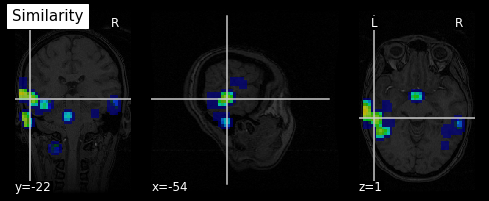

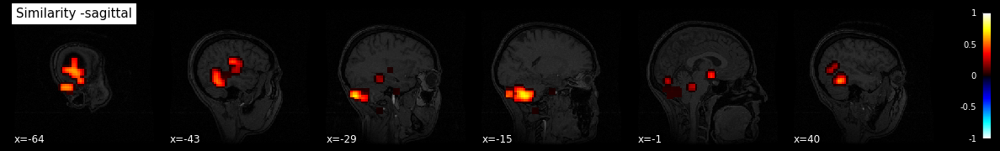

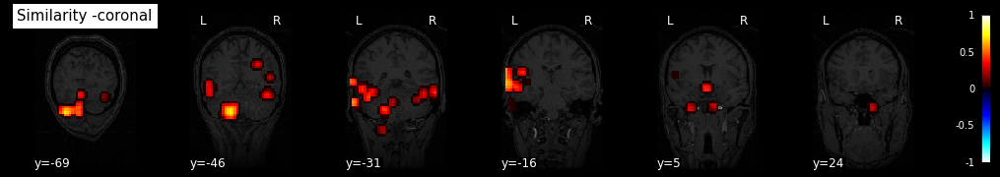

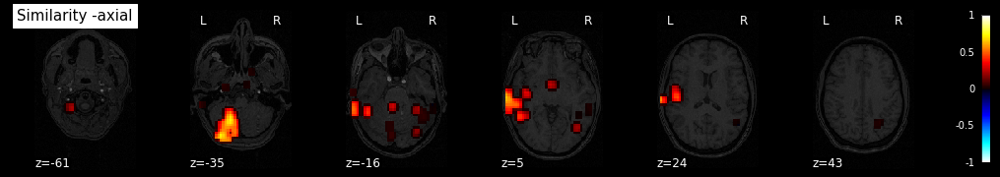

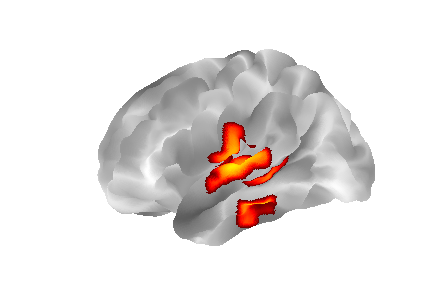

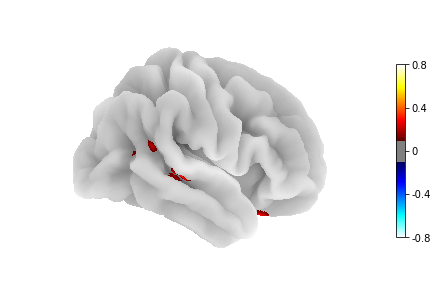

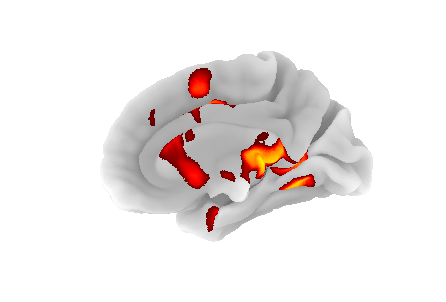

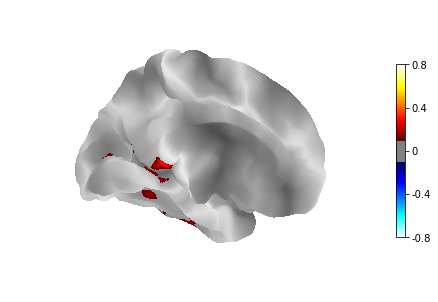

File(demo2_rsarlt_img.nii) saves successfully!


/Users/zitonglu/anaconda3/lib/python3.7/site-packages/nilearn/plotting/displays.py:1596: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  fraction * (x1 - x0), y1 - y0])


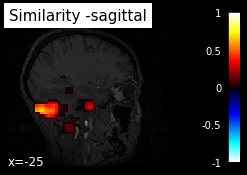

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


341
index1:216
339
index1:216
337
index1:214
337
index1:214
334
index1:209
327
index1:205
319
index1:199
311
index1:194
305
index1:192
300
index1:190
297
index1:185
300
index1:182
307
index1:183
315
index1:187
325
index1:196
333
index1:203
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
336
index1:213
331
index1:211
326
index1:207
324
index1:206
321
index1:201
313
index1:192
304
index1:185
295
index1:181
288
index1:180
282
index1:180
278
index1:179
281
index1:177
289
index1:175
300
index1:179
314
index1:189
326
index1:197
337
index1:208
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
338
index1:213
329
index1:209
320
index1:205
311
index1:199
306
index1:197
301
index1:191
293
index1:179
284
index1:168
275
index1:165
268
index1:165
262
i

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


index1:179
286
index1:184
281
index1:185
278
index1:177
284
index1:174
295
index1:176
307
index1:181
321
index1:192
332
index1:202
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
337
index1:212
327
index1:208
317
index1:202
310
index1:197
307
index1:193
301
index1:185
288
index1:169
278
index1:165
269
index1:164
263
index1:170
257
index1:173
254
index1:172
260
index1:168
273
index1:168
289
index1:173
308
index1:185
324
index1:196
337
index1:209
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
333
index1:208
318
index1:203
303
index1:195
291
index1:188
284
index1:183
275
index1:174
262
index1:155
253
index1:146
244
index1:146
238
index1:154
232
index1:159
230
index1:162
239
index1:166
252
index1:162
271
index1:165
295
index1:178
316
index1:190
334
index

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


280
index1:165
272
index1:160
266
index1:160
264
index1:170
263
index1:181
260
index1:169
269
index1:166
283
index1:168
298
index1:174
315
index1:186
329
index1:200
337
index1:209
340
index1:215
340
index1:214
341
index1:215
342
index1:216
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
328
index1:206
311
index1:198
294
index1:189
282
index1:183
278
index1:180
269
index1:163
254
index1:144
245
index1:142
238
index1:143
236
index1:155
235
index1:168
233
index1:166
242
index1:161
258
index1:160
277
index1:166
299
index1:179
318
index1:193
331
index1:203
337
index1:212
337
index1:210
339
index1:212
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
324
index1:202
302
index1:193
280
index1:182
262
index1:173
253
index1:169
241
index1:152
226
index1:130
218
index1:123


343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


343
343
343
343
343
337
index1:212
320
index1:201
297
index1:192
274
index1:182
258
index1:177
254
index1:177
245
index1:157
230
index1:133
223
index1:134
219
index1:137
223
index1:156
226
index1:173
224
index1:173
231
index1:159
247
index1:156
266
index1:159
288
index1:173
305
index1:184
318
index1:195
324
index1:200
326
index1:199
331
index1:203
336
index1:207
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
337
index1:212
317
index1:198
289
index1:186
261
index1:175
238
index1:166
229
index1:166
217
index1:145
202
index1:121
195
index1:115
191
index1:121
195
index1:142
200
index1:164
200
index1:168
209
index1:161
223
index1:151
243
index1:149
268
index1:162
289
index1:174
307
index1:188
316
index1:194
319
index1:193
326
index1:198
333
index1:203
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


343
334
index1:209
316
index1:200
294
index1:193
272
index1:188
259
index1:188
259
index1:192
250
index1:167
241
index1:152
240
index1:149
242
index1:152
251
index1:171
257
index1:190
254
index1:179
260
index1:168
272
index1:166
285
index1:168
299
index1:177
309
index1:187
316
index1:194
319
index1:194
322
index1:194
328
index1:199
334
index1:204
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
334
index1:209
312
index1:196
284
index1:187
256
index1:176
237
index1:172
233
index1:174
224
index1:151
212
index1:125
210
index1:127
213
index1:136
224
index1:160
232
index1:183
230
index1:181
234
index1:164
246
index1:156
261
index1:157
277
index1:166
289
index1:176
300
index1:186
306
index1:187
311
index1:187
320
index1:193
329
index1:199
338
index1:209
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
334


343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


288
index1:179
296
index1:179
309
index1:186
322
index1:193
335
index1:205
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
334
index1:209
308
index1:192
276
index1:183
244
index1:171
221
index1:166
213
index1:167
201
index1:144
189
index1:116
191
index1:116
198
index1:126
213
index1:151
225
index1:175
227
index1:175
228
index1:158
232
index1:148
239
index1:147
247
index1:154
253
index1:164
264
index1:178
270
index1:171
281
index1:171
298
index1:179
315
index1:187
332
index1:201
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
337
index1:212
312
index1:193
280
index1:183
248
index1:171
223
index1:164
210
index1:162
194
index1:142
176
index1:111
177
index1:111
182
index1:113
195
index1:134
207
index1:153
214
index1:158
219
index1:144
223
index1:141
227
index1:142
234
index1:152
242
index1:165
255
index1:181
261
inde

343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
337
index1:215
334
index1:212
334
index1:212
334
index1:209
334
index1:209
334
index1:206
337
index1:209
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
339
index1:216
337
index1:214
337
index1:214
337
index1:212
337
index1:212
337
index1:210
339
index1:212
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
342
index1:217
341
index1:217
340
index1:216
340
index1:216
340
index1:215
340
index1:215
340
index1:214
341
index1:215
342
index1:216
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
334
index1:209
313
index1:197
289
index1:194
265
index1:194
253
index1:203
253
index1:212
244
index1:191
238
index1:173
244
index1:165
253
index1:161
268
index1:175
277
index1:189
276
index1:177
278
index1:167
281
index1:168
284
index1:170
287
index1:176
289
index1:185
292
index1:190
293
index1:180
300
index1:180
312
index1:187
324
index1:194
336
index1:206
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
334
index1:209
310
index1:194
282
index1:190
254
index1:184
238
index1:188
235
index1:193
226
index1:173
217
index1:146
223
index1:145
233
index1:146
250
index1:166
261
index1:183
262
index1:178
260
index1:159
261
index1:158
262
index1:159
263
index1:165
263
index1:174
268
index1:184
270
index1:171
281
index1:171
298
index1:179
315
index1:187
332
index1:201
343
343
343
343
343
343
343
343
343
343
343
343


343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
336
index1:213
331
index1:211
326
index1:207
324
index1:206
324
index1:204
324
index1:200
326
index1:199
331
index1:203
336
index1:207
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
333
index1:211
326
index1:208
319
index1:203
316
index1:202
316
index1:200
316
index1:194
319
index1:193
326
index1:198
333
index1:203
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
332
index1:210
324
index1:207
316
index1:202
313
index1:202
313
index1:200
313
index1:194
316
index1:192
324
index1:197
332
index1:202
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
3

298
index1:196
292
index1:197
292
index1:197
292
index1:188
296
index1:182
307
index1:188
318
index1:192
331
index1:205
337
index1:212
337
index1:212
337
index1:210
339
index1:212
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
334
index1:209
316
index1:200
298
index1:197
280
index1:190
271
index1:192
271
index1:194
269
index1:180
273
index1:171
286
index1:176
299
index1:179
315
index1:194
324
index1:204
324
index1:200
326
index1:199
328
index1:200
330
index1:204
332
index1:208
334
index1:212
334
index1:209
334
index1:209
334
index1:206
337
index1:209
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
334
index1:209
313
index1:197
292
index1:197
271
index1:191
262
index1:197
262
index1:200
258
index1:187
259
index1:171
272
index1:174
285
index1:175
30

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
333
index1:210
325
index1:208
317
index1:201
315
index1:200
315
index1:195
315
index1:191
317
index1:187
325
index1:194
333
index1:201
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
339
index1:214
328
index1:207
317
index1:204
306
index1:196
302
index1:195
302
index1:191
302
index1:184
306
index1:180
317
index1:188
328
index1:196
339
index1:211
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
337
index1:212
324
index1:205
311
index1:201
298
index1:193
292
index1:192
292
index1:190
292
index1:180
298
index1:17

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
333
index1:211
326
index1:208
319
index1:203
316
index1:202
316
index1:200
316
index1:194
319
index1:193
326
index1:198
333
index1:203
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
337
index1:212
326
index1:207
315
index1:203
304
index1:197
298
index1:196
298
index1:196
298
index1:186
303
index1:184
313
index1:190
323
index1:195
334
index1:206
340
index1:215
340
index1:215
340
index1:214
341
index1:215
342
index1:216
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
334
index1:209
319
index1:203
304
index1:198
289
index1:191
280
index1:190
280
index1:192
279
index1:177
285
index1:174
297
index1:180
309


343
342
index1:217
341
index1:217
340
index1:216
337
index1:213
334
index1:212
331
index1:209
331
index1:208
332
index1:206
333
index1:207
334
index1:206
337
index1:209
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
342
index1:217
339
index1:215
336
index1:214
333
index1:211
332
index1:210
332
index1:208
332
index1:206
333
index1:205
336
index1:208
339
index1:211
342
index1:216
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
336
index1:213
331
index1:211
326
index1:207
324
index1:206
324
index1:204
324
index1:200
326
index1:199
331
index1:203
336
index1:207
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
34

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
339
index1:214
331
index1:210
323
index1:207
315
index1:202
311
index1:201
311
index1:200
311
index1:193
315
index1:192
323
index1:197
331
index1:202
339
index1:211
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
336
index1:213
331
index1:211
326
index1:207
324
index1:206
324
index1:204
324
index1:200
326
index1:199
331
index1:203
336
index1:207
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
339
index1:216
337
index1:214
335
index1:212
333
index1:210
331
index1:208
331
index1:206
333
index1:206
335
index1:208
337
index1:210
339
index1:212
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
34

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
333
index1:211
326
index1:208
319
index1:203
316
index1:202
316
index1:200
316
index1:194
319
index1:193
326
index1:198
333
index1:203
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
336
index1:213
331
index1:211
326
index1:207
324
index1:206
324
index1:204
324
index1:200
326
index1:199
331
index1:203
336
index1:207
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
342
index1:217
339
index1:215
336
index1:214
333
index1:211
332
index1:210
332
index1:208
332
index1:206
333
index1:205
336
index1:208
339
index1:211
342
index1:216
343
343
343
3

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
334
index1:212
328
index1:209
325
index1:206
325
index1:203
325
index1:200
325
index1:197
328
index1:197
334
index1:203
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
335
index1:213
330
index1:210
328
index1:208
328
index1:205
328
index1:203
328
index1:200
331
index1:201
336
index1:206
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
338
index1:215
335
index1:213
334
index1:212
334
index1:210
334
index1:209
334
index1:207
336
index1:208
339
index1:211
342
index1:216
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
34

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


343
343
343
343
343
343
343
343
343
343
340
index1:215
332
index1:210
324
index1:207
316
index1:202
313
index1:202
313
index1:200
313
index1:194
316
index1:192
324
index1:197
332
index1:202
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
333
index1:211
326
index1:208
319
index1:203
316
index1:202
316
index1:200
316
index1:194
319
index1:193
326
index1:198
333
index1:203
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
336
index1:213
331
index1:211
326
index1:207
324
index1:206
324
index1:204
324
index1:200
326
index1:199
331
index1:203
336
index1:207
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
3

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


343
343
339
index1:214
335
index1:214
331
index1:210
331
index1:210
331
index1:206
331
index1:206
331
index1:202
335
index1:206
339
index1:210
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
339
index1:214
333
index1:212
322
index1:203
311
index1:197
300
index1:189
289
index1:181
280
index1:171
279
index1:169
285
index1:168
296
index1:171
307
index1:179
318
index1:187
329
index1:197
338
index1:208
343
343
343
343
343
343
339
index1:214
335
index1:214
331
index1:210
331
index1:210
331
index1:206
331
index1:206
331
index1:202
335
index1:206
339
index1:210
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
339
index1:214
334
index1:213
325
index1:205
316
index1:200
305
index1:191
293
index1:183
283
index1:172
280
index1:169
283
index1:167
292
index1:170
301
index1:173
312
index1:181
324
index1:192
334
index1:203
341
index1:214
343
343
343
343
343
340
index1:

311
index1:201
311
index1:200
311
index1:193
315
index1:192
323
index1:197
331
index1:202
339
index1:211
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
336
index1:213
331
index1:211
326
index1:207
324
index1:206
324
index1:204
324
index1:200
326
index1:199
331
index1:203
336
index1:207
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
339
index1:216
337
index1:214
337
index1:214
337
index1:212
337
index1:212
337
index1:210
339
index1:212
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343

210
index1:134
208
index1:133
214
index1:132
224
index1:135
234
index1:140
249
index1:150
270
index1:162
290
index1:174
304
index1:185
315
index1:191
326
index1:197
337
index1:208
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
328
index1:206
312
index1:199
292
index1:186
272
index1:176
252
index1:166
232
index1:153
218
index1:140
219
index1:141
228
index1:143
241
index1:146
254
index1:151
271
index1:160
291
index1:171
308
index1:182
319
index1:193
326
index1:198
333
index1:203
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
339
index1:214
327
index1:206
312
index1:199
293
index1:186
274
index1:176
255
index1:166
237
index1:153
227
index1:143
231
index1:146
243
index1:150
259
index1:155
275
index1:162
294
index1:173
312
index1:183
326
index1:19

305
index1:198
305
index1:196
305
index1:188
309
index1:186
319
index1:192
329
index1:198
339
index1:210
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
329
index1:207
318
index1:204
307
index1:196
304
index1:196
304
index1:191
304
index1:185
307
index1:180
318
index1:188
325
index1:192
332
index1:208
331
index1:210
331
index1:210
331
index1:206
331
index1:206
331
index1:202
335
index1:206
339
index1:210
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
332
index1:210
324
index1:207
316
index1:202
313
index1:202
313
index1:200
313
index1:194
316
index1:192
324
index1:197
332
index1:202
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


index1:209
319
index1:203
303
index1:197
285
index1:188
262
index1:175
239
index1:167
216
index1:149
207
index1:144
201
index1:138
196
index1:137
193
index1:134
207
index1:149
230
index1:161
253
index1:175
271
index1:179
292
index1:185
313
index1:191
334
index1:209
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
332
index1:207
314
index1:200
294
index1:193
272
index1:184
245
index1:170
218
index1:161
191
index1:138
181
index1:130
178
index1:123
177
index1:122
178
index1:123
196
index1:144
223
index1:162
250
index1:180
271
index1:188
292
index1:191
313
index1:194
334
index1:209
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
342
index1:217
329
index1:205
308
index1:196
284
index1:187
258
index1:177
230
index1:165
202
index1:152
175
index1:128
164
index1:117
164
index1:11

297
index1:175
285
index1:168
273
index1:183
253
index1:185
241
index1:192
241
index1:197
241
index1:185
253
index1:171
279
index1:178
305
index1:185
331
index1:206
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
337
index1:212
324
index1:205
311
index1:201
298
index1:193
292
index1:192
292
index1:190
292
index1:180
298
index1:177
299
index1:173
290
index1:171
281
index1:182
265
index1:184
253
index1:186
253
index1:190
253
index1:174
265
index1:168
287
index1:176
309
index1:184
331
index1:202
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
339
index1:214
328
index1:207
317
index1:204
306
index1:196
302
index1:195
302
index1:191
302
index1:184
306
index1:180
309
index1:180
304
index1:180
299
index1:191
287
index1:191
279
index1:192
279
index1:193
279
index1:181
287
index1:17

343
343
343
343
343
343
343
343
343
343
342
index1:217
331
index1:207
311
index1:197
289
index1:190
265
index1:179
236
index1:164
208
index1:154
181
index1:135
173
index1:131
172
index1:127
173
index1:131
176
index1:133
196
index1:153
224
index1:168
252
index1:186
271
index1:188
292
index1:191
313
index1:194
334
index1:209
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
327
index1:204
303
index1:192
276
index1:184
247
index1:173
213
index1:157
180
index1:145
149
index1:121
140
index1:113
143
index1:108
149
index1:112
157
index1:118
182
index1:145
215
index1:167
248
index1:190
271
index1:197
292
index1:197
313
index1:197
334
index1:209
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
339
index1:214
322
index1:201
294
index1:186
263
index1:177
230
index1:165
195

index1:184
331
index1:203
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
331
index1:209
322
index1:206
313
index1:199
310
index1:198
310
index1:194
310
index1:188
313
index1:185
310
index1:180
300
index1:180
290
index1:187
274
index1:185
262
index1:184
262
index1:188
262
index1:170
274
index1:169
293
index1:177
312
index1:185
331
index1:200
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
335
index1:212
329
index1:210
323
index1:205
321
index1:204
321
index1:201
321
index1:197
323
index1:195
321
index1:192
313
index1:191
305
index1:195
293
index1:192
285
index1:191
285
index1:192
285
index1:179
293
index1:178
307
index1:185
321
index1:192
335
index1:205
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
336
index1:211
326
index1:208
314
index1:200
297
index1:188
282
index1:183
269
index1:177
262
index1:169
261
index1:166
263
index1:167
267
index1:164
281
index1:174
296
index1:181
309
index1:189
316
index1:192
324
index1:197
332
index1:202
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
327
index1:205
311
index1:199
293
index1:189
270
index1:175
249
index1:168
231
index1:159
223
index1:151
223
index1:149
226
index1:152
231
index1:150
248
index1:162
269
index1:173
287
index1:182
298
index1:184
311
index1:190
324
index1:196
337
index1:209
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
335
index1:210
316
index1:199
294
index1:191
270
in

310
index1:188
313
index1:185
316
index1:186
314
index1:188
312
index1:197
304
index1:197
298
index1:196
298
index1:196
298
index1:186
304
index1:185
315
index1:191
326
index1:197
337
index1:208
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
329
index1:207
318
index1:204
307
index1:196
304
index1:196
304
index1:191
304
index1:185
307
index1:180
309
index1:179
305
index1:181
301
index1:192
289
index1:191
280
index1:190
280
index1:192
280
index1:178
289
index1:177
304
index1:184
319
index1:191
334
index1:204
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
329
index1:207
318
index1:204
307
index1:196
304
index1:196
304
index1:191
304
index1:185
307
index1:180
309
index1:179
302
index1:178
295
index1:191
280
index1:190
271
index1:192
271
index1:19

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
337
index1:215
331
index1:209
328
index1:209
325
index1:203
325
index1:203
325
index1:197
328
index1:200
331
index1:200
337
index1:209
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
333
index1:211
324
index1:206
311
index1:197
301
index1:193
293
index1:187
290
index1:182
290
index1:176
294
index1:176
300
index1:176
313
index

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
339
index1:216
337
index1:214
337
index1:214
337
index1:212
337
index1:212
337
index1:210
339
index1:212
337
index1:210
331
index1:210
323
index1:207
312
index1:199
305
index1:198
302
index1:194
302
index1:187
306
index1:183
312
index1:186
315
index1:185
321
index1:195
323
index1:201
324
index1:206
324
index1:204
324
index1:200
326
index1:199
331
index1:203
336
index1:207
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
337
index1:212
326
index1:207
315
index1:203
304
index1:197
298
index1:196
298
index1:196
298
index1:186
304
index1:185
311
index1:187
314
index1:189
317
index1:197
315
index1:202
311
index1:201
311
index1:200
311
index1:193
315
index1:192
323
index1:197
331
index1:202
339
index1:211
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
34

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
339
index1:214
335
index1:214
328
index1:207
325
index1:207
322
index1:200
322
index1:200
322
index1:193
326
index1:197
330
index1:198
337
index1:209
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
339
index1:214
330
index1:209
319
index1:203
305
index1:194
295
index1:190
288
index1:184
285
index1:176
287
index1:171
294
index1:172
303


343
343
343
343
343
343
343
340
index1:215
333
index1:211
326
index1:208
319
index1:203
316
index1:202
316
index1:200
316
index1:194
319
index1:193
326
index1:198
330
index1:200
330
index1:205
324
index1:206
312
index1:198
304
index1:195
299
index1:189
297
index1:182
299
index1:178
305
index1:179
312
index1:181
323
index1:194
330
index1:202
335
index1:209
337
index1:211
338
index1:212
339
index1:212
341
index1:215
342
index1:216
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
337
index1:215
334
index1:212
334
index1:212
334
index1:209
334
index1:209
334
index1:206
337
index1:209
334
index1:206
326
index1:207
315
index1:203
302
index1:195
294
index1:194
292
index1:192
292
index1:182
298
index1:179
308
index1:184
316
index1:186
326
index1:198
331
index1:207
332
index1:210
332
index1:208
332
index1:206
333
index1:205
336
index1:208
339
index1:211
342
index1:216
343
343
343
343
343
343
343
343
34

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


262
index1:197
262
index1:200
248
index1:177
235
index1:157
234
index1:157
227
index1:149
220
index1:159
199
index1:157
173
index1:138
179
index1:143
193
index1:139
209
index1:138
229
index1:140
249
index1:141
271
index1:151
294
index1:181
302
index1:184
310
index1:188
316
index1:192
324
index1:197
332
index1:202
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
334
index1:209
313
index1:197
292
index1:197
271
index1:194
262
index1:203
262
index1:209
253
index1:191
246
index1:172
251
index1:170
250
index1:160
249
index1:168
234
index1:167
214
index1:154
215
index1:154
223
index1:151
233
index1:149
247
index1:150
261
index1:150
277
index1:159
294
index1:181
302
index1:184
310
index1:188
316
index1:192
324
index1:197
332
index1:202
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
334
index1:209
313
index

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
315
index1:190
270
index1:173
221
index1:160
172
index1:140
124
index1:117
78
index1:95
34
index1:46
35
index1:34
70
index1:47
117
index1:67
164
index1:86
210
index1:109
256
index1:132
300
index1:167
327
index1:196
337
index1:210
339
index1:212
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
311
index1:186
265
index1:172
218
index1:161
171
index1:140
125
index1:119
81
index1:99
39
index1:48
46
index1:42
83
index1:61
129
index1:84
175
index1:102
220
index1:124
263
index1:144
304
index1:177
328
index1:199
337
index1:212
338
index1:212
339
index1:213
340
index1:214
341
index1:215
342
index1:216
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
307
index1:182
262
index1:173
217
index1:1

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
327
index1:202
299
index1:190
253
index1:164
204
index1:150
157
index1:131
111
index1:108
70
index1:75
72
index1:77
97
index1:63
143
index1:74
192
index1:97
239
index1:120
285
index1:146
326
index1:191
340
index1:212
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
321
index1:196
286
index1:183
238
index1:161
189
index1:147
143
index1:127
99
index1:105
58
index1:65
63
index1:65
94
index1:59
142
index1:75
191
index1:98
237
index1:121
281
index1:144
322
index1:187
339
index1:210
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
318
index1:193
277
index1:177
230
index1:164
182
index1:146
138
index1:128
96
index1:107
57
index1:66
62
index1:57
99
i

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
334
index1:212
328
index1:209
322
index1:204
319
index1:202
317
index1:198
315
index1:192
316
index1:190
322
index1:195
328
index1:198
334
index1:206
337
index1:210
339
index1:212
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
342
index1:217
339
index1:215
336
index1:214
333
index1:211
332
index1:210
331
index1:207
330
index1:205
330
index1:203
333
index1:206
336
index1:208
339
index1:213
340
index1:214
341
index1:215
342
index1:216
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
342
index1:217
341
index1:217
340
index1:216
340
index1:216
340
index1:215
340
index1:215
340
index1:214
341
index1:215
342
index1:216
343
343
343
3

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
330
index1:205
306
index1:194
267
index1:172
222
index1:157
179
index1:144
137
index1:125
103
index1:101
109
index1:106
133
index1:95
172
index1:99
217
index1:121
260
index1:141
302
index1:167
336
index1:206
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
325
index1:200
295
index1:188
254
index1:169
209
index1:155
167
index1:141
127
index1:123
93
index1:92
101
index1:94
131
index1:89
172
index1:96
217
index1:119
259
index1:140
299
index1:164
333
index1:202
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
323
index1:198
288
index1:183
248
index1:172
205
index1:156
166
index1:144
129
index1:128
97
index1:96
104
index1:89
13

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
338
index1:213
329
index1:209
320
index1:205
311
index1:199
305
index1:196
300
index1:191
295
index1:181
295
index1:177
302
index1:182
311
index1:186
320
index1:193
326
index1:199
331
index1:203
336
index1:207
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
336
index1:213
331
index1:211
326
index1:207
323
index1:205
320
index1:201
317
index1:196
316
index1:192
320
index1:195
325
index1:197
330
index1:202
333
index1:205
336
index1:208
339
index1:211
342
index1:216
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
339
index1:216
337
index1:214
336
index

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
333
index1:208
313
index1:198
281
index1:180
243
index1:165
207
index1:154
172
index1:140
144
index1:123
150
index1:130
170
index1:120
202
index1:124
240
index1:141
276
index1:156
311
index1:176
339
index1:211
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
329
index1:204
304
index1:193
270
index1:177
232
index1:163
197
index1:151
164
index1:137
136
index1:113
144
index1:117
169
index1:111
203
index1:118
240
index1:136
274
index1:153
306
index1:171
333
index1:205
338
index1:214
337
index1:213
337
index1:212
338
index1:212
339
index1:213
340
index1:214
341
index1:215
342
index1:216
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
328
index1:203
299
index1:189
26

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
342
index1:217
341
index1:217
340
index1:216
340
index1:216
340
index1:215
340
index1:215
340
index1:214
341
index1:215
342
index1:216
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
3

248
index1:176
248
index1:177
252
index1:163
266
index1:163
287
index1:172
308
index1:181
329
index1:197
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
342
index1:217
335
index1:211
318
index1:200
293
index1:187
268
index1:180
243
index1:171
226
index1:169
227
index1:172
234
index1:160
251
index1:159
276
index1:168
301
index1:177
326
index1:194
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
339
index1:214
328
index1:207
307
index1:193
278
index1:178
250
index1:170
222
index1:159
203
index1:154
206
index1:159
217
index1:150
238
index1:150
267
index1:162
295
index1:172
323
index1:191
342
index1:216
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
34

343
343
342
index1:217
339
index1:215
321
index1:199
290
index1:183
259
index1:180
228
index1:171
201
index1:165
177
index1:157
155
index1:135
150
index1:116
166
index1:122
197
index1:137
228
index1:143
255
index1:155
280
index1:166
305
index1:179
328
index1:196
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
342
index1:217
326
index1:202
300
index1:191
274
index1:186
247
index1:176
223
index1:170
202
index1:162
182
index1:138
179
index1:126
193
index1:133
219
index1:145
246
index1:152
270
index1:165
291
index1:174
312
index1:185
331
index1:200
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
332
index1:207
312
index1:198
292
index1:194
271
index1:185
252
index1:179
235
index1:172
218
index1:152
214
index1:141
225
index1:147
245
index1:156
266
ind

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
342
index1:217
341
index1:217
340
index1:216
340
index1:216
340
index1:215
340
index1:215
340
index1:214
341
index1:215
342
index1:216
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
342
index1:217
338
index1:214
334
index1:213
330
index1:209
329
index1:208
329
index1:205
329
index1:203
330
index1:201
334
index1:205
338
index1:209
342
index1:216
343


index1:212
325
index1:203
307
index1:191
282
index1:181
250
index1:164
217
index1:153
180
index1:138
144
index1:120
120
index1:102
111
index1:88
119
index1:83
141
index1:83
163
index1:78
189
index1:90
214
index1:109
239
index1:132
266
index1:160
283
index1:175
293
index1:178
307
index1:185
321
index1:192
335
index1:205
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
337
index1:215
334
index1:212
328
index1:206
315
index1:196
295
index1:186
270
index1:172
244
index1:161
214
index1:148
180
index1:130
153
index1:115
138
index1:101
138
index1:97
147
index1:94
157
index1:90
171
index1:93
189
index1:107
210
index1:128
238
index1:155
258
index1:164
274
index1:169
293
index1:177
312
index1:185
331
index1:200
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
337
index1:215
334
index1:212
331
in

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


128
index1:101
123
index1:94
131
index1:90
139
index1:82
152
index1:85
170
index1:99
195
index1:124
227
index1:154
249
index1:167
265
index1:168
287
index1:176
309
index1:184
331
index1:202
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
333
index1:211
326
index1:208
319
index1:203
313
index1:199
302
index1:189
291
index1:180
277
index1:165
261
index1:157
240
index1:147
210
index1:132
180
index1:121
158
index1:114
141
index1:104
135
index1:98
130
index1:86
130
index1:81
139
index1:91
159
index1:113
192
index1:140
220
index1:155
243
index1:159
271
index1:168
299
index1:177
327
index1:198
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
336
index1:213
331
index1:211
326
index1:207
324
index1:206
319
index1:199
314
index1:195
306
index1:184
295
index1:177
279
index1:168
251
index1:153
216
index1

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


115
index1:73
115
index1:68
123
index1:75
146
index1:99
182
index1:127
211
index1:144
234
index1:147
265
index1:159
296
index1:171
327
index1:198
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
339
index1:214
331
index1:210
323
index1:207
315
index1:202
310
index1:200
302
index1:192
293
index1:183
286
index1:173
276
index1:162
260
index1:151
232
index1:136
198
index1:122
169
index1:111
147
index1:105
129
index1:92
110
index1:74
97
index1:62
96
index1:65
115
index1:90
152
index1:121
183
index1:134
212
index1:138
249
index1:151
286
index1:164
323
index1:194
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
341
index1:216
336
index1:213
331
index1:211
326
index1:207
323
index1:205
320
index1:201
316
index1:195
313
index1:190
307
index1:184
295
index1:177
271
index1:163
237
index1:148
204
index1:137
175
index1:125
146
index1:1

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


343
343
343
343
340
index1:215
333
index1:211
326
index1:208
319
index1:203
314
index1:200
306
index1:192
296
index1:183
290
index1:176
280
index1:166
265
index1:160
240
index1:146
207
index1:129
178
index1:119
155
index1:112
130
index1:91
106
index1:72
87
index1:59
79
index1:51
94
index1:69
131
index1:96
164
index1:105
198
index1:113
239
index1:132
280
index1:152
320
index1:187
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
337
index1:215
334
index1:212
332
index1:210
327
index1:204
319
index1:199
311
index1:191
302
index1:185
290
index1:180
267
index1:164
237
index1:147
210
index1:134
189
index1:125
162
index1:103
136
index1:91
113
index1:74
105
index1:70
115
index1:82
147
index1:110
176
index1:109
211
index1:122
249
index1:139
287
index1:160
321
index1:186
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
34

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


index1:196
285
index1:190
264
index1:176
239
index1:157
220
index1:139
211
index1:133
198
index1:120
183
index1:112
168
index1:101
165
index1:102
176
index1:114
201
index1:134
223
index1:134
249
index1:144
277
index1:157
305
index1:174
329
index1:196
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
337
index1:212
326
index1:207
315
index1:203
304
index1:197
297
index1:195
283
index1:182
265
index1:167
253
index1:157
247
index1:153
238
index1:145
228
index1:145
214
index1:134
211
index1:133
220
index1:142
238
index1:154
255
index1:155
275
index1:163
296
index1:173
317
index1:187
334
index1:204
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
339
index1:214
331
index1:210
323
index1:207
315
index1:202
311
index1:201
301
index1:190
288
index1:180
279
index1:172
274
index1:168
267
index1

343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343


309
index1:187
320
index1:193
331
index1:202
339
index1:211
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
333
index1:211
326
index1:208
319
index1:203
316
index1:202
309
index1:193
301
index1:186
296
index1:180
296
index1:180
295
index1:178
294
index1:181
289
index1:175
291
index1:177
297
index1:181
305
index1:186
312
index1:189
320
index1:194
328
index1:199
336
index1:207
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
340
index1:215
337
index1:215
334
index1:212
334
index1:212
331
index1:206
328
index1:206
325
index1:200
326
index1:201
324
index1:198
322
index1:202
317
index1:195
318
index1:197
321
index1:198
324
index1:200
326
index1:199
331
index1:203
336
index1:207
341
index1:214
343
343
343
343
343
343
343
343
343
343
343
343
343
343
343
34

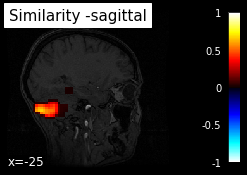

In [9]:
# load the filename of anatomical image as the background for plotting
ant_filename = haxby_dataset.anat[0]

# get the affine info
affine = get_affine(mask_filename)

# save the RSA result as a .nii file
# and visualize the result automatically
# p < 0.05, FDR-correct
rsarltfilename = "demo2_rsarlt_img.nii"
img = corr_save_nii(corrs, filename=rsarltfilename, affine=affine, corr_mask=mask_filename, size=[40, 64, 64], p=0.001, plotrlt=True, img_background=ant_filename)

# Users can plot the RSA results independently by functions below
from neurora.rsa_plot import plot_brainrsa_regions
from neurora.rsa_plot import plot_brainrsa_montage
from neurora.rsa_plot import plot_brainrsa_glass
from neurora.rsa_plot import plot_brainrsa_surface

# here use a [5, 5, 5] cube to remove the significant area smaller than it
# before filtering
plot_brainrsa_montage(rsarltfilename, slice=[[-25], 0, 0], background=ant_filename)
# after filtering
plot_brainrsa_montage(rsarltfilename, threshold=125, slice=[[-25], 0, 0], background=ant_filename)